The goal of this notebook is to look at the influences of the parameters selected in order to make the PSD

BAsically, the method applied is to take the Welsh method with a given lenght to the time slices that are used. So, the time series data is divided in several bins. For each of them, the power is calculated. The total power is then taken as the sum of the different bins. The segments can eventually overlap. 

In pycbc, the psd fr the data is made by taking data.psd(\emph{times slice}). We are going to look at the influence of the time slice on the psd obtained. In a first time, we only look at the result for the PSD. Maybe later, we can analyze the influence onto the SNR that we look for.

The total duration of the segment used here in the data is 32s. SO we try first time slices of 0.032, 0.32, 1, 2, 3, 3.2, 4, 5, 6,7, 10, 20, 30, 32, 40, 320 for the time. 

In [3]:
import sys
!{sys.executable} -m pip install --user pycbc lalsuite ligo-common --no-cache-dir

DEPRECATION: Python 2.7 will reach the end of its life on January 1st, 2020. Please upgrade your Python as Python 2.7 won't be maintained after that date. A future version of pip will drop support for Python 2.7. More details about Python 2 support in pip, can be found at https://pip.pypa.io/en/latest/development/release-process/#python-2-support
You should consider upgrading via the 'pip install --upgrade pip' command.


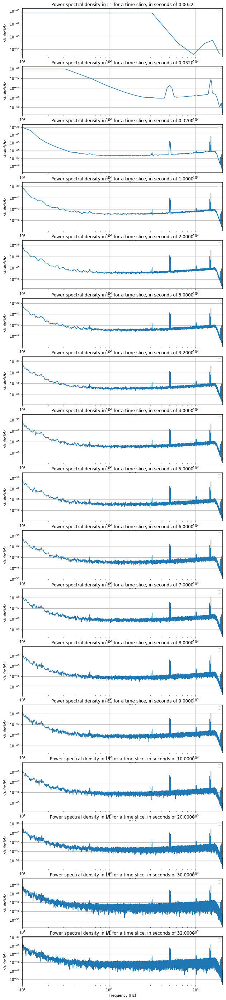

In [4]:
from pycbc.catalog import Merger
import matplotlib.pyplot as plt

m=Merger("GW170814")

data={}
detectors=['L1', 'H1', 'V1']
time_slices=[0.0032,0.032, 0.32, 1, 2, 3,3.2, 4, 5, 6,7,8,9, 10, 20, 30, 32]

for det in detectors:
    data[det]=m.strain(det)
f=plt.figure(figsize=(10,50))
#f.subplots_adjust(bottom=18, top=20, wspace= 0.4, hspace=0.4)
ax=f.subplots(nrows=len(time_slices))
    

for i in range(len(time_slices)):
    psd=data["L1"].psd(time_slices[i])
    ax[i].loglog(psd.sample_frequencies, psd)
    ax[i].set_xlabel("Frequency (Hz)")
    ax[i].set_ylabel("$strain^2/Hz$")
    ax[i].set_xlim(10,2048)
    ax[i].legend(loc="best")
    ax[i].set_title("Power spectral density in L1 for a time slice, in seconds of %.4f" %time_slices[i])
    ax[i].grid()


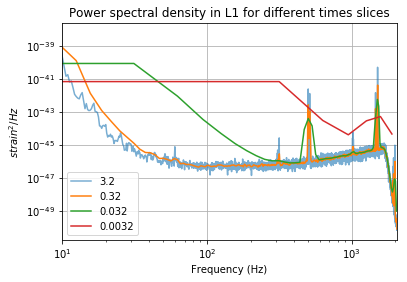

In [5]:
times=[3.2,0.32,0.032, 0.0032]
alpha=[0.6,1,2,5]
for i in range(len(times)):
    psd=data["L1"].psd(times[i])
    plt.loglog(psd.sample_frequencies, psd, alpha=alpha[i],label=times[i])
plt.xlabel("Frequency (Hz)")
plt.ylabel("$strain^2/Hz$")
plt.xlim(10,2048)
plt.legend(loc="best")
plt.title("Power spectral density in L1 for different times slices")
plt.grid()


The 32 time slice corresponds to the complete sequence. The result found is thus the Fourier transform of the total data. When going to smaller time slices, one finds resuts corresponding more to the time slices that are taken. When taking to small time slices, such as 0.32s or 0.0032 sec, one looses a lot of information about the data. Indeed, for these two specific cases, the only some major peaks are found with a rough idea of the shape but there a big loss of information. The case of 0.32s is more ambigous. In order to see it bettere, it is compared with a time slice of a tenth of the the total time for the data. 

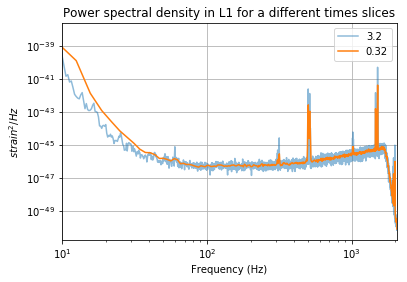

In [4]:
time=[3.2, 0.32]
alpha=[0.5,1]
for i in range(len(time)):
    psd=data["L1"].psd(time[i])
    plt.loglog(psd.sample_frequencies, psd, alpha=alpha[i],label=time[i])
plt.xlabel("Frequency (Hz)")
plt.ylabel("$strain^2/Hz$")
plt.xlim(10,2048)
plt.legend(loc="best")
plt.title("Power spectral density in L1 for a different times slices")
plt.grid()


For the 0.32 case, the major peaks are present eventhough these are less important and less well defined. For example, the peak at 1000Hz is less high and the one before. In addition, for the lowest frequencies, between 10 and 100Hz, the 0.32 case is higher then the 3.2 case and has a monotonous decrease, without the presence of the peak. This is not that good because, one denotes, for example, the absence of a well defined peak at 60Hz, which is due to the alternative current present. In a first approach, it can seem not that important but this peak is used for calibration and thus its presence is important.

The method uses time slices of the chosen lenght and take the Fourier transform of each segment of this lenght. Therefore, if the time sample is to small, the Fourier transform has no significance. Indeed, the goeal of a FFT is to look at the frequency content of a time series, by summing for all the considered times the frequency. So, if the time slice is too small, the sum cannot enable to retrieve something that is significant for the complete series. On the other hand, the performance of the algorithm on smaller parts of the data instead of the full data set enables to have something that can be computed faster than the full set of frequencies. 


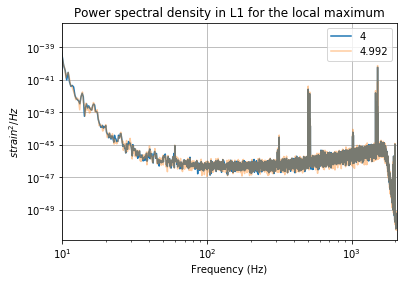

In [11]:
#Plot of the PSD found for this specific peak, compared avec 4s 
time=times[index]
psd=data["L1"].psd(time)
psd4=data["L1"].psd(4)
plt.loglog(psd4.sample_frequencies, psd4, label=4, alpha=1)
plt.loglog(psd.sample_frequencies, psd, label=time, alpha=0.4)
plt.xlabel("Frequency (Hz)")
plt.ylabel("$strain^2/Hz$")
plt.xlim(10,2048)
plt.legend(loc="best")
plt.title("Power spectral density in L1 for the local maximum")
plt.grid()


The PSD is used in order to have a model for the noise. Therefore, the precision with which the calculation is done can lead to a different result for the SNR found by matched filtering. As a first step, we look at the different SNR found in the L1 detector for different values of the time slice taken for the PSD

20
10
9
8
7
6
5
4
3
2
1


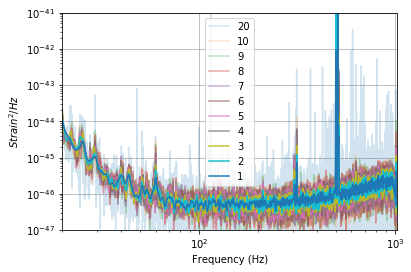

In [12]:
#need to precondition the data and to interpolate the power spectrum
from pycbc.filter import resample_to_delta_t, highpass
from pycbc.catalog import Merger
from pycbc.psd import interpolate, inverse_spectrum_truncation
m=Merger("GW170814")
time_slices=[20, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1]
alphas=[0.2, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1, 1]
psd=[]
ts=m.strain("L1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2,2)
for i in range(len(time_slices)):
    print(time_slices[i])
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)
    plt.plot(psd[i].sample_frequencies, psd[i], label=time_slices[i], alpha=alphas[i])
plt.yscale("log")
plt.xscale("log")
plt.ylim(1e-47, 1e-41)
plt.xlim(20, 1024)
plt.ylabel('$Strain^2 / Hz$')
plt.xlabel('Frequency (Hz)')
plt.grid()
plt.legend(loc="best")

Text(0,0.5,'SNR')

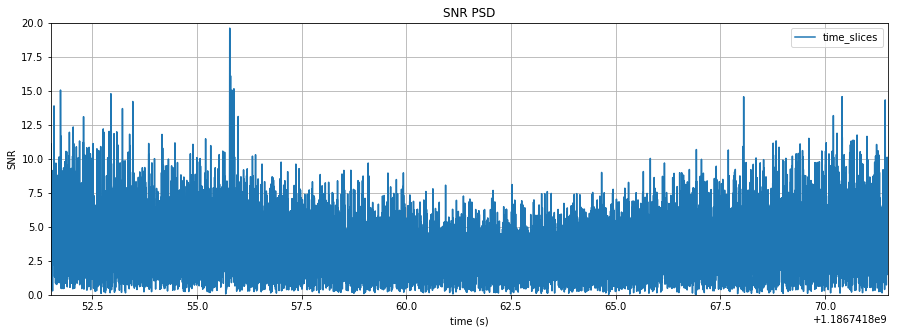

In [13]:
from pycbc.waveform import get_td_waveform, get_fd_waveform
from pycbc.filter import matched_filter
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
hp.resize(len(psd[0]))
snr=matched_filter(hp, data, psd=psd[0], low_frequency_cutoff=20.)
plt.figure(figsize=[15,5])
plt.plot(snr.sample_times, abs(snr), label="time_slices")
plt.legend(loc="best")
plt.title("SNR for a PSD time slice of 20 seconds")
plt.grid()
plt.xlim(m.time-10, m.time+10)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR")

Text(0,0.5,'SNR')

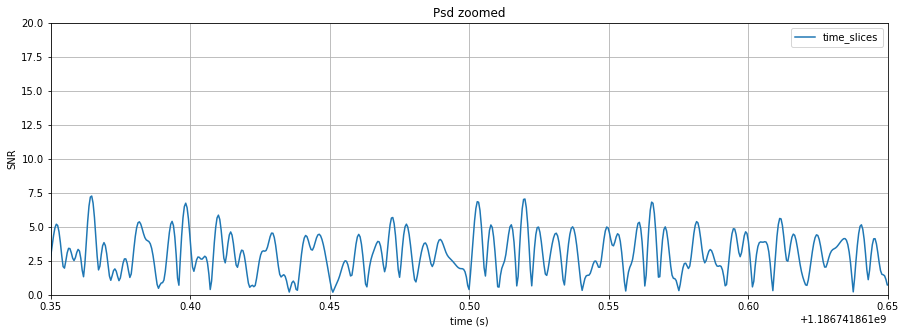

In [14]:
plt.figure(figsize=[15,5])
plt.plot(snr.sample_times, abs(snr), label="time_slices")
plt.legend(loc="best")
plt.title("Psd zoomed")
plt.grid()
plt.xlim(m.time-0.15, m.time+0.15)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR")

Text(0,0.5,'SNR')

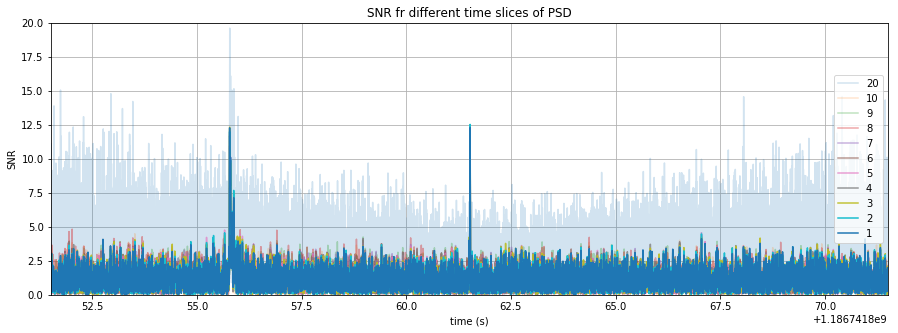

In [15]:
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.grid()
plt.xlim(m.time-10, m.time+10)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0,0.5,'SNR')

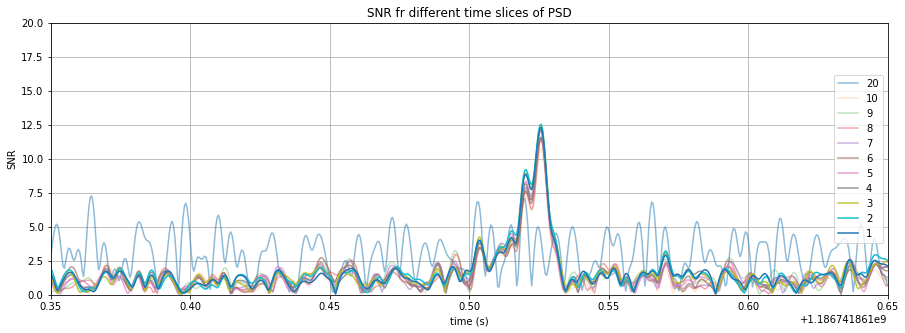

In [16]:
#zoomed version of the plot above
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
alphas=[0.5, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1, 1]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR fr different time slices of PSD")
plt.grid()
plt.xlim(m.time-0.15, m.time+0.15)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

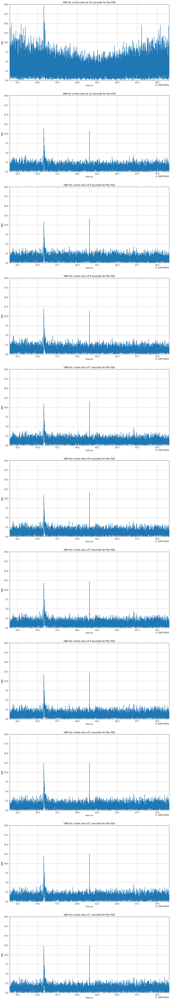

In [17]:
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
f=plt.figure(figsize=[15,95])
ax=f.subplots(nrows=len(time_slices))
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    ax[j].plot(snr.sample_times, abs(snr), label=time_slices[j])
    snrs.append(snr)
    ax[j].set_title("SNR for a time slice of %i seconds for the PSD" %time_slices[j])
    ax[j].grid()
    ax[j].set_xlim(m.time-10, m.time+10)
    ax[j].set_ylim(0,20)
    ax[j].set_xlabel("time (s)")
    ax[j].set_ylabel("SNR") 

Text(0,0.5,'SNR')

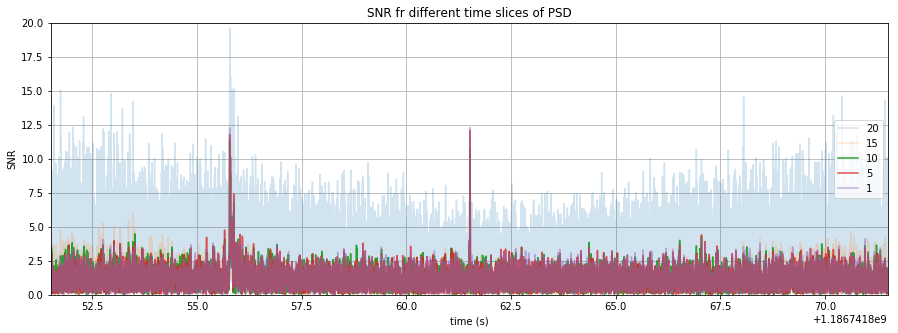

In [18]:
time_slices=[ 20, 15, 10, 5, 1]
alphas=[0.2,0.2, 1, 0.8, 0.5, 0.5]
psd=[]
ts=m.strain("L1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2,2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR fr different time slices of PSD")
plt.grid()
plt.xlim(m.time-10, m.time+10)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

By looking at the plot above, we see a big difference in the SNR for the noise between 15s time slice and 20s time slice. The first hypothesis is that there is a difference when crossing a value that is equal to the half of the total time sequence

Text(0,0.5,'SNR')

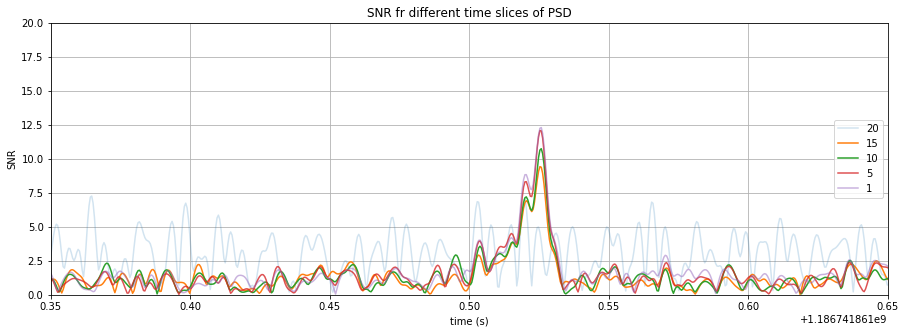

In [19]:
#zoom of the plot above around the tile of the event
time_slices=[ 20, 15, 10, 5, 1]
alphas=[0.2,1, 1, 0.8, 0.5, 0.5]
psd=[]
ts=m.strain("L1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2,2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR fr different time slices of PSD")
plt.grid()
plt.xlim(m.time-0.15, m.time+0.15)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0,0.5,'SNR')

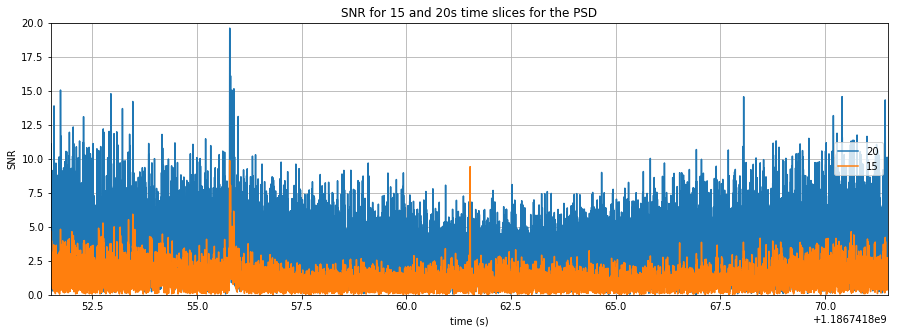

In [20]:
#comaprison between 15 s and 20s time slice:
time_slices=[ 20, 15]
alphas=[1, 1]
psd=[]
ts=m.strain("L1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2,2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR for 15 and 20s time slices for the PSD")
plt.grid()
plt.xlim(m.time-10, m.time+10)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0,0.5,'SNR')

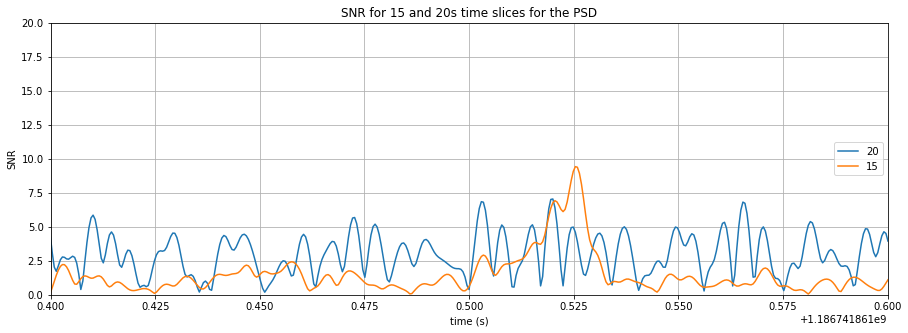

In [21]:
#zoomed version
#comaprison between 15 s and 20s time slice:
time_slices=[ 20, 15]
alphas=[1, 1]
psd=[]
ts=m.strain("L1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2,2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR for 15 and 20s time slices for the PSD")
plt.grid()
plt.xlim(m.time-0.1, m.time+0.1)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0,0.5,'SNR')

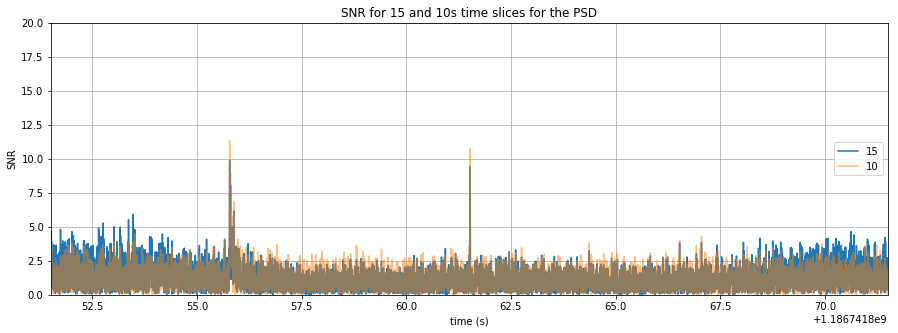

In [22]:
#comparison with 10s
time_slices=[15, 10]
alphas=[1, 0.5]
psd=[]
ts=m.strain("L1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2,2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR for 15 and 10s time slices for the PSD")
plt.grid()
plt.xlim(m.time-10, m.time+10)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0,0.5,'SNR')

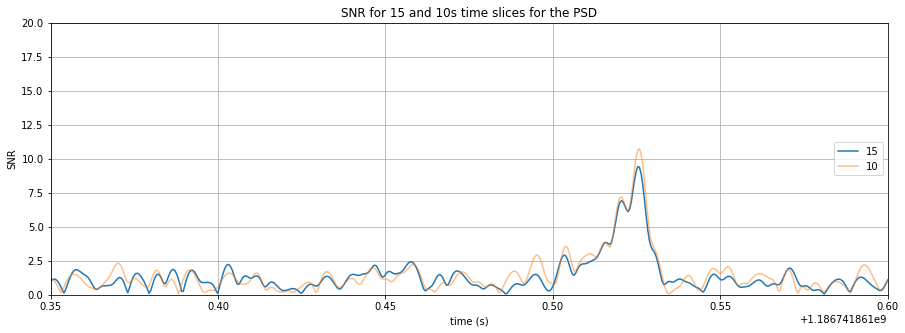

In [23]:
#zoom
time_slices=[15, 10]
alphas=[1, 0.5]
psd=[]
ts=m.strain("L1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2,2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR for 15 and 10s time slices for the PSD")
plt.grid()
plt.xlim(m.time-0.15, m.time+0.1)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

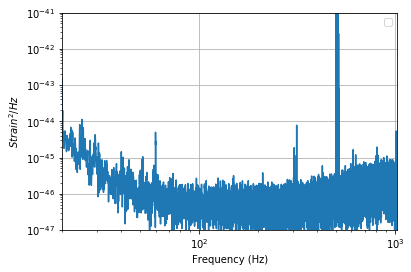

In [24]:
#test for the psd for half the total time
m=Merger("GW170814")
ts=m.strain('L1').highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2,2)
psd=data.psd(16)
psd=interpolate(psd, data.delta_f)
psd=inverse_spectrum_truncation(psd, 17*data.sample_rate, low_frequency_cutoff=20.)

plt.plot(psd.sample_frequencies, psd)
plt.yscale("log")
plt.xscale("log")
plt.ylim(1e-47, 1e-41)
plt.xlim(20, 1024)
plt.ylabel('$Strain^2 / Hz$')
plt.xlabel('Frequency (Hz)')
plt.grid()
plt.legend(loc="best")

Text(0,0.5,'SNR')

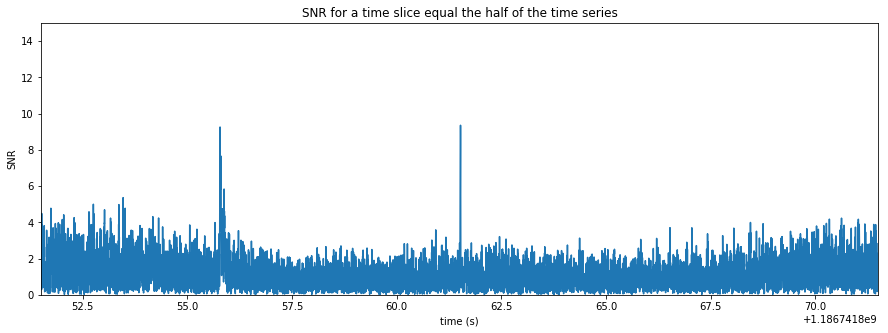

In [25]:
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0 
cmass *= (1 + m.median1d("redshift"))
hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2= cmass, f_lower=20.0, delta_f=data.delta_f)
hp.resize(len(psd))
snr=matched_filter(hp, data, psd=psd, low_frequency_cutoff=20.)
plt.figure(figsize=[15,5])
plt.plot(snr.sample_times, abs(snr))
plt.title("SNR for a time slice equal the half of the time series")
plt.xlim(m.time-10, m.time+10)
plt.ylim(0,15)
plt.xlabel("time (s)")
plt.ylabel("SNR")

Text(0,0.5,'SNR')

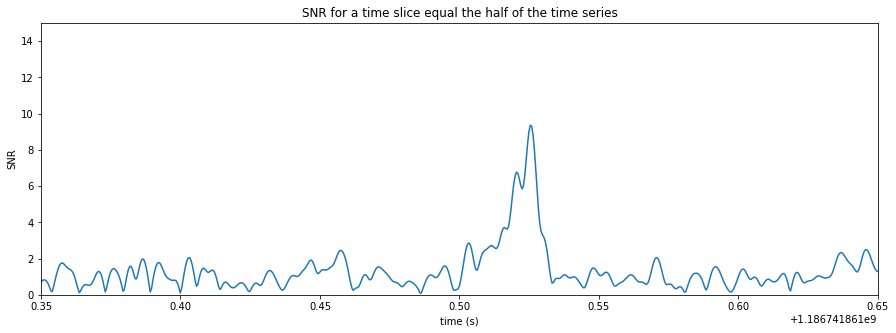

In [26]:
#zoomed version of the plot above
plt.figure(figsize=[15,5])
plt.plot(snr.sample_times, abs(snr))
plt.title("SNR for a time slice equal the half of the time series")
plt.xlim(m.time-0.15, m.time+0.15)
plt.ylim(0,15)
plt.xlabel("time (s)")
plt.ylabel("SNR")

For half the time, the large view seems to be more noisy but the zoom still enables to observe a clear peak around the time of the event, which is not the case for the time slice of 20 seconds.

In order to see if half the time is a treshold for the lenght of the treshold, we can look at the SNR in the case of 1 second less than the half, the half and 1 second more in order to see if a significant difference does exist.

Text(0.5,1,'PSD for time slices just under half the time, half the time and just above it')

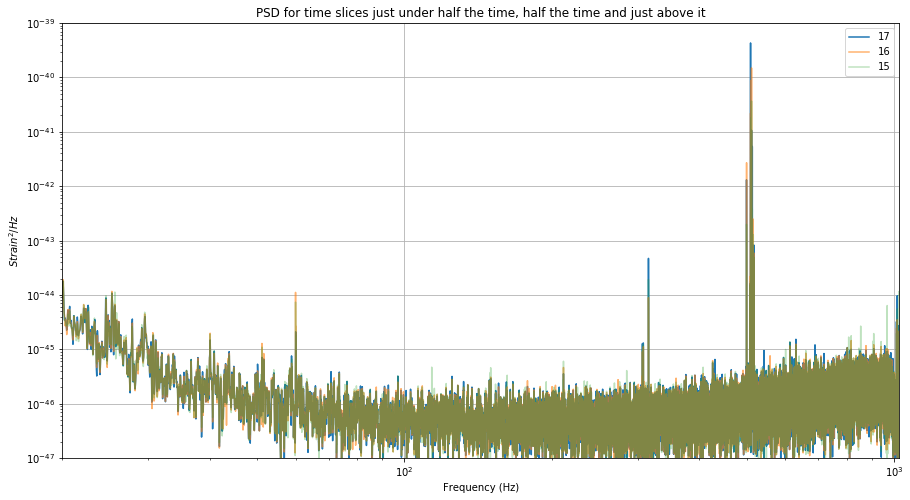

In [27]:
time_slices=[17,16,15]
alphas=[1,0.6,0.3]
psds=[]
ts=m.strain("L1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2,2)
plt.figure(figsize=[15,8])
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psds.append(p)
    plt.plot(p.sample_frequencies, p, label=time_slices[i], alpha=alphas[i])
plt.yscale('log')
plt.xscale('log')
plt.ylim(1e-47, 1e-39)
plt.xlim(20, 1024)
plt.ylabel('$Strain^2 / Hz$')
plt.xlabel('Frequency (Hz)')
plt.grid()
plt.legend(loc="best")
plt.title("PSD for time slices just under half the time, half the time and just above it")

Text(0,0.5,'SNR')

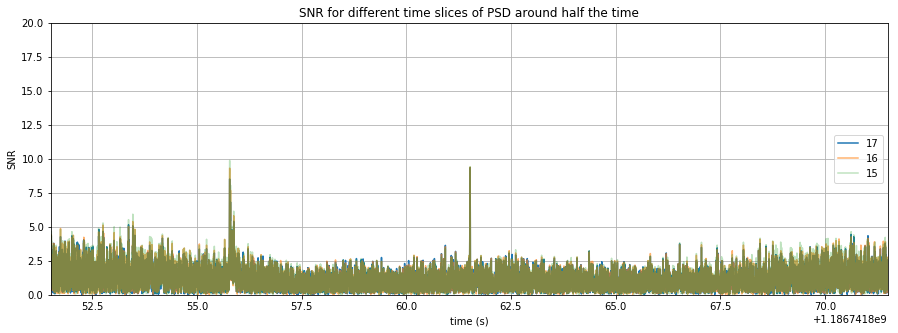

In [28]:
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
alphas=[1,0.6,0.3]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psds[j]))
    snr=matched_filter(hp, data, psd=psds[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR for different time slices of PSD around half the time")
plt.grid()
plt.xlim(m.time-10, m.time+10)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0,0.5,'SNR')

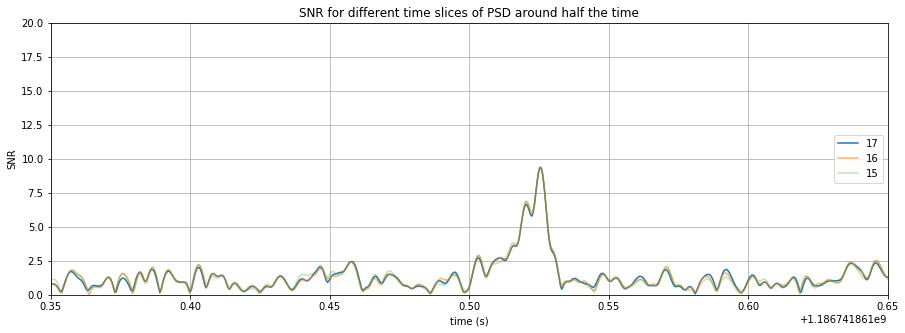

In [29]:
#zoom around the time of interest
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psds[j]))
    snr=matched_filter(hp, data, psd=psds[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR for different time slices of PSD around half the time")
plt.grid()
plt.xlim(m.time-0.15, m.time+0.15)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Contrary to what I thought, the treshold is not exactly at the half.

The hypothesis tested hereunder is to see if there an increase of the SNR when one takes even smaller time slices. 

Test for 1/100 th of the total time

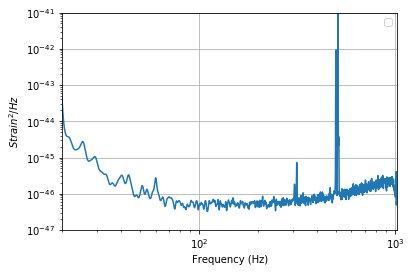

In [30]:
#test for the psd for 1/100 th of the total time
m=Merger("GW170814")
ts=m.strain('L1').highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2,2)
psd=data.psd(1)
psd=interpolate(psd, data.delta_f)
psd=inverse_spectrum_truncation(psd, data.sample_rate, low_frequency_cutoff=20.)

plt.plot(psd.sample_frequencies, psd)
plt.yscale("log")
plt.xscale("log")
plt.ylim(1e-47, 1e-41)
plt.xlim(20, 1024)
plt.ylabel('$Strain^2 / Hz$')
plt.xlabel('Frequency (Hz)')
plt.grid()
plt.legend(loc="best")

28417


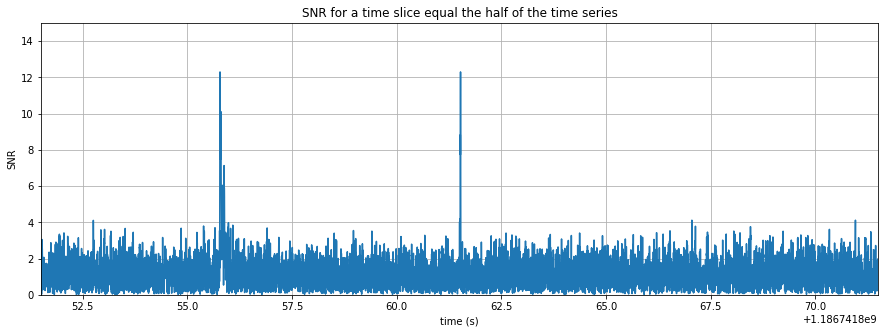

In [31]:
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0 
cmass *= (1 + m.median1d("redshift"))
hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2= cmass, f_lower=20.0, delta_f=data.delta_f)
hp.resize(len(psd))
print(len(hp))
snr=matched_filter(hp, data, psd=psd, low_frequency_cutoff=20.)
plt.figure(figsize=[15,5])
plt.plot(snr.sample_times, abs(snr))
plt.title("SNR for a time slice equal the half of the time series")
plt.xlim(m.time-10, m.time+10)
plt.ylim(0,15)
plt.xlabel("time (s)")
plt.ylabel("SNR")
plt.grid()

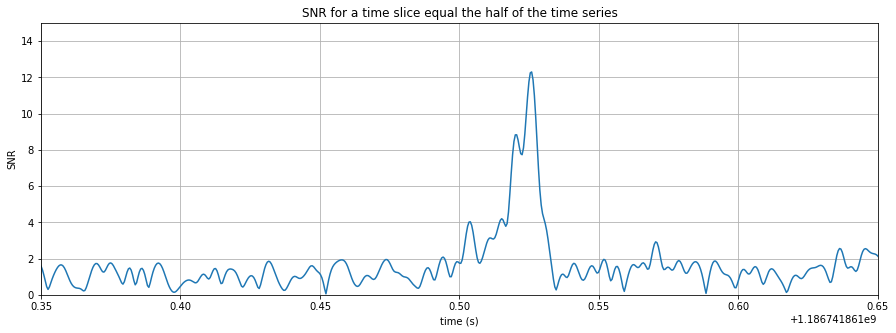

In [32]:
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0 
cmass *= (1 + m.median1d("redshift"))
hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2= cmass, f_lower=20.0, delta_f=data.delta_f)
hp.resize(len(psd))
snr=matched_filter(hp, data, psd=psd, low_frequency_cutoff=20.)
plt.figure(figsize=[15,5])
plt.plot(snr.sample_times, abs(snr))
plt.title("SNR for a time slice equal the half of the time series")
plt.xlim(m.time-0.15, m.time+0.15)
plt.ylim(0,15)
plt.xlabel("time (s)")
plt.ylabel("SNR")
plt.grid()

Now, we want to see the gain that one has for the SNR depanding on the time slices chose. Is 1 second the maximum possible or is it equivalent for time slices up to a given values. Another question is to know when the peak is not identifiable anymore

We first look at the evolution for the SNR when we take 1, 2, 3 , 4, 5 seconds time slices

Text(0,0.5,'SNR')

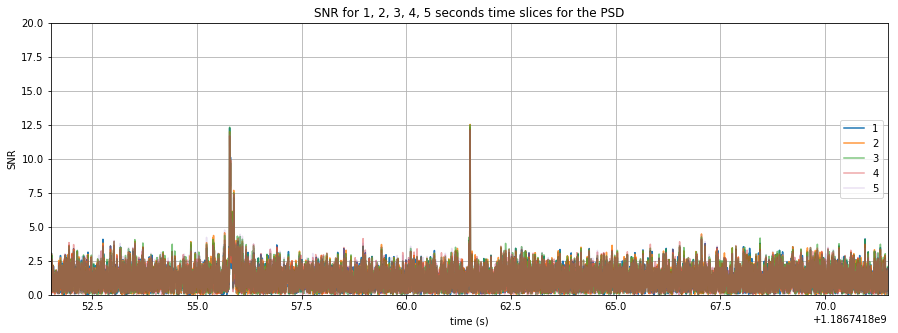

In [33]:
time_slices=[1,2,3,4,5]
alphas=[1,0.8,0.6,0.4,0.2]
psd=[]
ts=m.strain("L1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2,2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR for 1, 2, 3, 4, 5 seconds time slices for the PSD")
plt.grid()
plt.xlim(m.time-10, m.time+10)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0,0.5,'SNR')

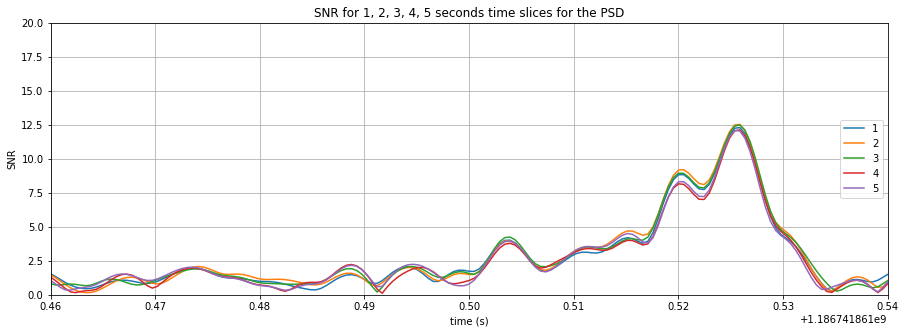

In [34]:
#zoom
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR for 1, 2, 3, 4, 5 seconds time slices for the PSD")
plt.grid()
plt.xlim(m.time-0.04, m.time+0.04)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0,0.5,'SNR')

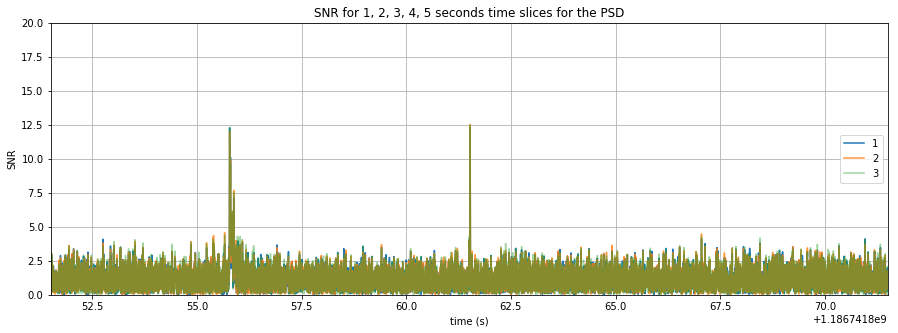

In [35]:
#for 1, 3 and 5 s
time_slices=[1,2,3]
alphas=[1,0.8,0.45]
psd=[]
ts=m.strain("L1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2,2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR for 1, 2, 3, 4, 5 seconds time slices for the PSD")
plt.grid()
plt.xlim(m.time-10, m.time+10)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0,0.5,'SNR')

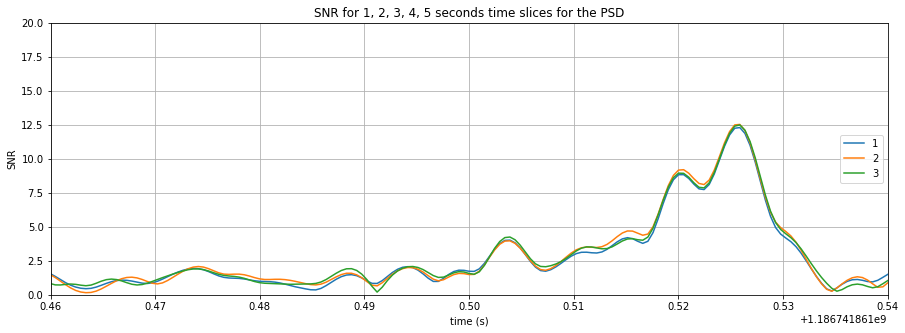

In [36]:
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR for 1, 2, 3, 4, 5 seconds time slices for the PSD")
plt.grid()
plt.xlim(m.time-0.04, m.time+0.04)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Since 3 seconds seems to be the highest between the 3 lowest, we can see if 4 seconds is still better or not, or if the maximum decreases again. 

Text(0,0.5,'SNR')

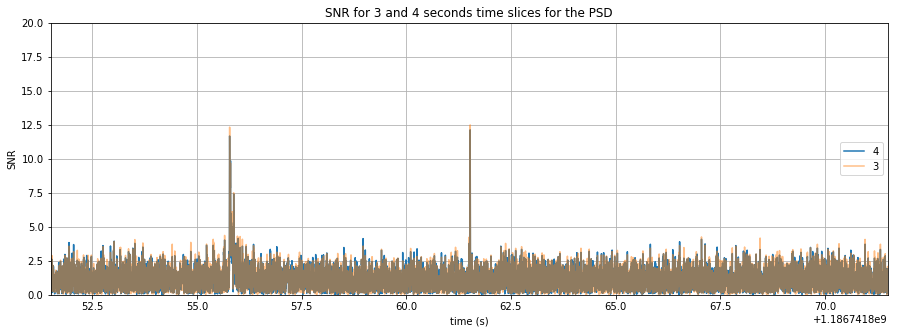

In [37]:
#for 3 and 4 seconds
time_slices=[4,3]
alphas=[1,0.5]
psd=[]
ts=m.strain("L1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2,2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR for 3 and 4 seconds time slices for the PSD")
plt.grid()
plt.xlim(m.time-10, m.time+10)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0,0.5,'SNR')

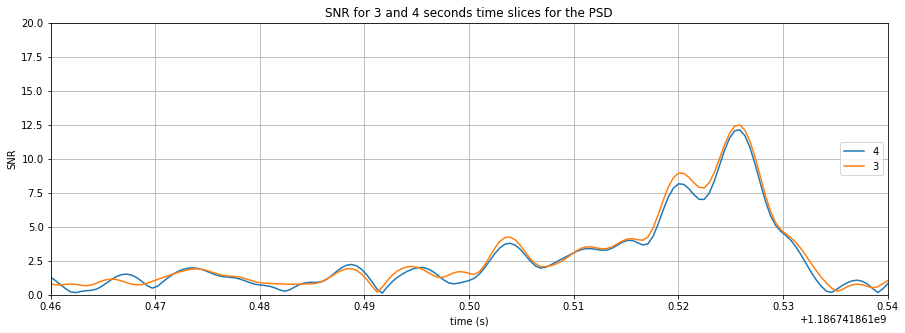

In [38]:
#zoom
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR for 3 and 4 seconds time slices for the PSD")
plt.grid()
plt.xlim(m.time-0.04, m.time+0.04)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0,0.5,'SNR')

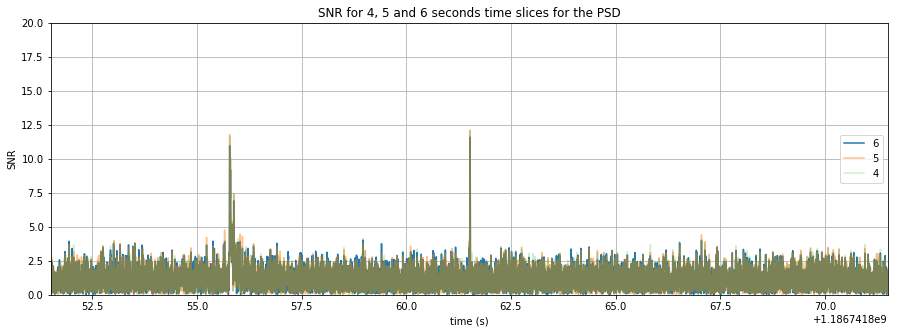

In [39]:
#verification thah 5 seconds keeps on decreasing wrt 4 seconds 
time_slices=[6,5,4]
alphas=[1,0.5, 0.2]
psd=[]
ts=m.strain("L1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2,2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR for 4, 5 and 6 seconds time slices for the PSD")
plt.grid()
plt.xlim(m.time-10, m.time+10)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0,0.5,'SNR')

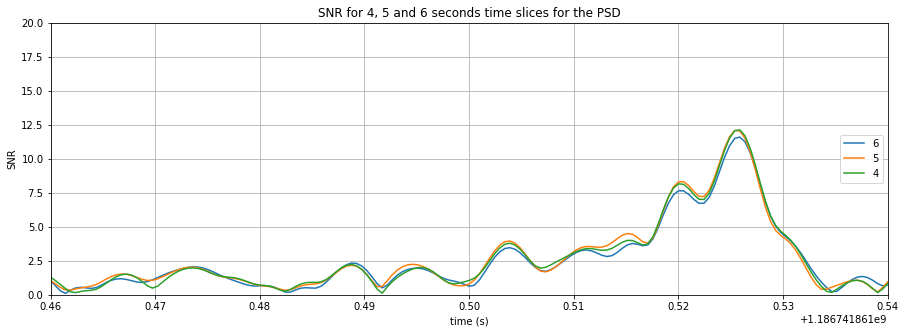

In [40]:
#zoom
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR for 4, 5 and 6 seconds time slices for the PSD")
plt.grid()
plt.xlim(m.time-0.04, m.time+0.04)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

The SNR seems to be the mximum for 3 seconds.

Now, we can look where the peak seems to totally disapear from view.

Text(0,0.5,'SNR')

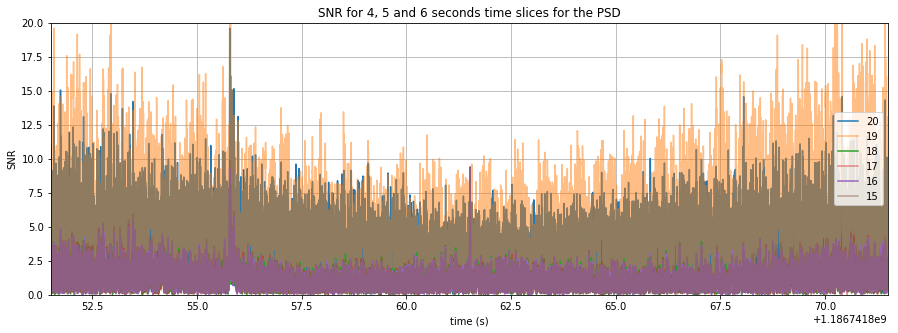

In [41]:
#verification thah 5 seconds keeps on decreasing wrt 4 seconds 
time_slices=[20,19,18,17,16,15]
alphas=[1,0.5,1,0.5,1,0.5]
psd=[]
ts=m.strain("L1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2,2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR for 4, 5 and 6 seconds time slices for the PSD")
plt.grid()
plt.xlim(m.time-10, m.time+10)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0,0.5,'SNR')

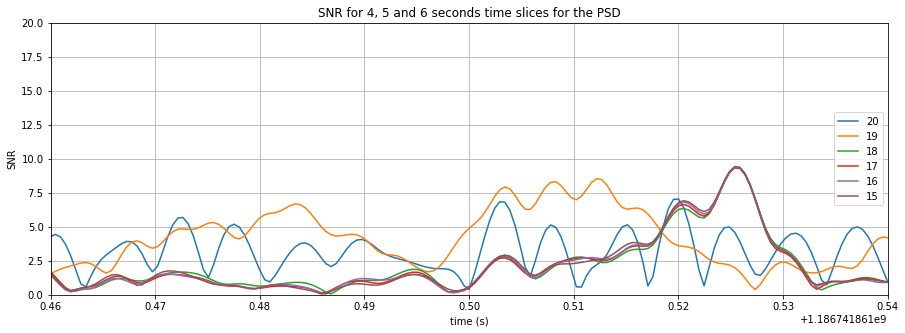

In [42]:
#zoom
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR for 4, 5 and 6 seconds time slices for the PSD")
plt.grid()
plt.xlim(m.time-0.04, m.time+0.04)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Here, 18 seems to still return a peak but 19 not. In order to confirm, we look specifically to the difference between both

Text(0,0.5,'SNR')

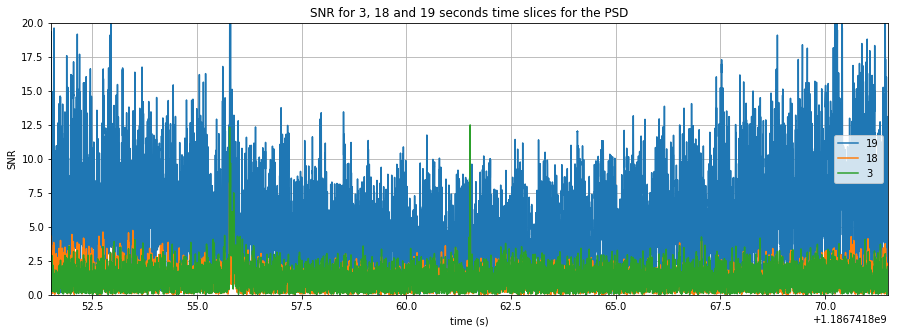

In [43]:
#verification thah 5 seconds keeps on decreasing wrt 4 seconds 
time_slices=[19,18,3]
alphas=[1,1,1]
psd=[]
ts=m.strain("L1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2,2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR for 3, 18 and 19 seconds time slices for the PSD")
plt.grid()
plt.xlim(m.time-10, m.time+10)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0,0.5,'SNR')

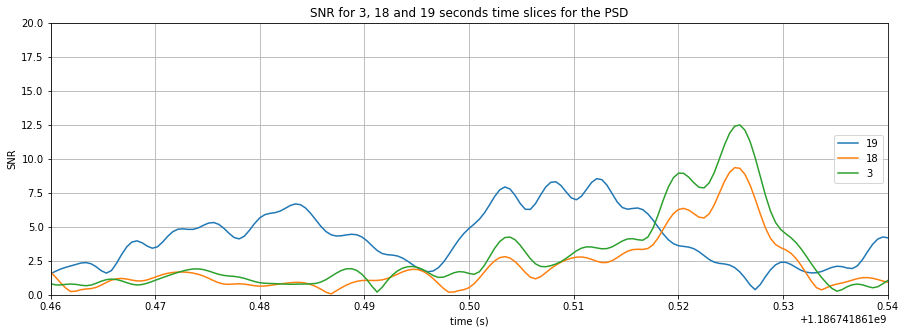

In [44]:
#zoom
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR for 3, 18 and 19 seconds time slices for the PSD")
plt.grid()
plt.xlim(m.time-0.04, m.time+0.04)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0,0.5,'SNR')

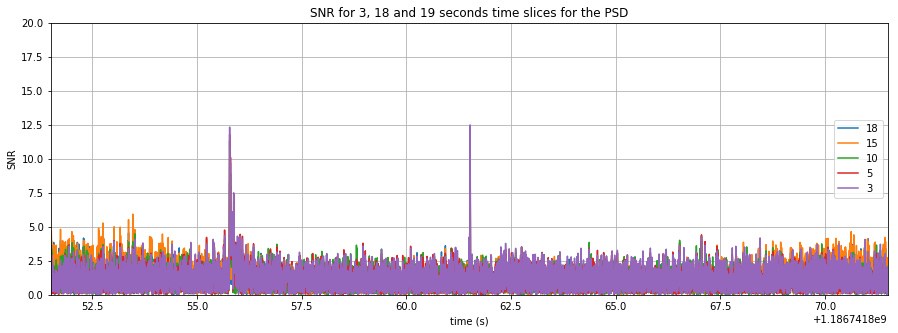

In [45]:
#verification thah 5 seconds keeps on decreasing wrt 4 seconds 
time_slices=[18,15,10,5,3]
alphas=[1,1,1,1,1]
psd=[]
ts=m.strain("L1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2,2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR for 3, 18 and 19 seconds time slices for the PSD")
plt.grid()
plt.xlim(m.time-10, m.time+10)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0,0.5,'SNR')

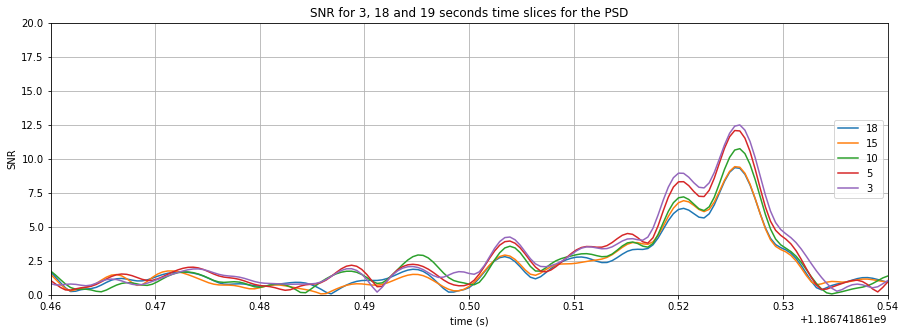

In [46]:
#zoom
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR for 3, 18 and 19 seconds time slices for the PSD")
plt.grid()
plt.xlim(m.time-0.04, m.time+0.04)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

We look at the chisquare test for the different times, taking 1,3,5,10,15,20 seconds interval ad see if the test works. Then we look if the peak is still present for the reweighted data

Text(0,0.5,'SNR')

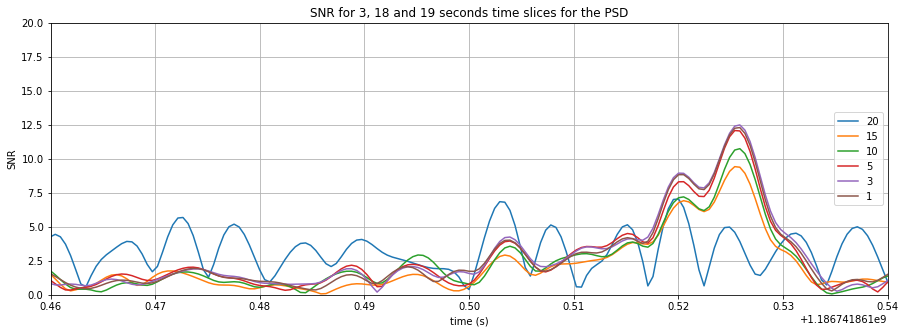

In [47]:
time_slices=[20,15,10,5,3,1]
alphas=[1,1,1,1,1,1]
psd=[]
ts=m.strain("L1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2,2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    snrs.append(snr)
#zoom
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    plt.plot(snrs[j].sample_times, abs(snrs[j]), label=time_slices[j])
plt.legend(loc="right")
plt.title("SNR for 3, 18 and 19 seconds time slices for the PSD")
plt.grid()
plt.xlim(m.time-0.04, m.time+0.04)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0.5,0,'time (s)')

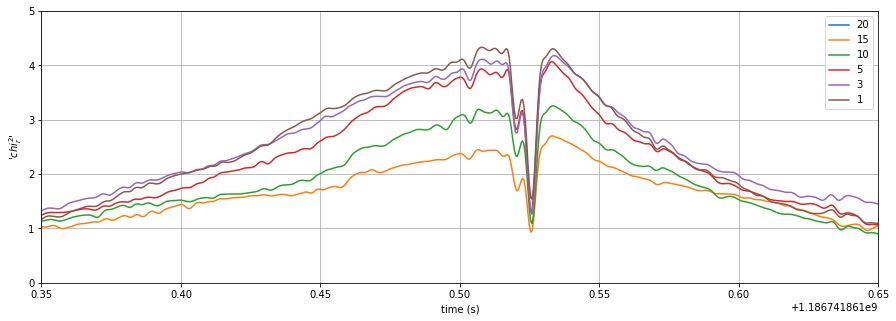

In [48]:
#chi square test computation
from pycbc.vetoes import power_chisq
chisq = []
for i in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[i]))
    nbins=26 #here, the number given in an example found in the pycbc tutorials, after, see the influence of it
    chi=power_chisq(hp, data, nbins, psd[i], low_frequency_cutoff=20.)
    chi=chi.crop(5,4)
    dof=nbins*2-2
    chi/=dof
    chisq.append(chi)
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    plt.plot(chisq[j].sample_times, chisq[j], label=time_slices[j])
plt.legend(loc="best")
plt.grid()
plt.xlim(m.time-0.15, m.time+0.15)
plt.ylim(0,5)
plt.ylabel("'$chi^2_r$'")
plt.xlabel("time (s)")

The drop for 20, 15 and 10 seconds is clearly less important then for the 3 other times. In order to have a better view on these 3, we can first make a graph with only these parts.

Text(0.5,0,'time (s)')

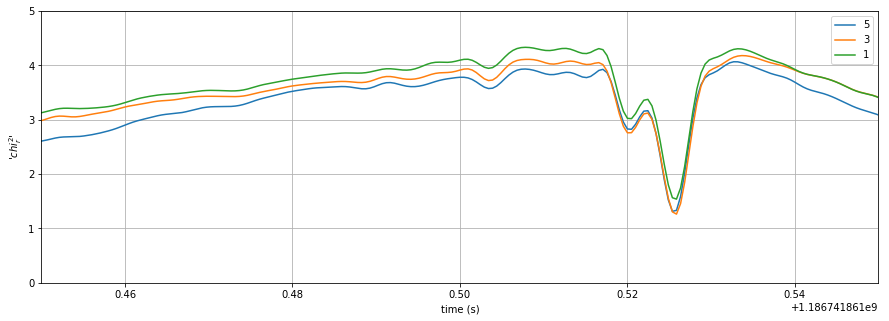

In [49]:
time_slices=[5,3,1]
alphas=[1,1,1]
psd=[]
ts=m.strain("L1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2,2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[i]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    snrs.append(snr)
chisq = []
for i in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[i]))
    nbins=26 #here, the number given in an example found in the pycbc tutorials, after, see the influence of it
    chi=power_chisq(hp, data, nbins, psd[i], low_frequency_cutoff=20.)
    chi=chi.crop(5,4)
    dof=nbins*2-2
    chi/=dof
    chisq.append(chi)
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    plt.plot(chisq[j].sample_times, chisq[j], label=time_slices[j])
plt.legend(loc="best")
plt.grid()
plt.xlim(m.time-0.05, m.time+0.05)
plt.ylim(0,5)
plt.ylabel("'$chi^2_r$'")
plt.xlabel("time (s)")

The drop is the most important for 3 second time slice. That is coherant with the fact the the SNR is the most important this value. 

The next test is to see if all what has been found and discussed above is still verified for the reweighted SNR

Text(0,0.5,'Re-weighted SNR')

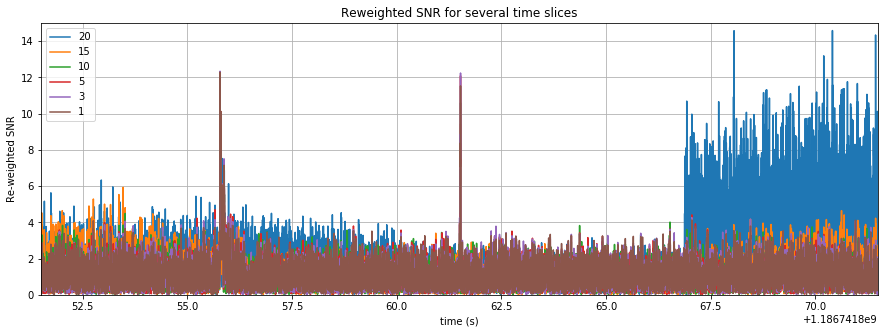

In [50]:
time_slices=[20,15,10,5,3,1]
alphas=[1,0.8,0.5,0.2,1,0.5]
psd=[]
ts=m.strain("L1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2,2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    snrs.append(snr)
chisq = []
for i in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[i]))
    nbins=26 #here, the number given in an example found in the pycbc tutorials, after, see the influence of it
    chi=power_chisq(hp, data, nbins, psd[i], low_frequency_cutoff=20.)
    chi=chi.crop(5,4)
    dof=nbins*2-2
    chi/=dof
    chisq.append(chi)
#reweighting of the SNR
from pycbc.events.ranking import newsnr
nsnr=[]
for j in range(len(time_slices)):
    new=newsnr(abs(snrs[j]), chisq[j])
    nsnr.append(new)
plt.figure(figsize=[15,5])
for k in range(len(time_slices)):
    plt.plot(snrs[k].sample_times, nsnr[k], label=time_slices[k])
plt.legend(loc="best")
plt.grid()
plt.title("Reweighted SNR for several time slices")
plt.xlim(m.time-10, m.time+10)
plt.ylim(0,15)
plt.xlabel("time (s)")
plt.ylabel("Re-weighted SNR")

Text(0,0.5,'Re-weighted SNR')

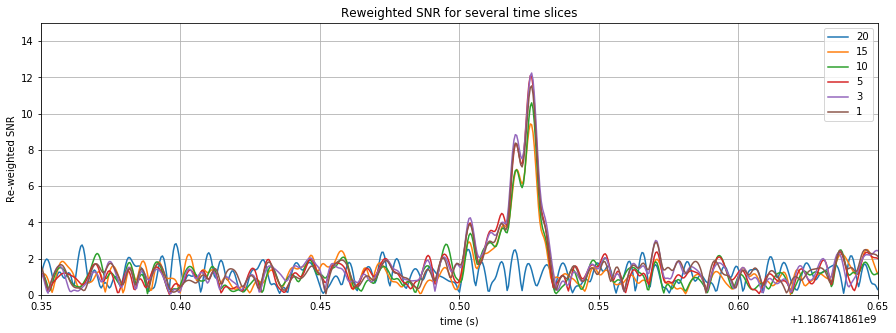

In [51]:
#zoomed version of the plot above
plt.figure(figsize=[15,5])
for k in range(len(time_slices)):
    plt.plot(snrs[k].sample_times, nsnr[k], label=time_slices[k])
plt.legend(loc="best")
plt.grid()
plt.title("Reweighted SNR for several time slices")
plt.xlim(m.time-0.15, m.time+0.15)
plt.ylim(0,15)
plt.xlabel("time (s)")
plt.ylabel("Re-weighted SNR")

5,3 and 1 seem to be closer of each other. In order to see better, we can concentrate on these 3 values

Text(0,0.5,'Re-weighted SNR')

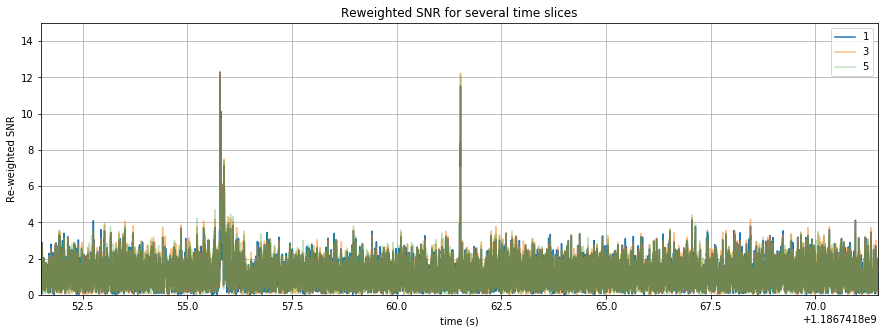

In [52]:
time_slices=[1,3,5]
alphas=[1,0.5,0.3]
psd=[]
ts=m.strain("L1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2,2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    snrs.append(snr)
chisq = []
for i in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[i]))
    nbins=26 #here, the number given in an example found in the pycbc tutorials, after, see the influence of it
    chi=power_chisq(hp, data, nbins, psd[i], low_frequency_cutoff=20.)
    chi=chi.crop(5,4)
    dof=nbins*2-2
    chi/=dof
    chisq.append(chi)
#reweighting of the SNR
from pycbc.events.ranking import newsnr
nsnr=[]
for j in range(len(time_slices)):
    new=newsnr(abs(snrs[j]), chisq[j])
    nsnr.append(new)
plt.figure(figsize=[15,5])
for k in range(len(time_slices)):
    plt.plot(snrs[k].sample_times, nsnr[k], label=time_slices[k], alpha=alphas[k])
plt.legend(loc="best")
plt.grid()
plt.title("Reweighted SNR for several time slices")
plt.xlim(m.time-10, m.time+10)
plt.ylim(0,15)
plt.xlabel("time (s)")
plt.ylabel("Re-weighted SNR")

Text(0,0.5,'Re-weighted SNR')

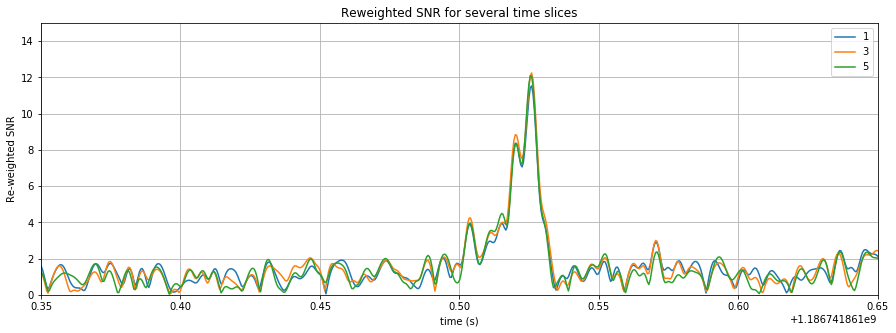

In [53]:
#zoomed version of the plot above
plt.figure(figsize=[15,5])
for k in range(len(time_slices)):
    plt.plot(snrs[k].sample_times, nsnr[k], label=time_slices[k])
plt.legend(loc="best")
plt.grid()
plt.title("Reweighted SNR for several time slices")
plt.xlim(m.time-0.15, m.time+0.15)
plt.ylim(0,15)
plt.xlabel("time (s)")
plt.ylabel("Re-weighted SNR")

3 is still a bit higher but the difference between 3 and 5 is different. The difference cannot be felt in the chisquare since it is used in order to have the reweighted value.

The calculation done above shows that, for this event, the best value for the PSD in order to find the highest SNR is found with a time slice of 3 seconds. This is tested only for the L1 detctor so far. In order to see if this keeps being true for the other detectors, we can redo the PSD and SNR calculation for the same event (GW 170814) but for H1 and V1 detectors. For those, as has been shown in the first data analysis, the value of the SR is lwer. Nevertheless, a peak is present at the time of the event, which can be found for other time slices. It can also be higher or lower, depanding in the value of the time slice that is used.

First we look at the PSD and SNR for different times in the case of the H1 detecto

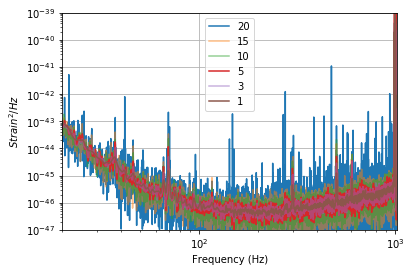

In [54]:
from pycbc.psd import interpolate, inverse_spectrum_truncation
m=Merger("GW170814")

time_slices=[20,15,10,5,3,1]
alphas=[1,0.5,0.5,1,0.5,1]
psd=[]

ts=m.strain("H1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2, 2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)
    plt.plot(psd[i].sample_frequencies, psd[i], label=time_slices[i], alpha=alphas[i])

plt.yscale("log")
plt.xscale("log")
plt.ylim(1e-47, 1e-39)
plt.xlim(20, 1024)
plt.ylabel('$Strain^2 / Hz$')
plt.xlabel('Frequency (Hz)')
plt.grid()
plt.legend(loc="best")

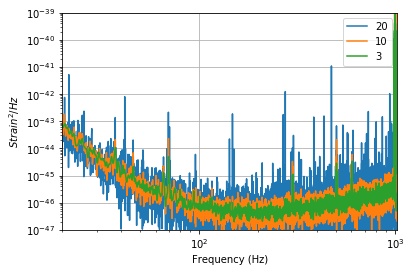

In [55]:
m=Merger("GW170814")

time_slices=[20,10,3]
alphas=[1,1,1]
psd=[]

ts=m.strain("H1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2, 2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)
    plt.plot(psd[i].sample_frequencies, psd[i], label=time_slices[i], alpha=alphas[i])

plt.yscale("log")
plt.xscale("log")
plt.ylim(1e-47, 1e-39)
plt.xlim(20, 1024)
plt.ylabel('$Strain^2 / Hz$')
plt.xlabel('Frequency (Hz)')
plt.grid()
plt.legend(loc="best")

Text(0,0.5,'SNR')

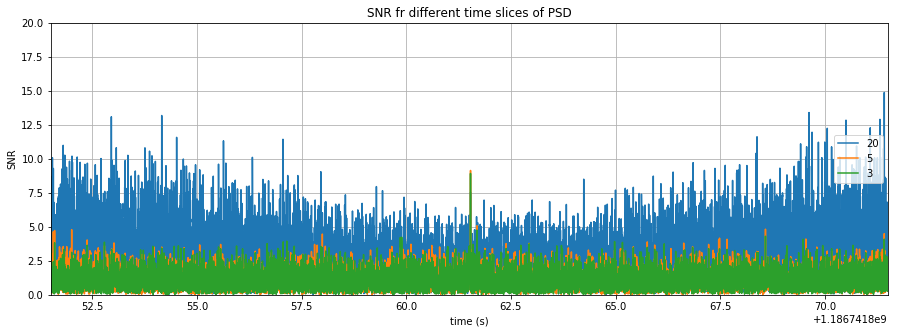

In [56]:
time_slices=[20,5,3]
alphas=[1,1,1]

ts=m.strain("H1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2, 2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)

cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR fr different time slices of PSD")
plt.grid()
plt.xlim(m.time-10, m.time+10)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

The time slice of 1 also leads to the uprise of a very noisy SNR forest of peaks, where the peak of interest cannot be detected or seen clearly with respect to the other.
We make a SNR plot for the 1 and 3 seconds time slices in prder to compare both

Text(0,0.5,'SNR')

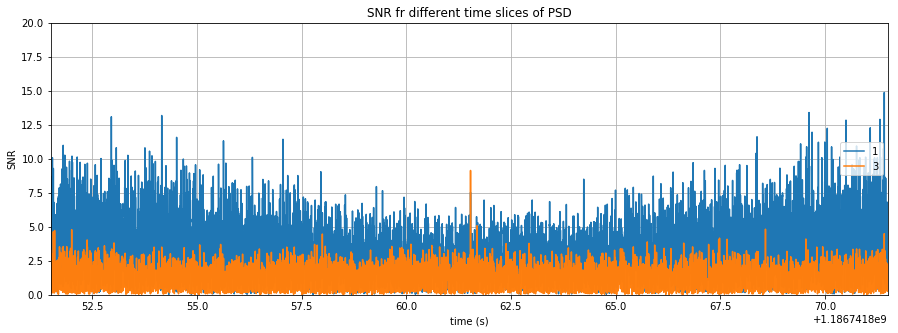

In [57]:
time_slices=[1,3]
alphas=[1,3]

ts=m.strain("H1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2, 2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)

cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR fr different time slices of PSD")
plt.grid()
plt.xlim(m.time-10, m.time+10)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

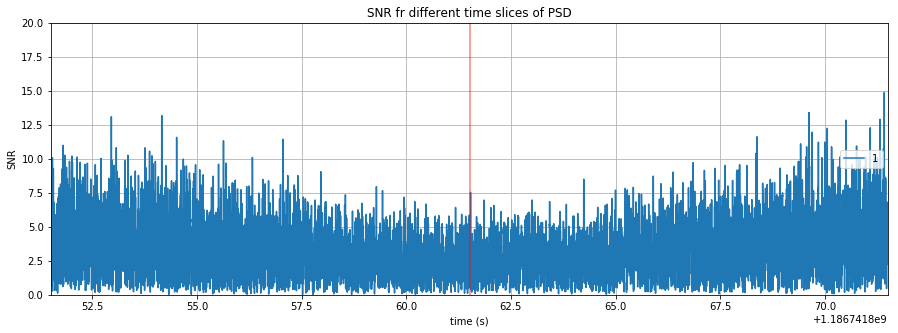

In [58]:
#for 1 alone
time_slices=[1]
alphas=[1]

ts=m.strain("H1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2, 2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)

cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR fr different time slices of PSD")
plt.grid()
plt.xlim(m.time-10, m.time+10)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 
plt.axvline(x=m.time+0.025, color="red", alpha=0.5)

The redline shows the position of the peak for the event. One sees that, for the 1 second time slice, this peak does not pass above the other. It is thus not seen in this case. In addition, when taking a 3 second time slice, the peak is higher but the other ones, present at different times, are less important and, therefore, the one peak that is present is a clear hint for the presence of the event at a given time. Now, we can look at a zoomed portion in order to determine if a 3 second time slice for the PSD still leads to the highest value for the SNR

Text(0,0.5,'SNR')

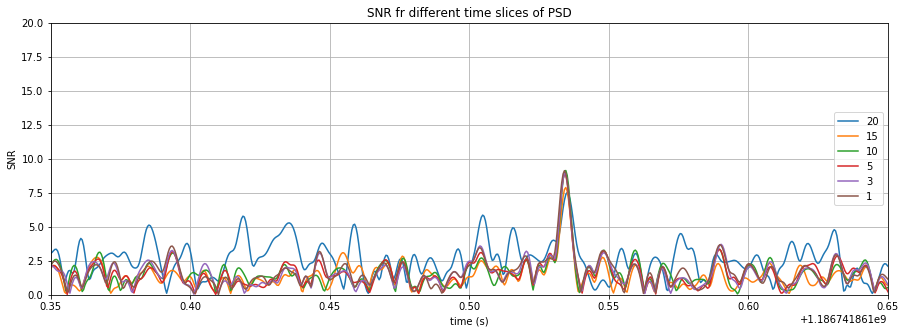

In [59]:
time_slices=[20,15,10,5,3,1]
alphas=[1,0.5,0.5,1,0.5,1]
psd=[]

ts=m.strain("H1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2, 2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)
    
    
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
alphas=[1,1,1,1,1,1]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR fr different time slices of PSD")
plt.grid()
plt.xlim(m.time-0.15, m.time+0.15)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

The value of 20 for the time slice is still unusable. In additon, the plot above already shows that, event if a peak is present, the value for 15 and 10 are clearly alower than for the others.

Now, we test the zoomed version for 2,3 and 4 in order to see if 3 is the best

Text(0,0.5,'SNR')

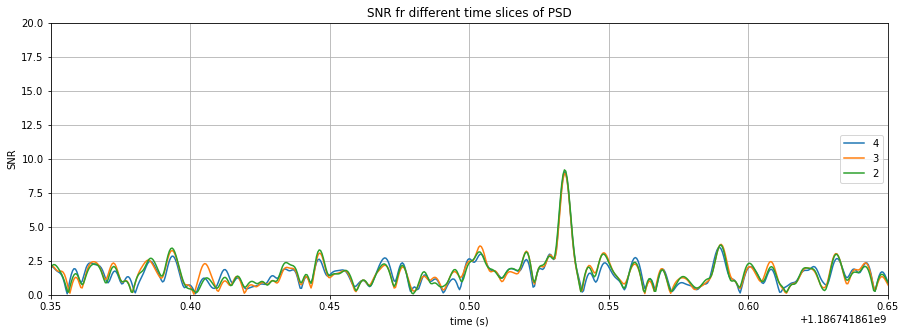

In [60]:
time_slices=[4,3,2]
psd=[]

ts=m.strain("H1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2, 2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)
    
    
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
alphas=[1,1,1]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR fr different time slices of PSD")
plt.grid()
plt.xlim(m.time-0.15, m.time+0.15)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0,0.5,'SNR')

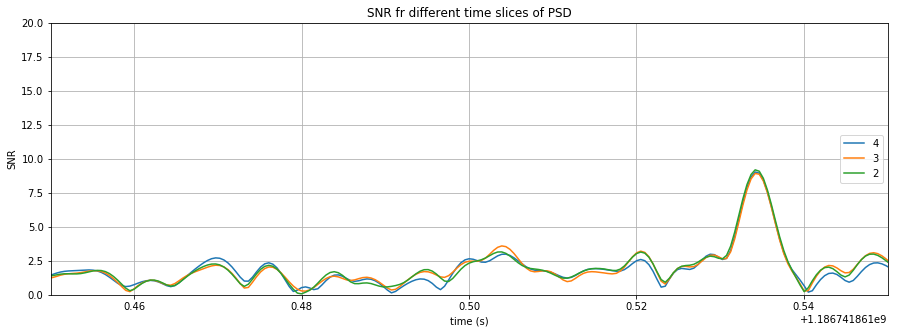

In [61]:
#we zoom still a bit more in order to have a clearer view
alphas=[1,1,1]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR fr different time slices of PSD")
plt.grid()
plt.xlim(m.time-0.05, m.time+0.05)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0,0.5,'SNR')

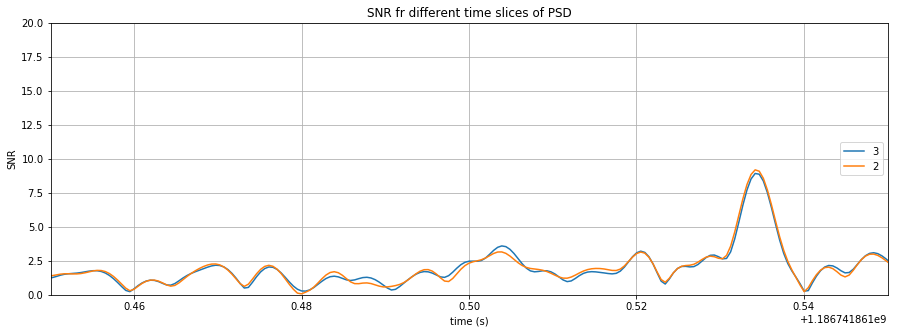

In [62]:
#only 2 and 3 in order to see the difference 
time_slices=[3,2]
psd=[]

ts=m.strain("H1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2, 2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)
    
    
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
alphas=[1,1]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR fr different time slices of PSD")
plt.grid()
plt.xlim(m.time-0.05, m.time+0.05)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0,0.5,'SNR')

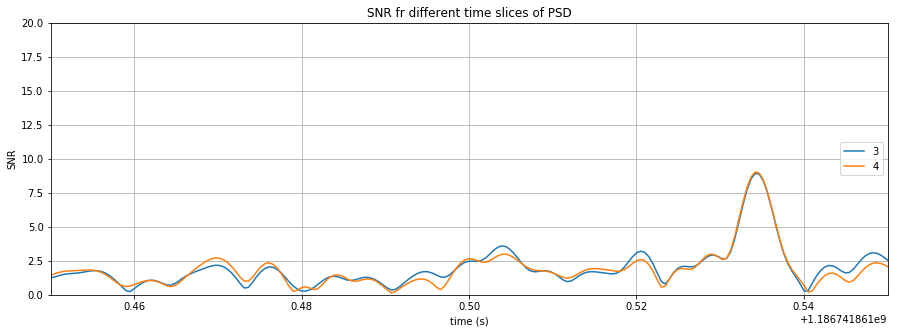

In [63]:
#comparison between 3 and 4 
#only 2 and 3 in order to see the difference 
time_slices=[3,4]
psd=[]

ts=m.strain("H1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2, 2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)
    
    
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
alphas=[1,1]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR fr different time slices of PSD")
plt.grid()
plt.xlim(m.time-0.05, m.time+0.05)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0,0.5,'SNR')

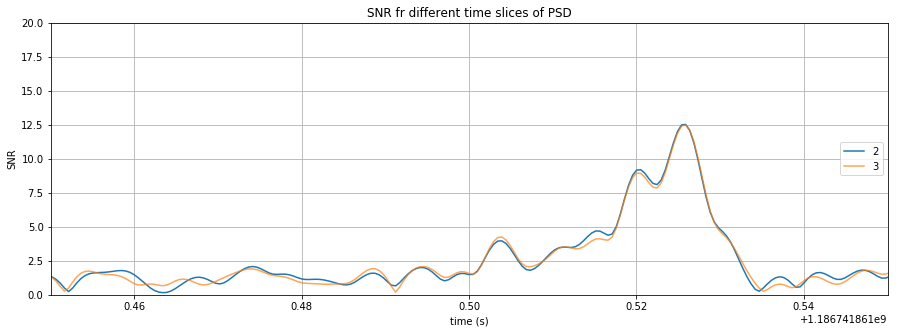

In [64]:
#comparison between 2 and 3 for the L1 detector 
time_slices=[2,3]
psd=[]

ts=m.strain("L1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2, 2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)
    
    
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
alphas=[1,0.7]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR fr different time slices of PSD")
plt.grid()
plt.xlim(m.time-0.05, m.time+0.05)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0,0.5,'SNR')

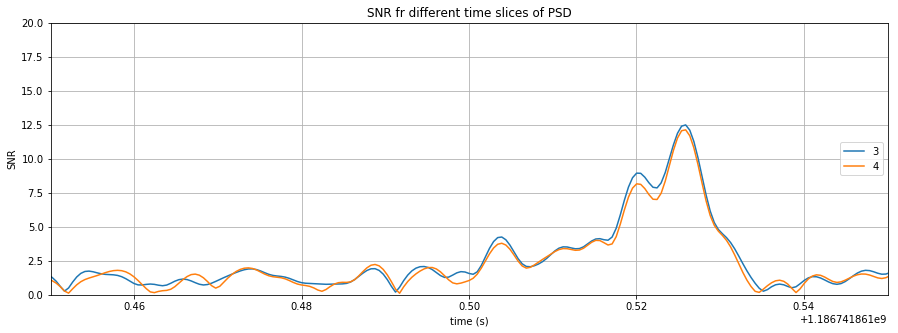

In [65]:
#comparison between 2 and 3 for the L1 detector 
time_slices=[3,4]
psd=[]

ts=m.strain("L1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2, 2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)
    
    
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
alphas=[1,1]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR fr different time slices of PSD")
plt.grid()
plt.xlim(m.time-0.05, m.time+0.05)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

We can also do the chi square test in order to see which one gives the best scenario. We first do it for 20,15,10,5,2,1 and then for 2,3,4

Text(0.5,0,'time (s)')

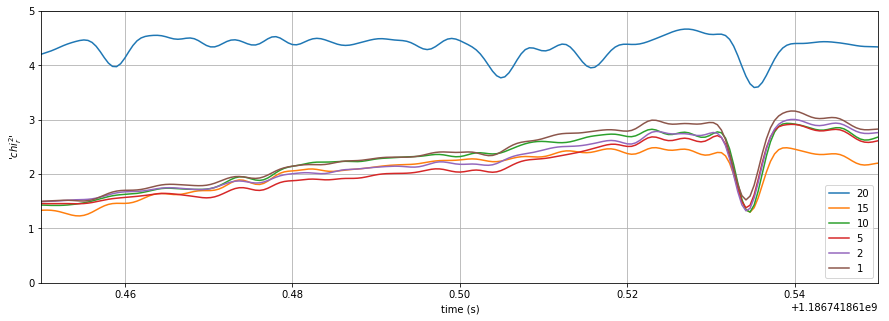

In [66]:
time_slices=[20,15,10,5,2,1]
alphas=[1,1,1,1,1,1]
psd=[]
ts=m.strain("H1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2,2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    snrs.append(snr)
chisq = []
for i in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[i]))
    nbins=26 #here, the number given in an example found in the pycbc tutorials, after, see the influence of it
    chi=power_chisq(hp, data, nbins, psd[i], low_frequency_cutoff=20.)
    chi=chi.crop(5,4)
    dof=nbins*2-2
    chi/=dof
    chisq.append(chi)
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    plt.plot(chisq[j].sample_times, chisq[j], label=time_slices[j])
plt.legend(loc="best")
plt.grid()
plt.xlim(m.time-0.05, m.time+0.05)
plt.ylim(0,5)
plt.ylabel("'$chi^2_r$'")
plt.xlabel("time (s)")

Text(0.5,0,'time (s)')

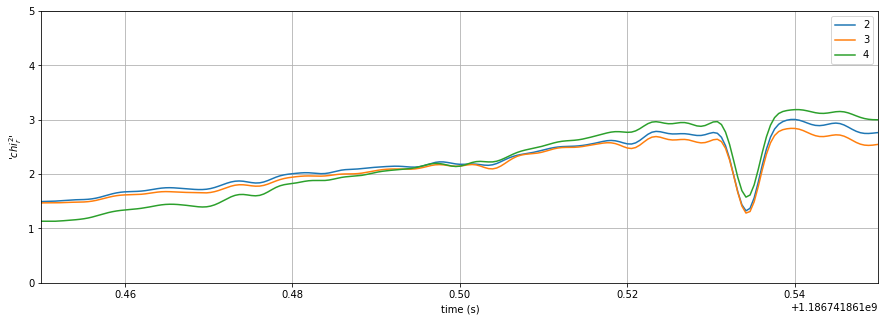

In [67]:
time_slices=[2,3,4]
alphas=[1,1,1,]
psd=[]
ts=m.strain("H1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2,2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[i]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    snrs.append(snr)
chisq = []
for i in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    nbins=26 #here, the number given in an example found in the pycbc tutorials, after, see the influence of it
    chi=power_chisq(hp, data, nbins, psd[i], low_frequency_cutoff=20.)
    chi=chi.crop(5,4)
    dof=nbins*2-2
    chi/=dof
    chisq.append(chi)
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    plt.plot(chisq[j].sample_times, chisq[j], label=time_slices[j])
plt.legend(loc="best")
plt.grid()
plt.xlim(m.time-0.05, m.time+0.05)
plt.ylim(0,5)
plt.ylabel("'$chi^2_r$'")
plt.xlabel("time (s)")

We can also look if the treshold between which the data is usable and unusable is the same or not as when we are in the case of H1 detector

Text(0,0.5,'SNR')

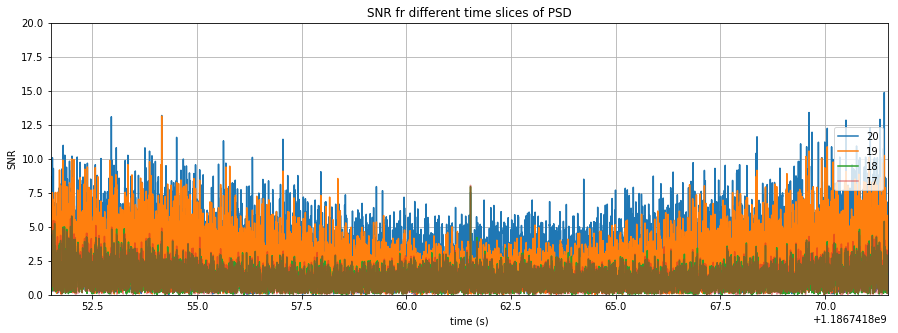

In [68]:
time_slices=[20,19,18,17]
psd=[]

ts=m.strain("H1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2, 2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)
    
    
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
alphas=[1,1,1,0.5]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR fr different time slices of PSD")
plt.grid()
plt.xlim(m.time-10, m.time+10)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0,0.5,'SNR')

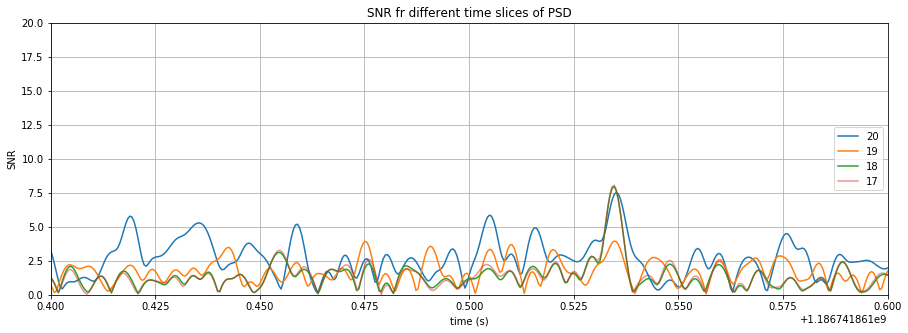

In [69]:
time_slices=[20,19,18,17]
psd=[]

ts=m.strain("H1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2, 2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)
    
    
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
alphas=[1,1,1,0.5]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR fr different time slices of PSD")
plt.grid()
plt.xlim(m.time-0.10, m.time+0.10)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

For the value of 19, the peak us not outstanding w.r.t to the others. For 20, one could argue that the peak is a bit higher as for other places. This is not really true sa the highest value is shifted from the exact time and the peak is not above the other.

We can juste compare 18 and 19 in order to see the difference

Text(0,0.5,'SNR')

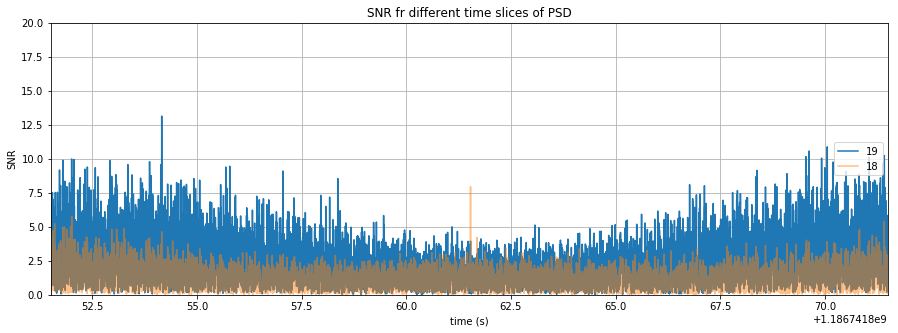

In [70]:
time_slices=[19,18]
psd=[]

ts=m.strain("H1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2, 2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)
    
    
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
alphas=[1,0.5]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR fr different time slices of PSD")
plt.grid()
plt.xlim(m.time-10, m.time+10)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

One sees that the peak is not present for the value of 19, which confirms that above this limit the value cannot be used anymore to find the data.

Text(0,0.5,'SNR')

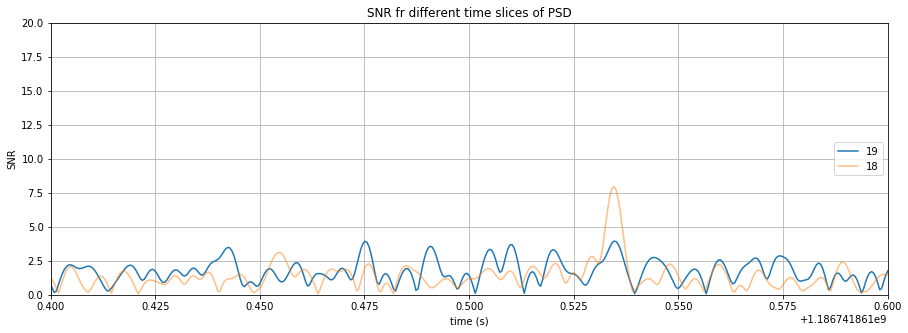

In [71]:
#zoom of the plot above
time_slices=[19,18]
psd=[]

ts=m.strain("H1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2, 2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)
    
    
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
alphas=[1,0.5]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR fr different time slices of PSD")
plt.grid()
plt.xlim(m.time-0.1, m.time+0.1)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0,0.5,'SNR')

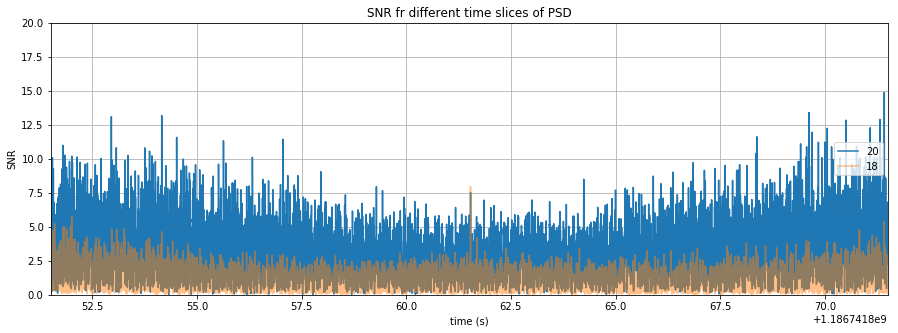

In [72]:
#comaprison of 18 and 20 in order to see if the SNR is, indeed, not concluant anymore
time_slices=[20,18]
psd=[]

ts=m.strain("H1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2, 2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)
    
    
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
alphas=[1,0.5]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR fr different time slices of PSD")
plt.grid()
plt.xlim(m.time-10, m.time+10)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

There is a peak present but it is not significantly higher than the other peaks (even lower at other places). In fact, it is also a bit displaced w.r.t to the peak that should be found. 

Text(0,0.5,'SNR')

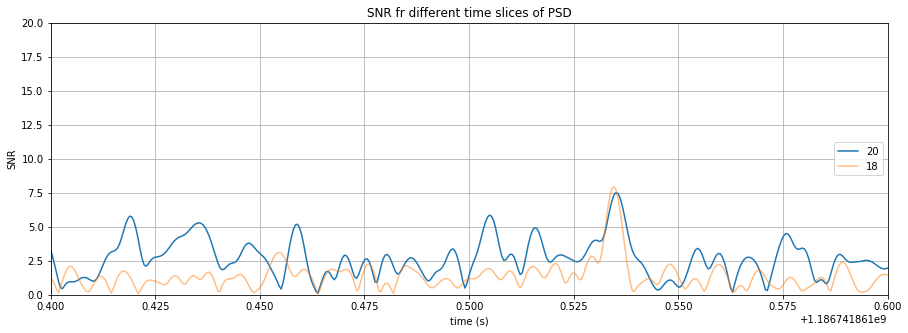

In [73]:
#zoom of the plot above
time_slices=[20,18]
psd=[]

ts=m.strain("H1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2, 2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)
    
    
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
alphas=[1,0.5]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR fr different time slices of PSD")
plt.grid()
plt.xlim(m.time-0.10, m.time+0.10)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0,0.5,'SNR')

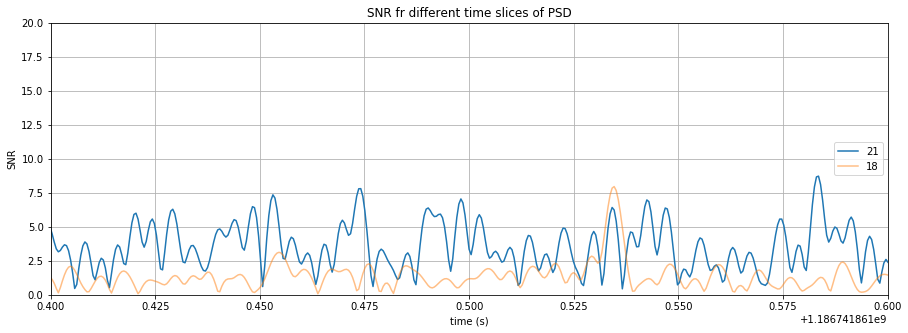

In [74]:
#trial for 21
time_slices=[21,18]
psd=[]

ts=m.strain("H1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2, 2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)
    
    
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
alphas=[1,0.5]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR fr different time slices of PSD")
plt.grid()
plt.xlim(m.time-0.10, m.time+0.10)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Since 21 does not work either, it shows that abive 18 seconds for the psd, the data cannot be used anymore. 

After a look has been taken for L1 and H1 detectors, we see that 2 second is the best time to use for the PSD calculation in order to have the best SNR possible. Now, we can see if it is still the case for the V1 detector.

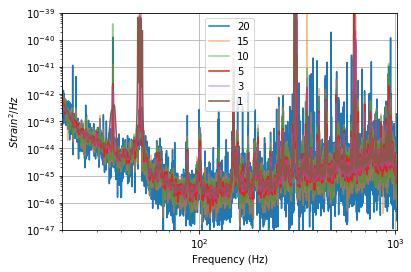

In [75]:
#PSD for V1
m=Merger("GW170814")

time_slices=[20,15,10,5,3,1]
alphas=[1,0.5,0.5,1,0.5,1]
psd=[]

ts=m.strain("V1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2, 2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)
    plt.plot(psd[i].sample_frequencies, psd[i], label=time_slices[i], alpha=alphas[i])

plt.yscale("log")
plt.xscale("log")
plt.ylim(1e-47, 1e-39)
plt.xlim(20, 1024)
plt.ylabel('$Strain^2 / Hz$')
plt.xlabel('Frequency (Hz)')
plt.grid()
plt.legend(loc="best")

The PSD here is still more noisy for higher values but it is, more generally, less clean than for the American detectors.

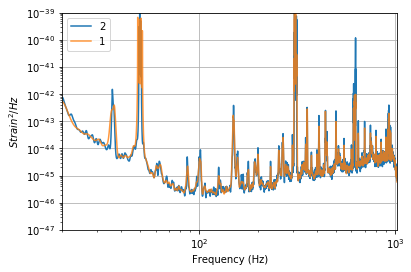

In [76]:
#PSD for V1
m=Merger("GW170814")

time_slices=[2,1]
alphas=[1,0.8]
psd=[]

ts=m.strain("V1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2, 2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)
    plt.plot(psd[i].sample_frequencies, psd[i], label=time_slices[i], alpha=alphas[i])

plt.yscale("log")
plt.xscale("log")
plt.ylim(1e-47, 1e-39)
plt.xlim(20, 1024)
plt.ylabel('$Strain^2 / Hz$')
plt.xlabel('Frequency (Hz)')
plt.grid()
plt.legend(loc="best")

Text(0,0.5,'SNR')

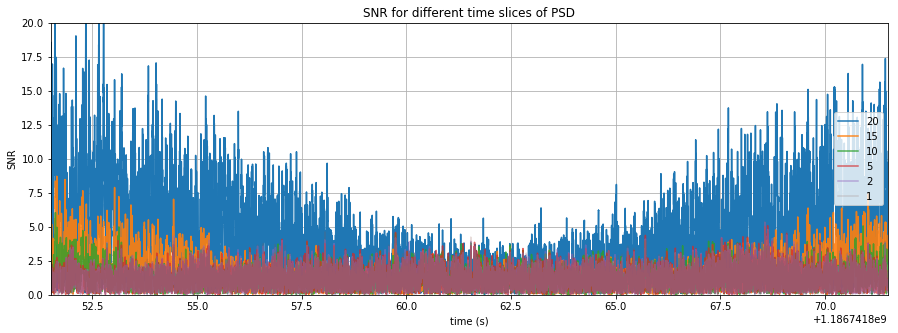

In [77]:
time_slices=[20,15,10,5,2,1]
alphas=[1,0.9,0.8,0.7,0.5,0.2]

ts=m.strain("V1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2, 2)
psd=[]
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)

cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    snrs.append(snr)
    plt.plot(snrs[j].sample_times, abs(snrs[j]), label=time_slices[j], alpha=alphas[j])
plt.legend(loc="right")
plt.title("SNR for different time slices of PSD")
plt.grid()
plt.xlim(m.time-10, m.time+10)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0,0.5,'SNR')

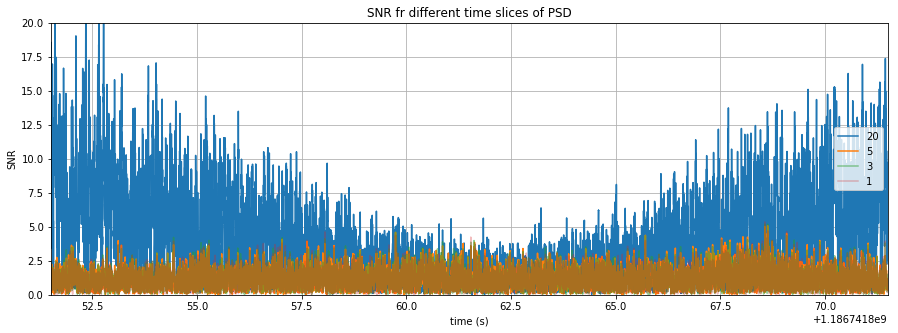

In [78]:
time_slices=[20,5,3,1]
alphas=[1,1,0.5,0.3]
psd=[]
ts=m.strain("V1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2, 2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)

cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR fr different time slices of PSD")
plt.grid()
plt.xlim(m.time-10, m.time+10)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0,0.5,'SNR')

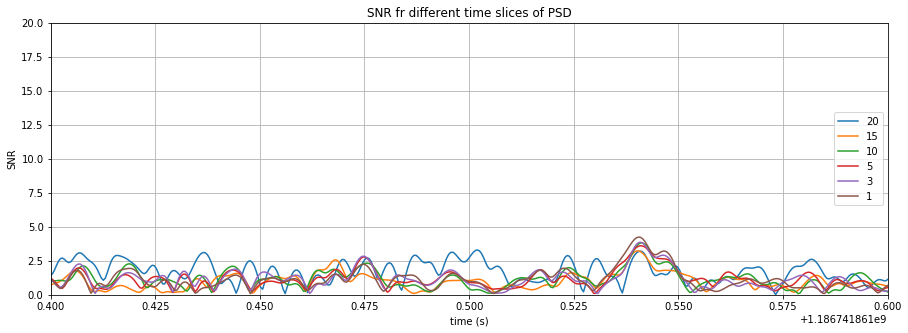

In [79]:
time_slices=[20,15,10,5,3,1]
alphas=[1,1,1,1,1,1]
psd=[]
ts=m.strain("V1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2, 2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)

cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR fr different time slices of PSD")
plt.grid()
plt.xlim(m.time-0.1, m.time+0.1)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0,0.5,'SNR')

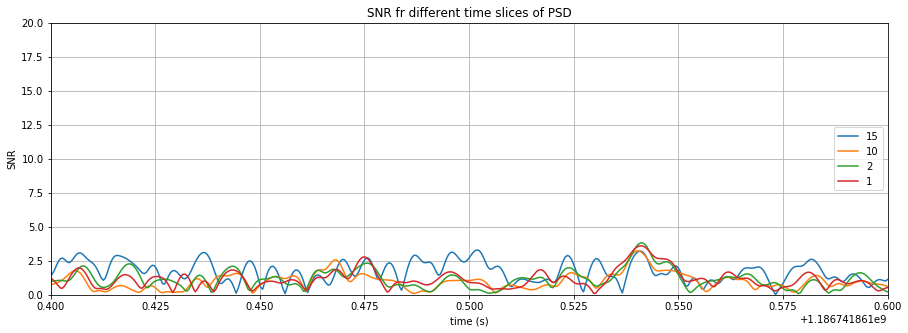

In [80]:
time_slices=[15,10,2,1]
alphas=[1,1,1,1]
pas=[]
ts=m.strain("V1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2, 2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)

cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR fr different time slices of PSD")
plt.grid()
plt.xlim(m.time-0.1, m.time+0.1)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0,0.5,'SNR')

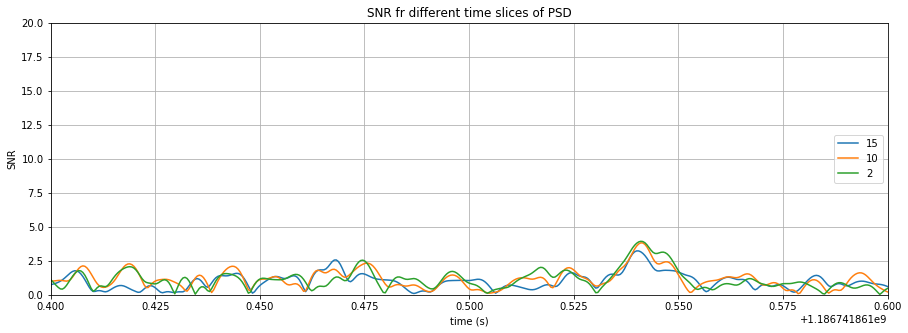

In [81]:
time_slices=[15,10,2]
alphas=[1,1,1]
psd=[]

ts=m.strain("V1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2, 2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)

cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR fr different time slices of PSD")
plt.grid()
plt.xlim(m.time-0.1, m.time+0.1)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

2 is still the highest usable here but the difference with 10 is not as important as it was for the other detectors. Nevertheless, we wheck if it is still the best value for the max SNR based on the PSD by trying to see if the PSD is not higher for close values (3 and 1)

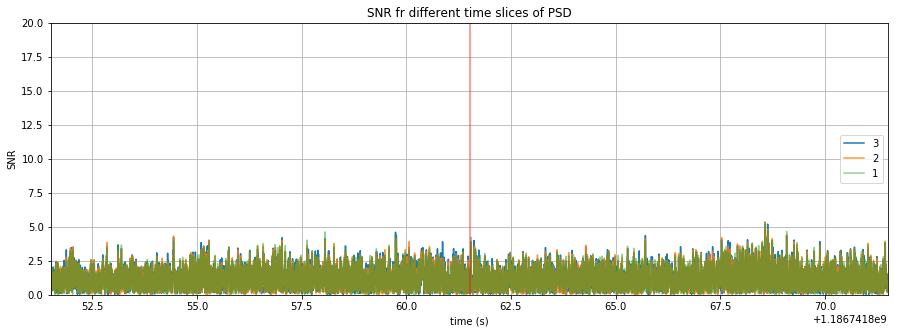

In [82]:
time_slices=[3,2,1]
alphas=[1,0.8,0.5]
psd=[]
ts=m.strain("V1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2, 2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)

cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR fr different time slices of PSD")
plt.grid()
plt.xlim(m.time-10, m.time+10)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 
plt.axvline(x=m.time+0.026, color="red", alpha=0.5)

Text(0,0.5,'SNR')

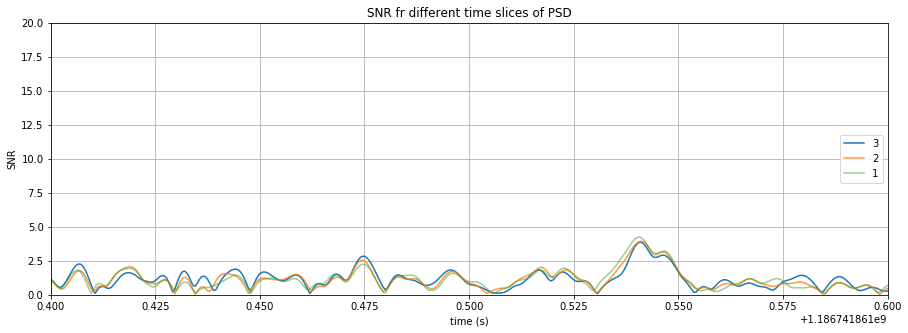

In [83]:
#zoom of the plot above
time_slices=[3,2,1]
alphas=[1,0.8,0.5]
psd=[]

ts=m.strain("V1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2, 2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)

cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR fr different time slices of PSD")
plt.grid()
plt.xlim(m.time-0.10, m.time+0.10)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0,0.5,'SNR')

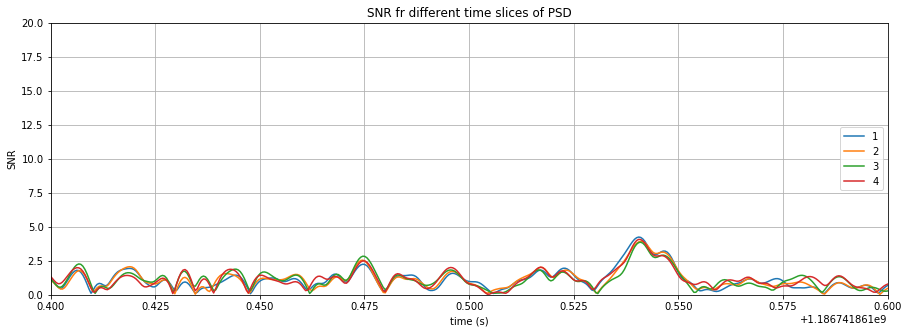

In [84]:

time_slices=[1,2,3,4]
alphas=[1,1,1,4]
psd=[]
ts=m.strain("V1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2, 2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)

cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR fr different time slices of PSD")
plt.grid()
plt.xlim(m.time-0.10, m.time+0.10)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0,0.5,'SNR')

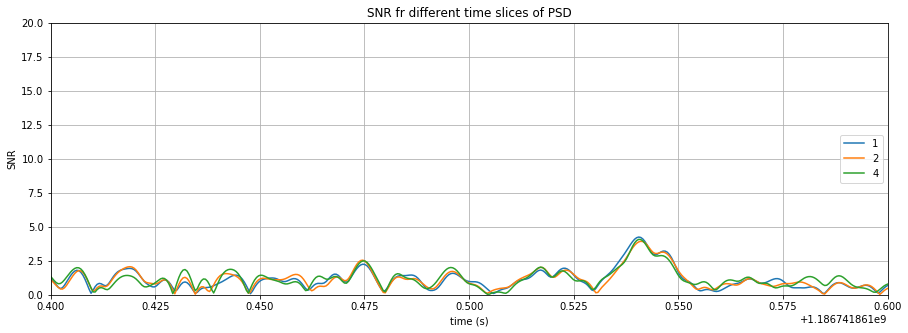

In [85]:
time_slices=[1,2,4]
alphas=[1,1,1]
psd=[]
ts=m.strain("V1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2, 2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)

cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR fr different time slices of PSD")
plt.grid()
plt.xlim(m.time-0.10, m.time+0.10)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0,0.5,'SNR')

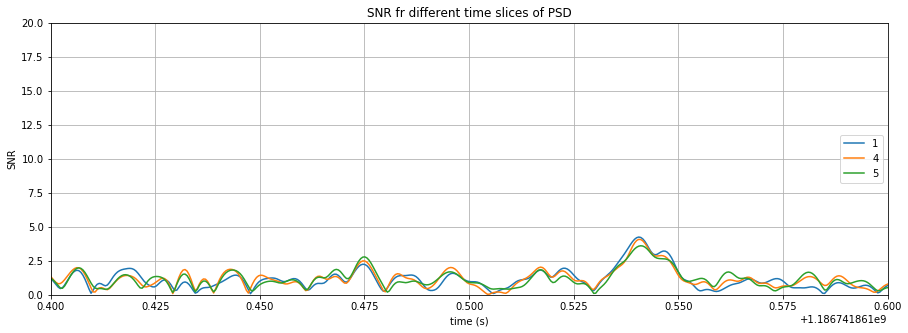

In [86]:
time_slices=[1,4,5]
alphas=[1,1,1]
psd=[]
ts=m.strain("V1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2, 2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)

cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR fr different time slices of PSD")
plt.grid()
plt.xlim(m.time-0.10, m.time+0.10)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0,0.5,'SNR')

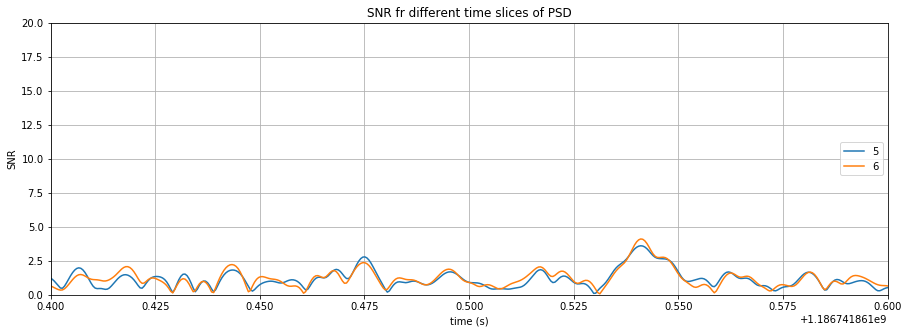

In [87]:
time_slices=[5,6]
alphas=[1,1]
psd=[]
ts=m.strain("V1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2, 2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)

cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR fr different time slices of PSD")
plt.grid()
plt.xlim(m.time-0.10, m.time+0.10)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0,0.5,'SNR')

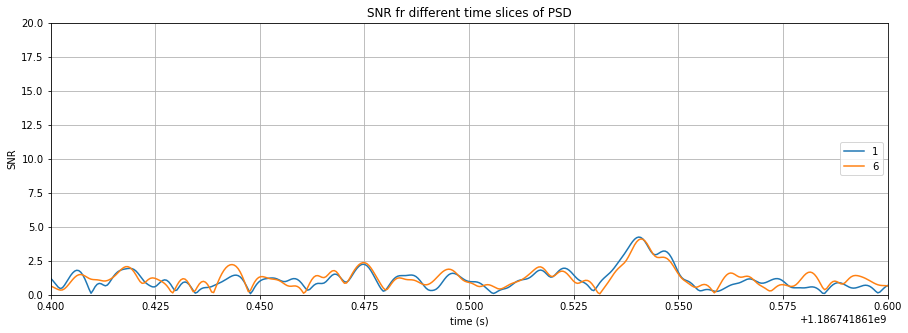

In [88]:
time_slices=[1,6]
alphas=[1,6]
psd=[]
ts=m.strain("V1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2, 2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)

cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR fr different time slices of PSD")
plt.grid()
plt.xlim(m.time-0.10, m.time+0.10)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0,0.5,'SNR')

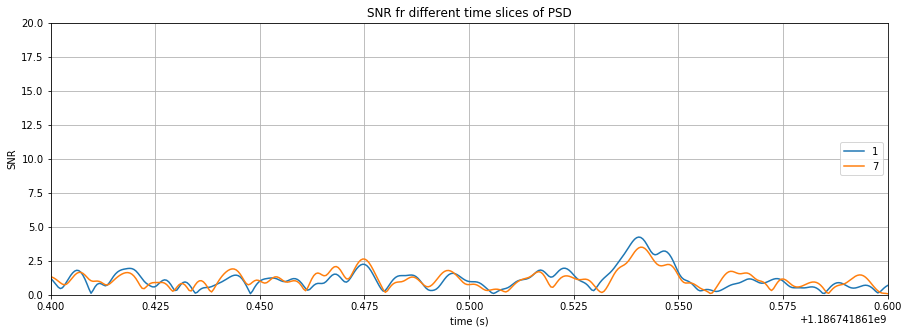

In [89]:
time_slices=[1,7]
alphas=[1,1]
psd=[]
ts=m.strain("V1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2, 2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)

cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR fr different time slices of PSD")
plt.grid()
plt.xlim(m.time-0.10, m.time+0.10)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0,0.5,'SNR')

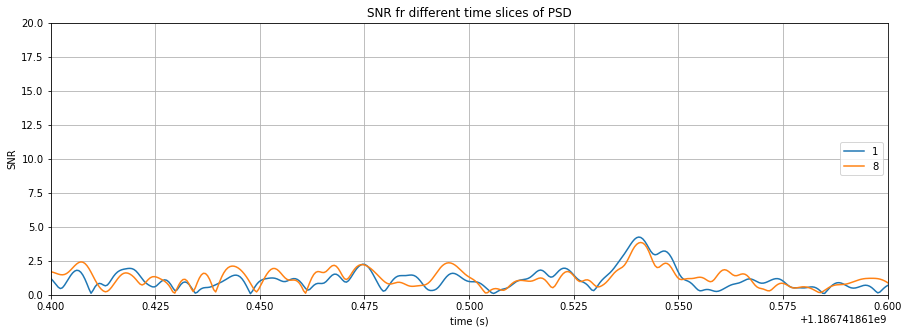

In [90]:
time_slices=[1,8]
alphas=[1,8]
psd=[]
ts=m.strain("V1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2, 2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)

cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR fr different time slices of PSD")
plt.grid()
plt.xlim(m.time-0.10, m.time+0.10)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0,0.5,'SNR')

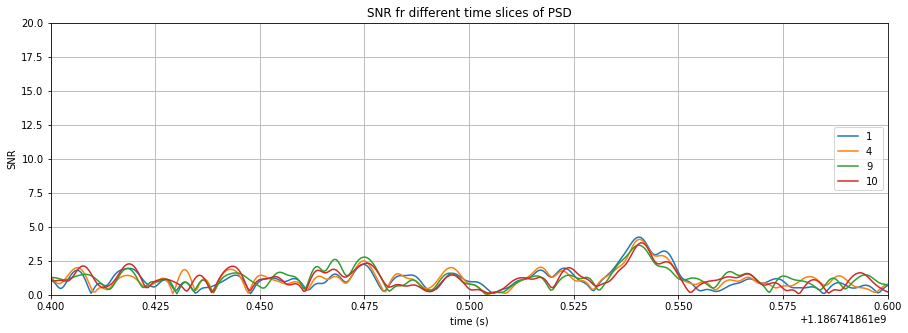

In [91]:
time_slices=[1,4,9,10]
alphas=[1,1,1,1]
psd=[]
ts=m.strain("V1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2, 2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)

cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR fr different time slices of PSD")
plt.grid()
plt.xlim(m.time-0.10, m.time+0.10)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0,0.5,'SNR')

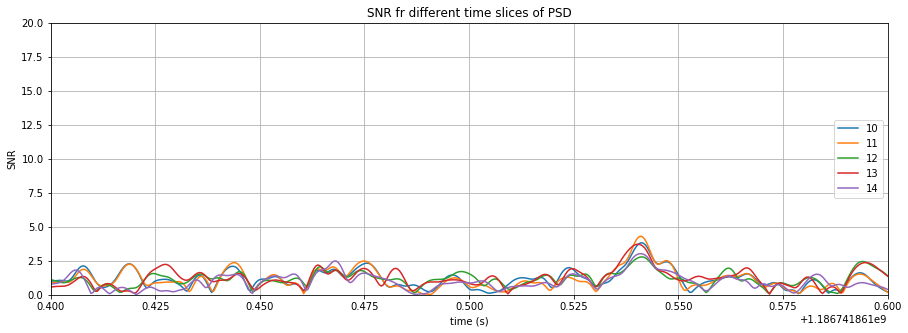

In [92]:
time_slices=[10,11,12,13,14]
alphas=[1,1,1,1,1]
psd=[]
ts=m.strain("V1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2, 2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)

cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR fr different time slices of PSD")
plt.grid()
plt.xlim(m.time-0.10, m.time+0.10)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0,0.5,'SNR')

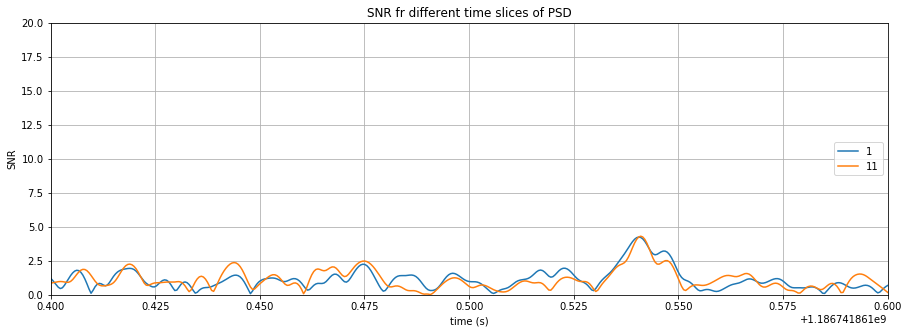

In [93]:
time_slices=[1,11]
alphas=[1,1]
psd=[]
ts=m.strain("V1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2, 2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)

cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR fr different time slices of PSD")
plt.grid()
plt.xlim(m.time-0.10, m.time+0.10)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0,0.5,'SNR')

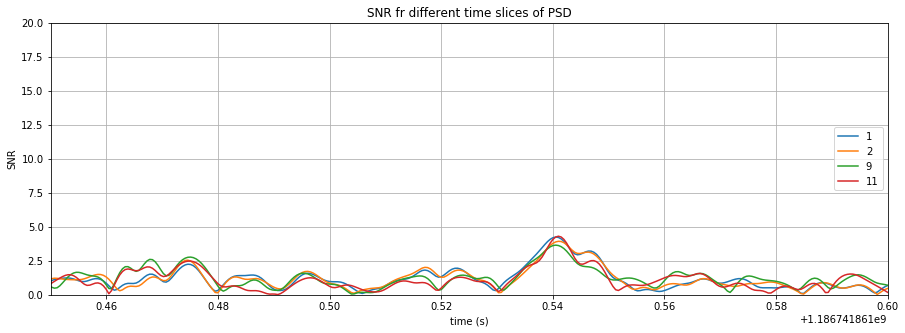

In [94]:
time_slices=[1,2,9,11]
alphas=[1,1,1,1]
psd=[]
ts=m.strain("V1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2, 2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)

cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR fr different time slices of PSD")
plt.grid()
plt.xlim(m.time-0.05, m.time+0.1)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 
#plt.axvline(x=m.time+0.041, color="red", alpha=0.5)

Text(0,0.5,'SNR')

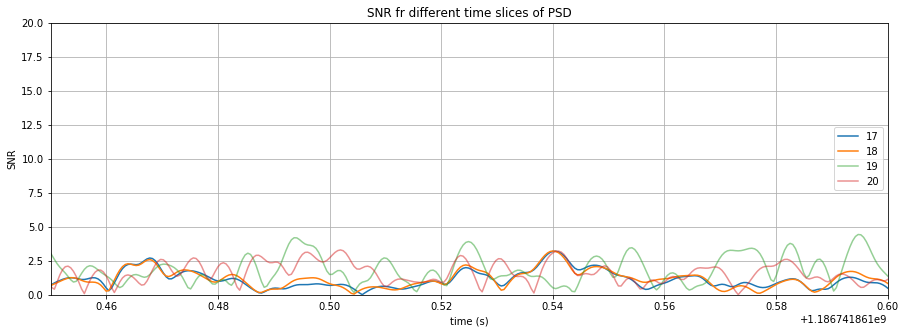

In [95]:
time_slices=[17,18,19,20]
alphas=[1,1,0.5,0.51]
psd=[]
ts=m.strain("V1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2, 2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)

cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR fr different time slices of PSD")
plt.grid()
plt.xlim(m.time-0.05, m.time+0.1)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

The treshold between both is still at 18. Above that, the SNR cannot anymore be distinguished from the rest. 

For the V1 detector, the maximum paak is not clear as 11 seconds works as well as the other cases. The different values and constation done here above should be done for different events in order to see if the evolutions are the same.

The goal here is to see if there is a difference for the optimal SNR depanding on the time slice for different events in a given detector. So, first, we see if there seems to be a difference between a BBH and a BNS merger. Then, we look for a lot of events in order to see if the 2 second time slice keeps on being the best in the case of the L1 detector. 

In [96]:
#first we look at the event that are disponible in the PyCBC library
from pycbc import catalog

### List the mergers in the catalog
for merger_name in catalog.Catalog():
    print(merger_name)

GW151012
GW170608
GW170729
GW150914
GW151226
GW170814
GW170817
GW170104
GW170809
GW170818
GW170823


In [97]:
m=catalog.Merger("GW150914")
print(m.median1d('mchirp'))

28.6


First, we look for the LIGO-Livingston data in the case of binary black holes in order to see if the PSD is much different. There could be a sensible difference between events of the first and the second run.

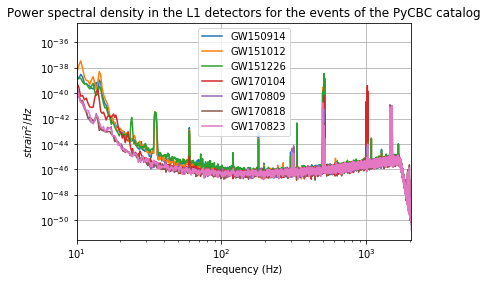

In [98]:
from pycbc.catalog import Merger
import matplotlib.pyplot as plt

events=["GW150914", "GW151012", "GW151226", "GW170104", "GW170809", "GW170818", "GW170823"]
mergers=[]
for i in range(len(events)):
    mergers.append(Merger(events[i]))
data=[]
for i in range(len(mergers)):
    data.append(mergers[i].strain("L1"))
    
for i in range(len(mergers)):
    psd=data[i].psd(3)
    plt.loglog(psd.sample_frequencies, psd, label=events[i])
plt.xlabel("Frequency (Hz)")
plt.ylabel("$strain^2/Hz$")
plt.xlim(10,2048)
plt.legend(loc="best")
plt.title("Power spectral density in the L1 detectors for the events of the PyCBC catalog")
plt.grid()


The psd shows that the noise is more important at lower frequencies in the case of the first run. This can be better seen by comparing the first detection evenr and the one of the second run. This is a consequence of the improvements that have been done in the LIGO detectors between both runs. It is not a consequence of the time slice or something like that. The modifications have also enabled to get rid of some peaks that were esent in the psd at specific frequencies. So, some noise sources have been deleted.

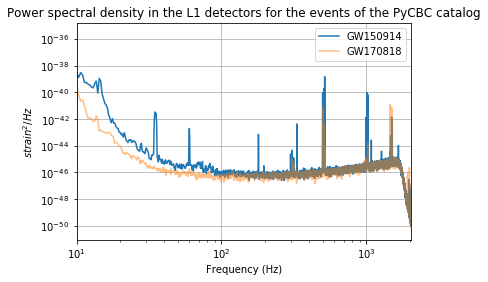

In [99]:
events=["GW150914", "GW170818"]
mergers=[]
for i in range(len(events)):
    mergers.append(Merger(events[i]))
data=[]
for i in range(len(mergers)):
    data.append(mergers[i].strain("L1"))
alphas=[1,0.5]  
for i in range(len(mergers)):
    psd=data[i].psd(3)
    plt.loglog(psd.sample_frequencies, psd, label=events[i], alpha=alphas[i])
plt.xlabel("Frequency (Hz)")
plt.ylabel("$strain^2/Hz$")
plt.xlim(10,2048)
plt.legend(loc="best")
plt.title("Power spectral density in the L1 detectors for the events of the PyCBC catalog")
plt.grid()


We try to look at the evolution of the PSD for different time slices in L1 for the different events. So, we make One plot for each and with different time slices.

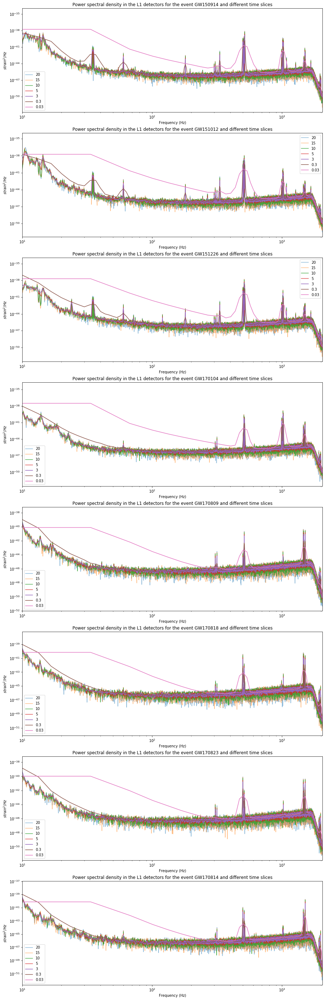

In [100]:
events=["GW150914", "GW151012", "GW151226", "GW170104", "GW170809", "GW170818", "GW170823", "GW170814"]
mergers=[]
time_slices=[20,15,10,5,3,0.3,0.03]
alphas=[0.5,0.5,0.8,0.8,1,1,1]
for i in range(len(events)):
    mergers.append(Merger(events[i]))
data=[]
for i in range(len(mergers)):
    data.append(mergers[i].strain("L1"))
N=len(events)   
f=plt.figure(figsize=[15,50])
ax=f.subplots(nrows=N)
for i in range(N):
    for j in range(len(time_slices)):
        psd=data[i].psd(time_slices[j])
        ax[i].loglog(psd.sample_frequencies, psd, label=time_slices[j], alpha=alphas[j])
    
    ax[i].set_xlabel("Frequency (Hz)")
    ax[i].set_ylabel("$strain^2/Hz$")
    ax[i].set_xlim(10,2048)
    ax[i].legend(loc="best")
    ax[i].set_title("Power spectral density in the L1 detectors for the event %s and different time slices" %events[i])
    plt.grid()    

Except for the difference in the lowest frequencies between the data from the first and the second run, there is no significant difference between the PSD for the different cases. 

We now compare the PSD for a black hole merging and for the binary neutron star case. Both are taken in the second run in order to avoid the difference for the lowest frequencies

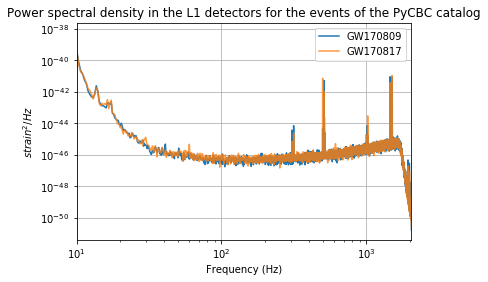

In [101]:
events=["GW170809", "GW170817"]
mergers=[]
for i in range(len(events)):
    mergers.append(Merger(events[i]))
data=[]
for i in range(len(mergers)):
    data.append(mergers[i].strain("L1"))
alphas=[1,0.8]  
for i in range(len(mergers)):
    psd=data[i].psd(3)
    plt.loglog(psd.sample_frequencies, psd, label=events[i], alpha=alphas[i])
plt.xlabel("Frequency (Hz)")
plt.ylabel("$strain^2/Hz$")
plt.xlim(10,2048)
plt.legend(loc="best")
plt.title("Power spectral density in the L1 detectors for the events of the PyCBC catalog")
plt.grid()


There is no significant difference

Now, we look at the SNR for the black hole mergers in the catalog for the L1 catalog. The goal is to see if 2 second time slice keeps on being the best time for all of them

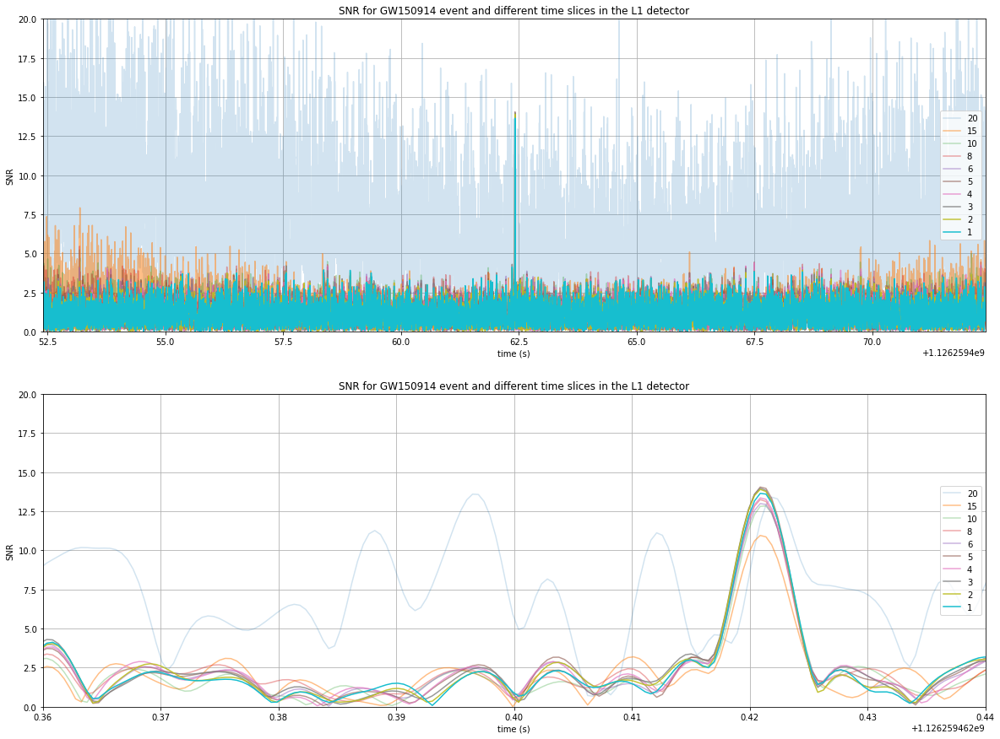

In [102]:
from pycbc.waveform import get_td_waveform, get_fd_waveform
from pycbc.filter import matched_filter
from pycbc.filter import resample_to_delta_t, highpass
from pycbc.catalog import Merger
from pycbc.psd import interpolate, inverse_spectrum_truncation

event="GW150914"
mergers=[]
time_slices=[20, 15, 10, 8, 6, 5, 4, 3, 2, 1]
alphas=[0.2, 0.5, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1, 1]
merger=Merger(event)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
data=merger.strain("L1").highpass_fir(15,512)
data=resample_to_delta_t(data, 1.0/2048).crop(2,2)
f=plt.figure(figsize=[20,15])
ax=f.subplots(nrows=2)
width=[10,0.04]
psds=[]

for i in range(2):
    for j in range(len(time_slices)):
        psd=data.psd(time_slices[j])
        psd=interpolate(psd, data.delta_f)
        psds.append(psd)
        hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
        hp.resize(len(psd))
        snr=matched_filter(hp, data, psd=psd, low_frequency_cutoff=20.)
        ax[i].plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    ax[i].legend(loc="right")
    ax[i].set_title("SNR for %s event and different time slices in the L1 detector" %event)
    ax[i].grid()
    ax[i].set_xlim(merger.time-width[i], merger.time+width[i])
    ax[i].set_ylim(0,20)
    ax[i].set_xlabel("time (s)")
    ax[i].set_ylabel("SNR") 
    

Above we see that the time slice of 20 seconds is still not usable for this event. 15 seconds is clearly below. Now, we look deeper in the smaller time slices in order to see if 2 is the best

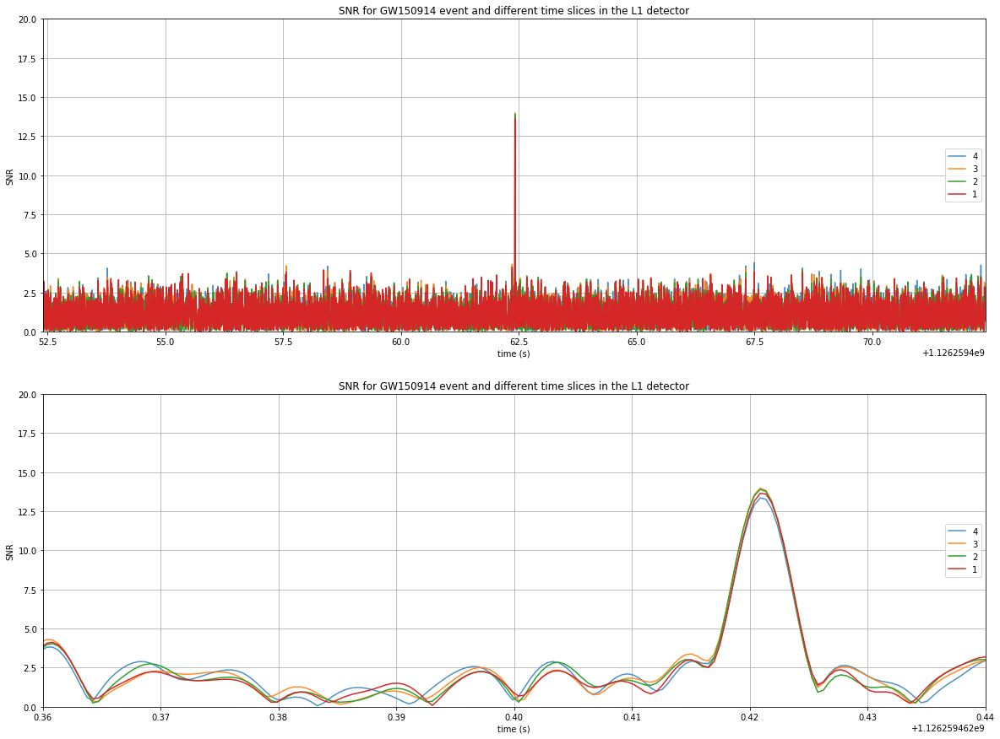

In [103]:
event="GW150914"
mergers=[]
time_slices=[ 4, 3, 2, 1]
alphas=[ 0.8, 0.9, 1, 1]
merger=Merger(event)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
data=merger.strain("L1").highpass_fir(15,512)
data=resample_to_delta_t(data, 1.0/2048).crop(2,2)
f=plt.figure(figsize=[20,15])
ax=f.subplots(nrows=2)
width=[10,0.04]
psds=[]

for i in range(2):
    for j in range(len(time_slices)):
        psd=data.psd(time_slices[j])
        psd=interpolate(psd, data.delta_f)
        psds.append(psd)
        hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
        hp.resize(len(psd))
        snr=matched_filter(hp, data, psd=psd, low_frequency_cutoff=20.)
        ax[i].plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    ax[i].legend(loc="right")
    ax[i].set_title("SNR for %s event and different time slices in the L1 detector" %event)
    ax[i].grid()
    ax[i].set_xlim(merger.time-width[i], merger.time+width[i])
    ax[i].set_ylim(0,20)
    ax[i].set_xlabel("time (s)")
    ax[i].set_ylabel("SNR") 
    

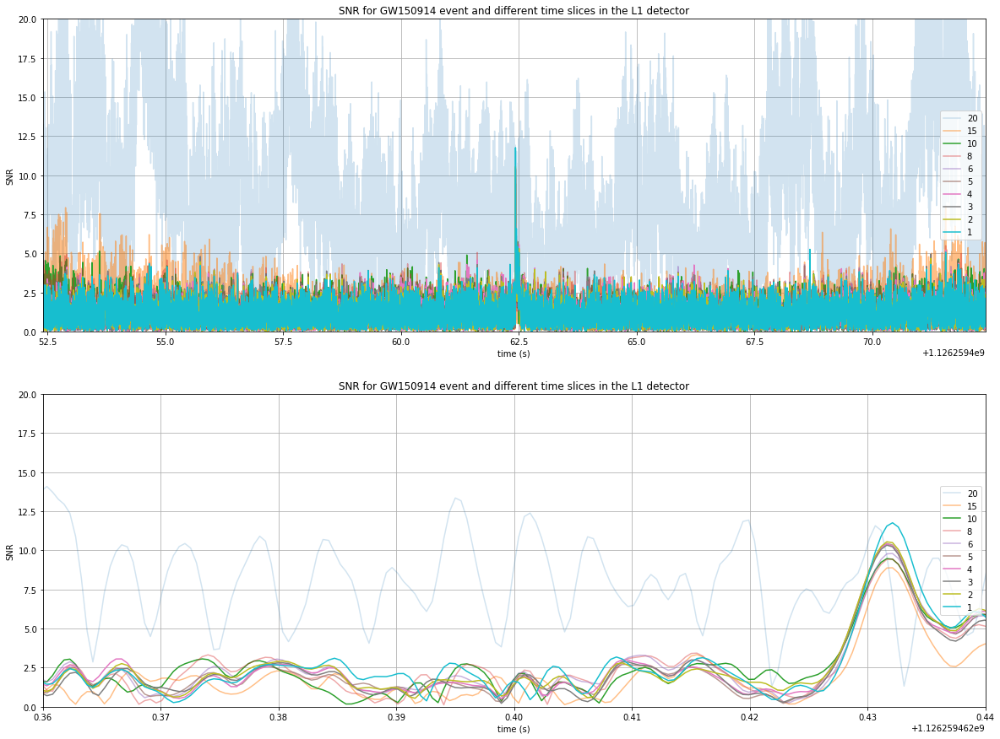

In [129]:
event="GW150914"
mergers=[]
time_slices=[20, 15, 10, 8, 6, 5, 4, 3, 2, 1]
alphas=[0.2, 0.5, 1, 0.4, 0.5, 0.6, 1, 1, 1, 1, 1]
merger=Merger(event)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
data=merger.strain("H1").highpass_fir(15,512)
data=resample_to_delta_t(data, 1.0/2048).crop(2,2)
f=plt.figure(figsize=[20,15])
ax=f.subplots(nrows=2)
width=[10,0.04]
psds=[]

for i in range(2):
    for j in range(len(time_slices)):
        psd=data.psd(time_slices[j])
        psd=interpolate(psd, data.delta_f)
        psds.append(psd)
        hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
        hp.resize(len(psd))
        snr=matched_filter(hp, data, psd=psd, low_frequency_cutoff=20.)
        ax[i].plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    ax[i].legend(loc="right")
    ax[i].set_title("SNR for %s event and different time slices in the L1 detector" %event)
    ax[i].grid()
    ax[i].set_xlim(merger.time-width[i], merger.time+width[i])
    ax[i].set_ylim(0,20)
    ax[i].set_xlabel("time (s)")
    ax[i].set_ylabel("SNR") 
    

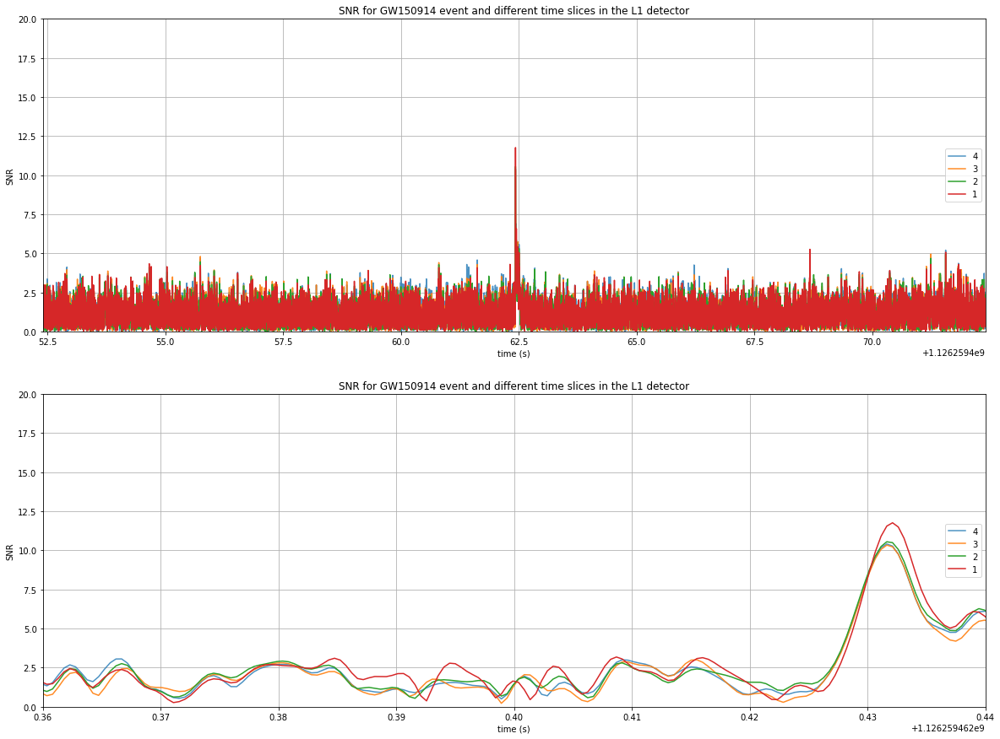

In [130]:
event="GW150914"
mergers=[]
time_slices=[ 4, 3, 2, 1]
alphas=[ 0.8, 0.9, 1, 1]
merger=Merger(event)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
data=merger.strain("H1").highpass_fir(15,512)
data=resample_to_delta_t(data, 1.0/2048).crop(2,2)
f=plt.figure(figsize=[20,15])
ax=f.subplots(nrows=2)
width=[10,0.04]
psds=[]

for i in range(2):
    for j in range(len(time_slices)):
        psd=data.psd(time_slices[j])
        psd=interpolate(psd, data.delta_f)
        psds.append(psd)
        hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
        hp.resize(len(psd))
        snr=matched_filter(hp, data, psd=psd, low_frequency_cutoff=20.)
        ax[i].plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    ax[i].legend(loc="right")
    ax[i].set_title("SNR for %s event and different time slices in the L1 detector" %event)
    ax[i].grid()
    ax[i].set_xlim(merger.time-width[i], merger.time+width[i])
    ax[i].set_ylim(0,20)
    ax[i].set_xlabel("time (s)")
    ax[i].set_ylabel("SNR") 
    

1 seems to be the highest but is not at the same times than the others. The bext one is 2 which is high but still a bit on the side

3 seems to be a bit above 2 but it is not significantly higher. 

Since the SNR is not as high for all the events, it is interesting to first do a classical analysis of the event in order to find the peak before really looking at the influenve of the time slice in the PSD on the SNR itself.

First, we look for GW151012

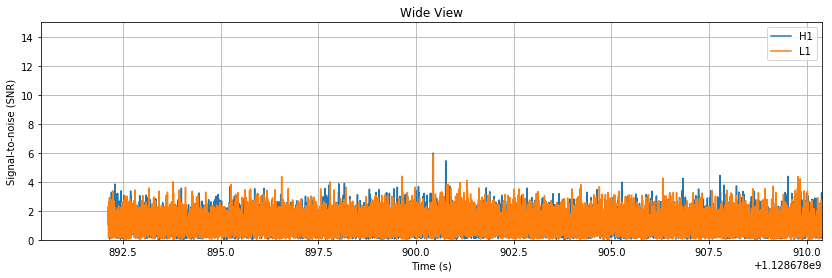

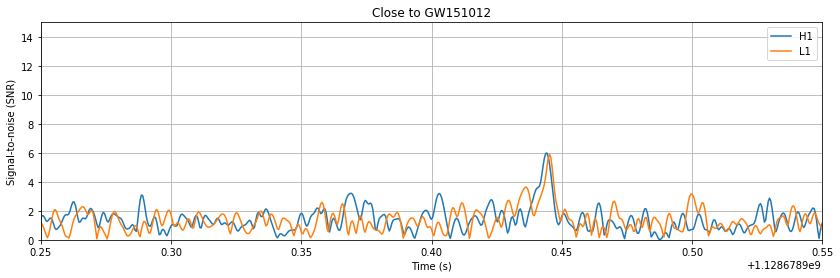

In [117]:
from pycbc.waveform import get_fd_waveform
from pycbc.filter import matched_filter
m = Merger("GW151012")

ifos = ['H1', 'L1']
data = {}
psd = {}


for ifo in ifos:
    # Read in and precondition the data
    ts = m.strain(ifo).highpass_fir(15, 512)
    data[ifo] = resample_to_delta_t(ts, 1.0/2048).crop(2, 2)

    # Estimate the power spectral density of the data
    # This chooses to use 2s samples in the PSD estimate.
    # One should note that the tradeoff in segment length is that
    # resolving narrow lines becomes more difficult.
    p = data[ifo].psd(2)
    p = interpolate(p, data[ifo].delta_f)
    p = inverse_spectrum_truncation(p, 2 * data[ifo].sample_rate, low_frequency_cutoff=15.0)
    psd[ifo] = p

cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data[ifo].delta_f)
hp.resize(len(psd[ifo]))
# For each observatory use this template to calculate the SNR time series
snr = {}
for ifo in ifos:
    snr[ifo] = matched_filter(hp, data[ifo], psd=psd[ifo], low_frequency_cutoff=20)
    snr[ifo] = snr[ifo].crop(5, 4)
for w, title in [(10, 'Wide View'), (.15, 'Close to GW151012')]:
    plt.figure(figsize=[14, 4])
    for ifo in ifos:
        plt.plot(snr[ifo].sample_times, abs(snr[ifo]), label=ifo)

    plt.legend()
    plt.title(title)
    plt.grid()
    plt.xlim(m.time - w, m.time + w)
    plt.ylim(0, 15)
    plt.xlabel('Time (s)')
    plt.ylabel('Signal-to-noise (SNR)')

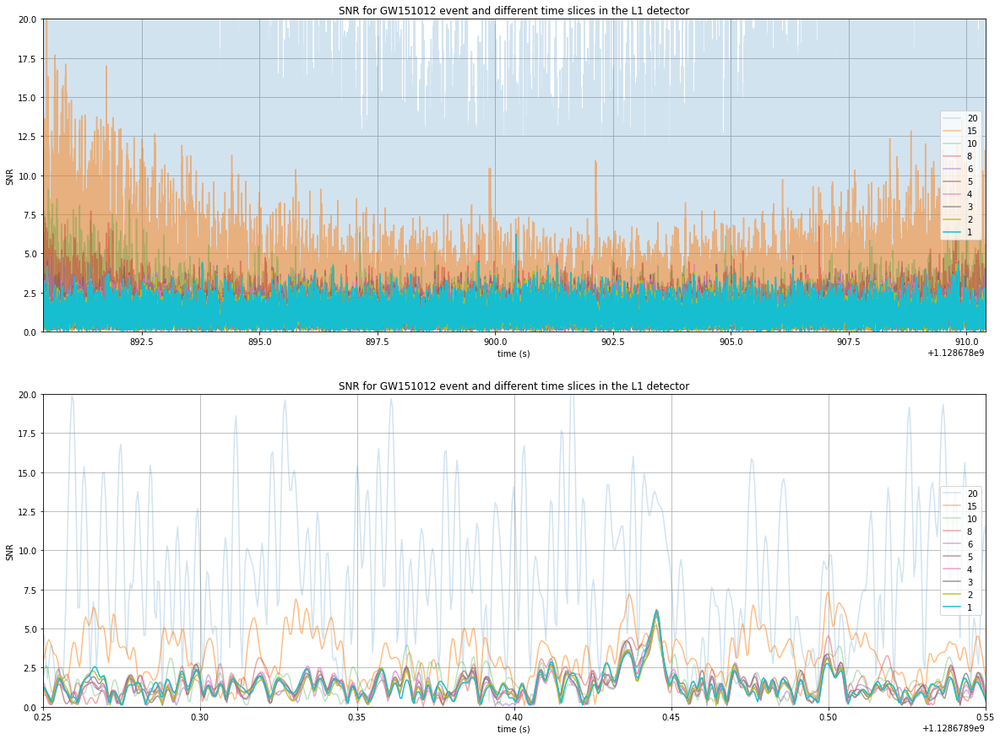

In [120]:
event="GW151012"
mergers=[]
time_slices=[20, 15, 10, 8, 6, 5, 4, 3, 2, 1]
alphas=[0.2, 0.5, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1, 1]
merger=Merger(event)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
data=merger.strain("L1").highpass_fir(15,512)
data=resample_to_delta_t(data, 1.0/2048).crop(2,2)
f=plt.figure(figsize=[20,15])
ax=f.subplots(nrows=2)
width=[10,0.15]
psds=[]

for i in range(2):
    for j in range(len(time_slices)):
        psd=data.psd(time_slices[j])
        psd=interpolate(psd, data.delta_f)
        psds.append(psd)
        hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
        hp.resize(len(psd))
        snr=matched_filter(hp, data, psd=psd, low_frequency_cutoff=20.)
        ax[i].plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    ax[i].legend(loc="right")
    ax[i].set_title("SNR for %s event and different time slices in the L1 detector" %event)
    ax[i].grid()
    ax[i].set_xlim(merger.time-width[i], merger.time+width[i])
    ax[i].set_ylim(0,20)
    ax[i].set_xlabel("time (s)")
    ax[i].set_ylabel("SNR") 
    

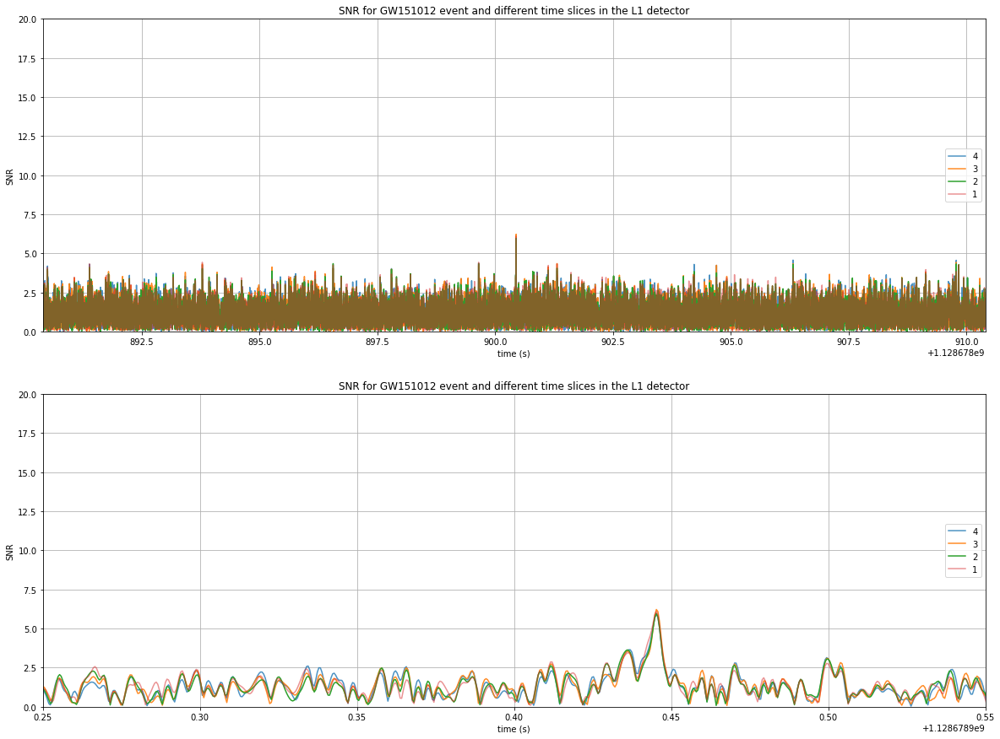

In [122]:
event="GW151012"
mergers=[]
time_slices=[ 4, 3, 2, 1]
alphas=[ 0.8, 0.9, 1, 0.5]
merger=Merger(event)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
data=merger.strain("L1").highpass_fir(15,512)
data=resample_to_delta_t(data, 1.0/2048).crop(2,2)
f=plt.figure(figsize=[20,15])
ax=f.subplots(nrows=2)
width=[10,0.15]
psds=[]

for i in range(2):
    for j in range(len(time_slices)):
        psd=data.psd(time_slices[j])
        psd=interpolate(psd, data.delta_f)
        psds.append(psd)
        hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
        hp.resize(len(psd))
        snr=matched_filter(hp, data, psd=psd, low_frequency_cutoff=20.)
        ax[i].plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    ax[i].legend(loc="right")
    ax[i].set_title("SNR for %s event and different time slices in the L1 detector" %event)
    ax[i].grid()
    ax[i].set_xlim(merger.time-width[i], merger.time+width[i])
    ax[i].set_ylim(0,20)
    ax[i].set_xlabel("time (s)")
    ax[i].set_ylabel("SNR") 
    

for the event GW151012 3seconds seems above for L1
Now we test for H1

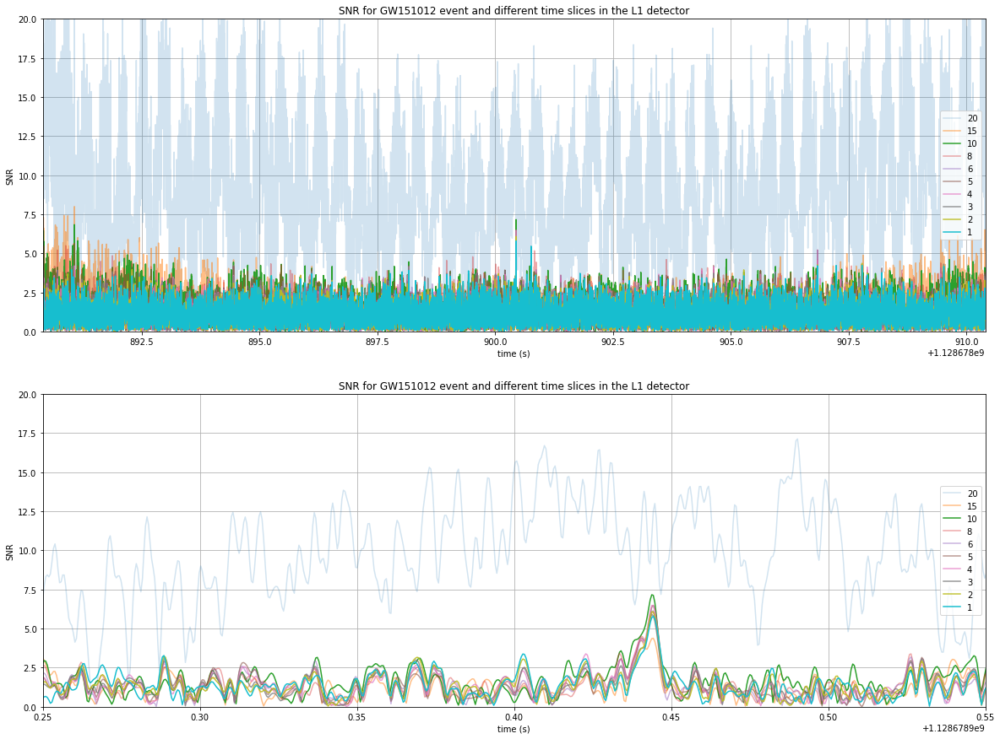

In [124]:
event="GW151012"
mergers=[]
time_slices=[20, 15, 10, 8, 6, 5, 4, 3, 2, 1]
alphas=[0.2, 0.5, 1, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1, 1]
merger=Merger(event)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
data=merger.strain("H1").highpass_fir(15,512)
data=resample_to_delta_t(data, 1.0/2048).crop(2,2)
f=plt.figure(figsize=[20,15])
ax=f.subplots(nrows=2)
width=[10,0.15]
psds=[]

for i in range(2):
    for j in range(len(time_slices)):
        psd=data.psd(time_slices[j])
        psd=interpolate(psd, data.delta_f)
        psds.append(psd)
        hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
        hp.resize(len(psd))
        snr=matched_filter(hp, data, psd=psd, low_frequency_cutoff=20.)
        ax[i].plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    ax[i].legend(loc="right")
    ax[i].set_title("SNR for %s event and different time slices in the H1 detector" %event)
    ax[i].grid()
    ax[i].set_xlim(merger.time-width[i], merger.time+width[i])
    ax[i].set_ylim(0,20)
    ax[i].set_xlabel("time (s)")
    ax[i].set_ylabel("SNR") 
    

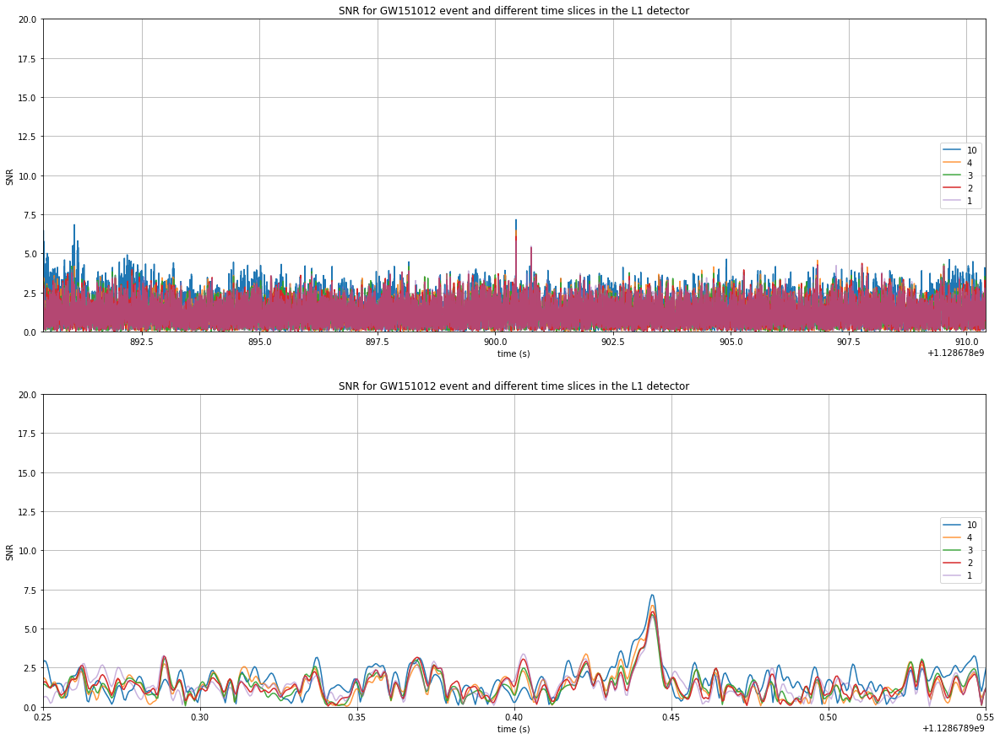

In [126]:
event="GW151012"
mergers=[]
time_slices=[ 10,4, 3, 2, 1]
alphas=[ 1,0.8, 0.9, 1, 0.5]
merger=Merger(event)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
data=merger.strain("H1").highpass_fir(15,512)
data=resample_to_delta_t(data, 1.0/2048).crop(2,2)
f=plt.figure(figsize=[20,15])
ax=f.subplots(nrows=2)
width=[10,0.15]
psds=[]

for i in range(2):
    for j in range(len(time_slices)):
        psd=data.psd(time_slices[j])
        psd=interpolate(psd, data.delta_f)
        psds.append(psd)
        hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
        hp.resize(len(psd))
        snr=matched_filter(hp, data, psd=psd, low_frequency_cutoff=20.)
        ax[i].plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    ax[i].legend(loc="right")
    ax[i].set_title("SNR for %s event and different time slices in the H1 detector" %event)
    ax[i].grid()
    ax[i].set_xlim(merger.time-width[i], merger.time+width[i])
    ax[i].set_ylim(0,20)
    ax[i].set_xlabel("time (s)")
    ax[i].set_ylabel("SNR") 
    

We look for the event GW151226

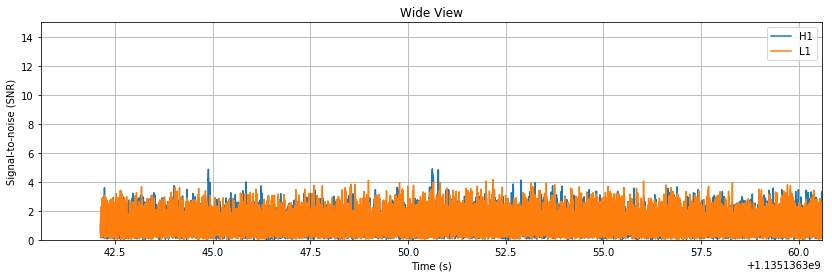

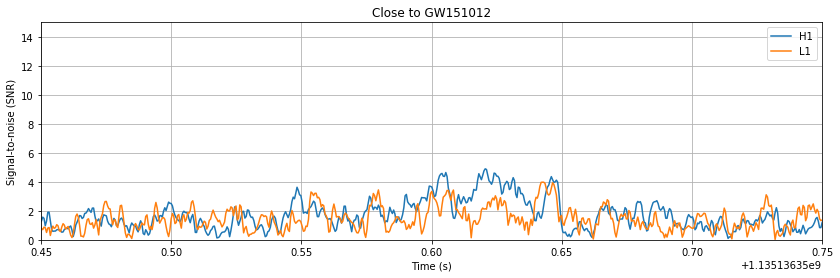

In [131]:
m = Merger("GW151226")

ifos = ['H1', 'L1']
data = {}
psd = {}


for ifo in ifos:
    # Read in and precondition the data
    ts = m.strain(ifo).highpass_fir(15, 512)
    data[ifo] = resample_to_delta_t(ts, 1.0/2048).crop(2, 2)

    # Estimate the power spectral density of the data
    # This chooses to use 2s samples in the PSD estimate.
    # One should note that the tradeoff in segment length is that
    # resolving narrow lines becomes more difficult.
    p = data[ifo].psd(2)
    p = interpolate(p, data[ifo].delta_f)
    p = inverse_spectrum_truncation(p, 2 * data[ifo].sample_rate, low_frequency_cutoff=15.0)
    psd[ifo] = p

cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data[ifo].delta_f)
hp.resize(len(psd[ifo]))
# For each observatory use this template to calculate the SNR time series
snr = {}
for ifo in ifos:
    snr[ifo] = matched_filter(hp, data[ifo], psd=psd[ifo], low_frequency_cutoff=20)
    snr[ifo] = snr[ifo].crop(5, 4)
for w, title in [(10, 'Wide View'), (.15, 'Close to GW151012')]:
    plt.figure(figsize=[14, 4])
    for ifo in ifos:
        plt.plot(snr[ifo].sample_times, abs(snr[ifo]), label=ifo)

    plt.legend()
    plt.title(title)
    plt.grid()
    plt.xlim(m.time - w, m.time + w)
    plt.ylim(0, 15)
    plt.xlabel('Time (s)')
    plt.ylabel('Signal-to-noise (SNR)')

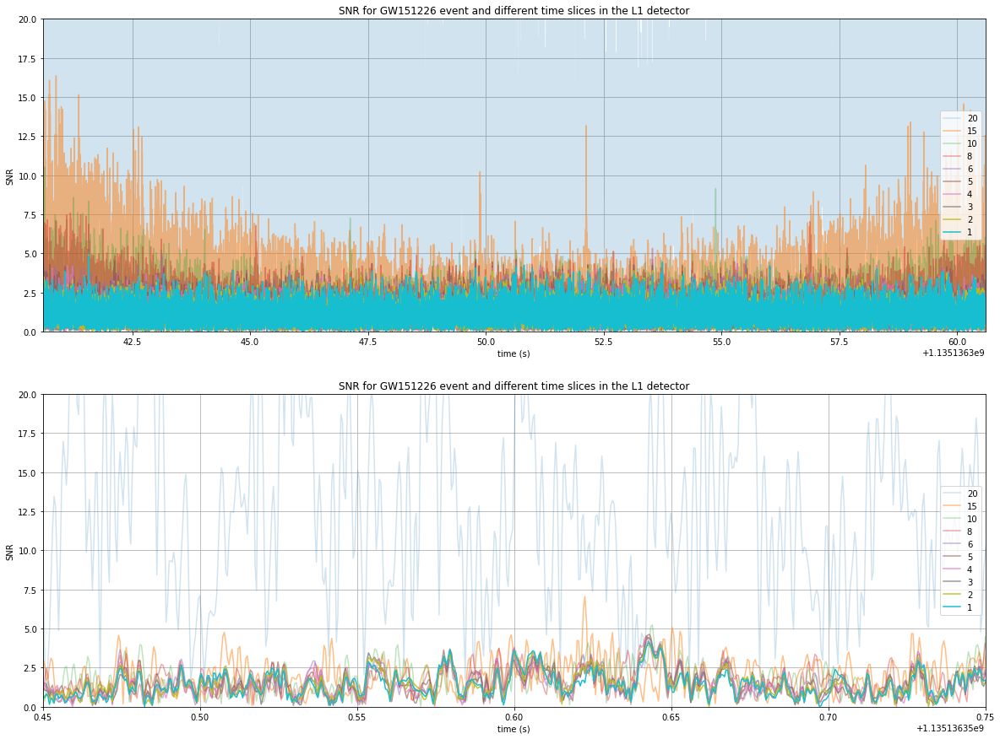

In [132]:
event="GW151226"
mergers=[]
time_slices=[20, 15, 10, 8, 6, 5, 4, 3, 2, 1]
alphas=[0.2, 0.5, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1, 1]
merger=Merger(event)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
data=merger.strain("L1").highpass_fir(15,512)
data=resample_to_delta_t(data, 1.0/2048).crop(2,2)
f=plt.figure(figsize=[20,15])
ax=f.subplots(nrows=2)
width=[10,0.15]
psds=[]

for i in range(2):
    for j in range(len(time_slices)):
        psd=data.psd(time_slices[j])
        psd=interpolate(psd, data.delta_f)
        psds.append(psd)
        hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
        hp.resize(len(psd))
        snr=matched_filter(hp, data, psd=psd, low_frequency_cutoff=20.)
        ax[i].plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    ax[i].legend(loc="right")
    ax[i].set_title("SNR for %s event and different time slices in the L1 detector" %event)
    ax[i].grid()
    ax[i].set_xlim(merger.time-width[i], merger.time+width[i])
    ax[i].set_ylim(0,20)
    ax[i].set_xlabel("time (s)")
    ax[i].set_ylabel("SNR") 
    

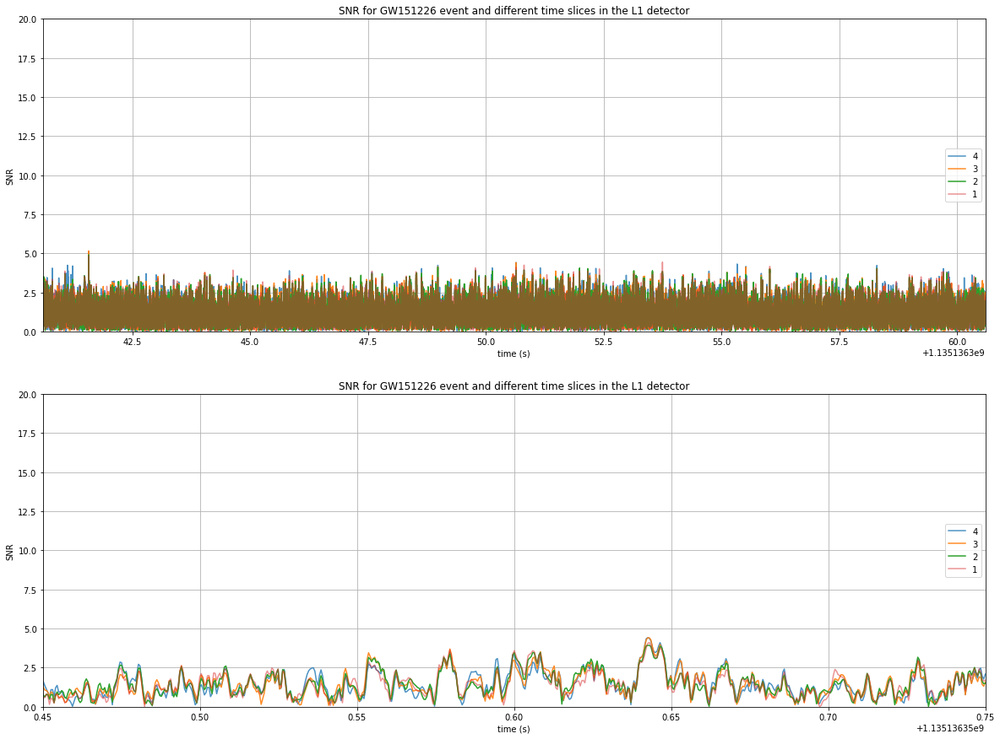

In [133]:
event="GW151226"
mergers=[]
time_slices=[ 4, 3, 2, 1]
alphas=[ 0.8, 0.9, 1, 0.5]
merger=Merger(event)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
data=merger.strain("L1").highpass_fir(15,512)
data=resample_to_delta_t(data, 1.0/2048).crop(2,2)
f=plt.figure(figsize=[20,15])
ax=f.subplots(nrows=2)
width=[10,0.15]
psds=[]

for i in range(2):
    for j in range(len(time_slices)):
        psd=data.psd(time_slices[j])
        psd=interpolate(psd, data.delta_f)
        psds.append(psd)
        hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
        hp.resize(len(psd))
        snr=matched_filter(hp, data, psd=psd, low_frequency_cutoff=20.)
        ax[i].plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    ax[i].legend(loc="right")
    ax[i].set_title("SNR for %s event and different time slices in the L1 detector" %event)
    ax[i].grid()
    ax[i].set_xlim(merger.time-width[i], merger.time+width[i])
    ax[i].set_ylim(0,20)
    ax[i].set_xlabel("time (s)")
    ax[i].set_ylabel("SNR") 
    

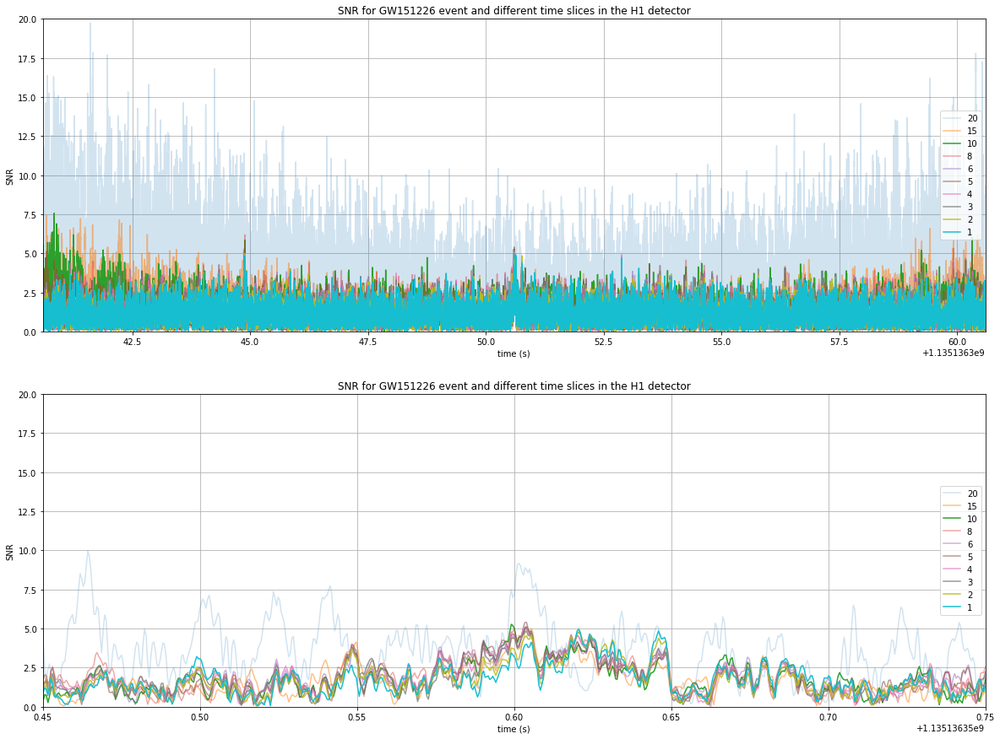

In [134]:
event="GW151226"
mergers=[]
time_slices=[20, 15, 10, 8, 6, 5, 4, 3, 2, 1]
alphas=[0.2, 0.5, 1, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1, 1]
merger=Merger(event)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
data=merger.strain("H1").highpass_fir(15,512)
data=resample_to_delta_t(data, 1.0/2048).crop(2,2)
f=plt.figure(figsize=[20,15])
ax=f.subplots(nrows=2)
width=[10,0.15]
psds=[]

for i in range(2):
    for j in range(len(time_slices)):
        psd=data.psd(time_slices[j])
        psd=interpolate(psd, data.delta_f)
        psds.append(psd)
        hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
        hp.resize(len(psd))
        snr=matched_filter(hp, data, psd=psd, low_frequency_cutoff=20.)
        ax[i].plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    ax[i].legend(loc="right")
    ax[i].set_title("SNR for %s event and different time slices in the H1 detector" %event)
    ax[i].grid()
    ax[i].set_xlim(merger.time-width[i], merger.time+width[i])
    ax[i].set_ylim(0,20)
    ax[i].set_xlabel("time (s)")
    ax[i].set_ylabel("SNR") 
    

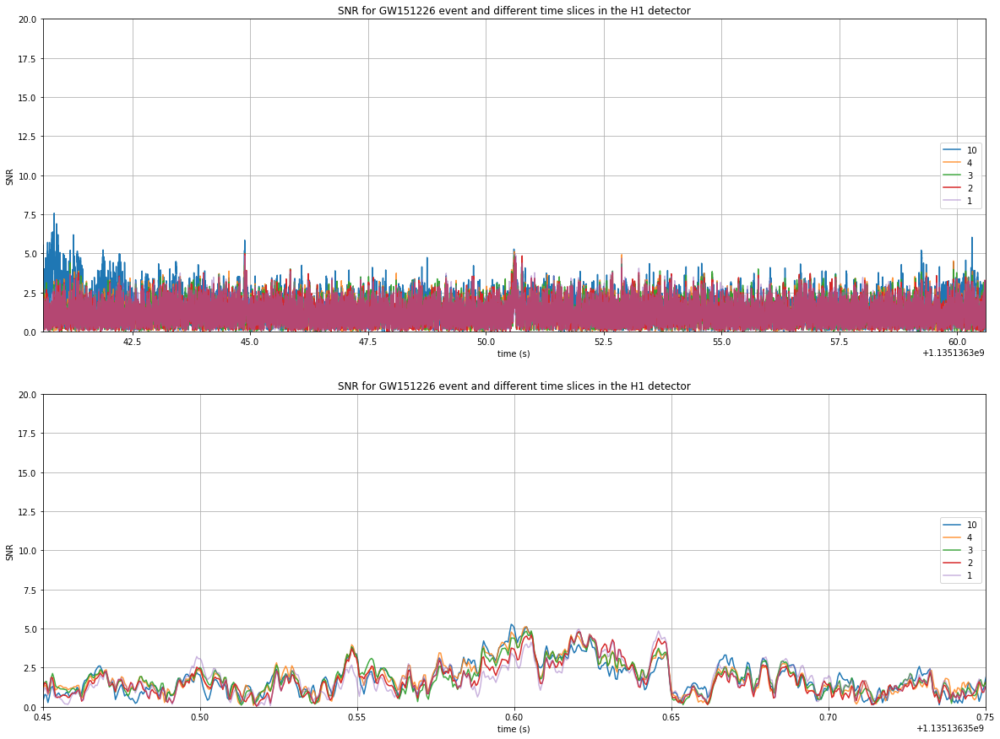

In [135]:
event="GW151226"
mergers=[]
time_slices=[ 10,4, 3, 2, 1]
alphas=[ 1,0.8, 0.9, 1, 0.5]
merger=Merger(event)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
data=merger.strain("H1").highpass_fir(15,512)
data=resample_to_delta_t(data, 1.0/2048).crop(2,2)
f=plt.figure(figsize=[20,15])
ax=f.subplots(nrows=2)
width=[10,0.15]
psds=[]

for i in range(2):
    for j in range(len(time_slices)):
        psd=data.psd(time_slices[j])
        psd=interpolate(psd, data.delta_f)
        psds.append(psd)
        hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
        hp.resize(len(psd))
        snr=matched_filter(hp, data, psd=psd, low_frequency_cutoff=20.)
        ax[i].plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    ax[i].legend(loc="right")
    ax[i].set_title("SNR for %s event and different time slices in the H1 detector" %event)
    ax[i].grid()
    ax[i].set_xlim(merger.time-width[i], merger.time+width[i])
    ax[i].set_ylim(0,20)
    ax[i].set_xlabel("time (s)")
    ax[i].set_ylabel("SNR") 
    

Non conclusions possible for this event. The peak is not seeable enough, the signal is too blurry and full of peaks.

Next analysis is for event GW170608

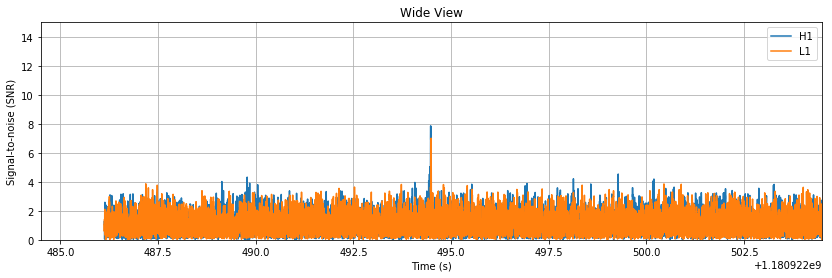

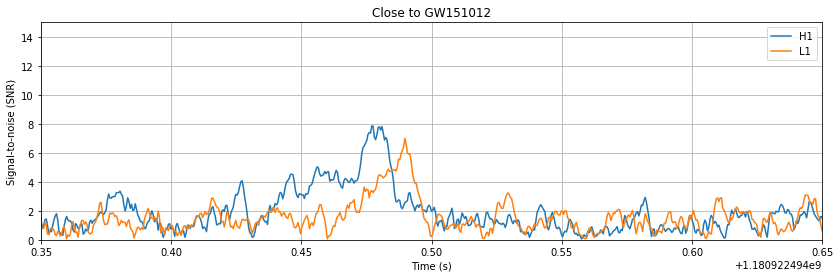

In [136]:
m = Merger("GW170608")

ifos = ['H1', 'L1']
data = {}
psd = {}


for ifo in ifos:
    # Read in and precondition the data
    ts = m.strain(ifo).highpass_fir(15, 512)
    data[ifo] = resample_to_delta_t(ts, 1.0/2048).crop(2, 2)

    # Estimate the power spectral density of the data
    # This chooses to use 2s samples in the PSD estimate.
    # One should note that the tradeoff in segment length is that
    # resolving narrow lines becomes more difficult.
    p = data[ifo].psd(2)
    p = interpolate(p, data[ifo].delta_f)
    p = inverse_spectrum_truncation(p, 2 * data[ifo].sample_rate, low_frequency_cutoff=15.0)
    psd[ifo] = p

cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data[ifo].delta_f)
hp.resize(len(psd[ifo]))
# For each observatory use this template to calculate the SNR time series
snr = {}
for ifo in ifos:
    snr[ifo] = matched_filter(hp, data[ifo], psd=psd[ifo], low_frequency_cutoff=20)
    snr[ifo] = snr[ifo].crop(5, 4)
for w, title in [(10, 'Wide View'), (.15, 'Close to GW151012')]:
    plt.figure(figsize=[14, 4])
    for ifo in ifos:
        plt.plot(snr[ifo].sample_times, abs(snr[ifo]), label=ifo)

    plt.legend()
    plt.title(title)
    plt.grid()
    plt.xlim(m.time - w, m.time + w)
    plt.ylim(0, 15)
    plt.xlabel('Time (s)')
    plt.ylabel('Signal-to-noise (SNR)')

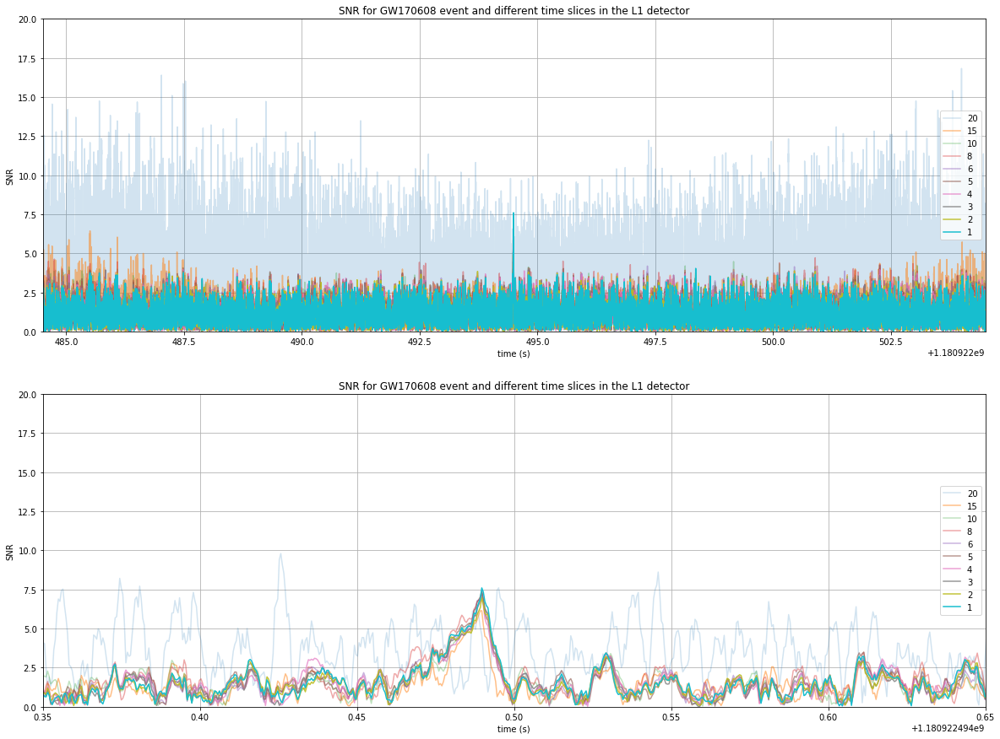

In [137]:
event="GW170608"
mergers=[]
time_slices=[20, 15, 10, 8, 6, 5, 4, 3, 2, 1]
alphas=[0.2, 0.5, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1, 1]
merger=Merger(event)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
data=merger.strain("L1").highpass_fir(15,512)
data=resample_to_delta_t(data, 1.0/2048).crop(2,2)
f=plt.figure(figsize=[20,15])
ax=f.subplots(nrows=2)
width=[10,0.15]
psds=[]

for i in range(2):
    for j in range(len(time_slices)):
        psd=data.psd(time_slices[j])
        psd=interpolate(psd, data.delta_f)
        psds.append(psd)
        hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
        hp.resize(len(psd))
        snr=matched_filter(hp, data, psd=psd, low_frequency_cutoff=20.)
        ax[i].plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    ax[i].legend(loc="right")
    ax[i].set_title("SNR for %s event and different time slices in the L1 detector" %event)
    ax[i].grid()
    ax[i].set_xlim(merger.time-width[i], merger.time+width[i])
    ax[i].set_ylim(0,20)
    ax[i].set_xlabel("time (s)")
    ax[i].set_ylabel("SNR") 
    

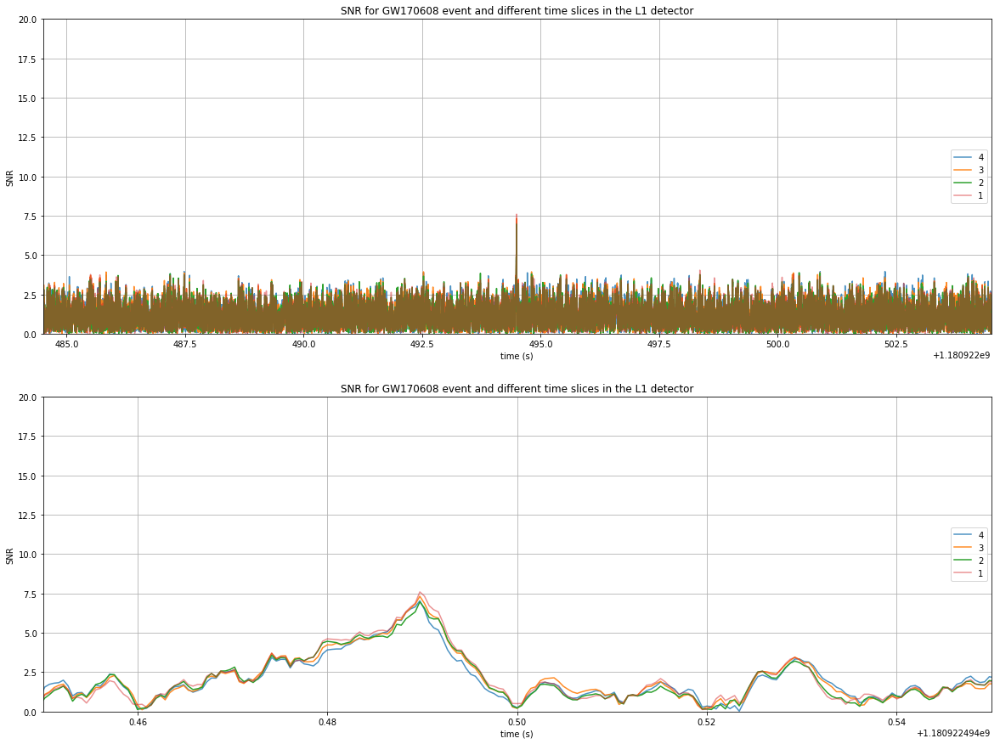

In [139]:
event="GW170608"
mergers=[]
time_slices=[ 4, 3, 2, 1]
alphas=[ 0.8, 0.9, 1, 0.5]
merger=Merger(event)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
data=merger.strain("L1").highpass_fir(15,512)
data=resample_to_delta_t(data, 1.0/2048).crop(2,2)
f=plt.figure(figsize=[20,15])
ax=f.subplots(nrows=2)
width=[10,0.05]
psds=[]

for i in range(2):
    for j in range(len(time_slices)):
        psd=data.psd(time_slices[j])
        psd=interpolate(psd, data.delta_f)
        psds.append(psd)
        hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
        hp.resize(len(psd))
        snr=matched_filter(hp, data, psd=psd, low_frequency_cutoff=20.)
        ax[i].plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    ax[i].legend(loc="right")
    ax[i].set_title("SNR for %s event and different time slices in the L1 detector" %event)
    ax[i].grid()
    ax[i].set_xlim(merger.time-width[i], merger.time+width[i])
    ax[i].set_ylim(0,20)
    ax[i].set_xlabel("time (s)")
    ax[i].set_ylabel("SNR") 
    

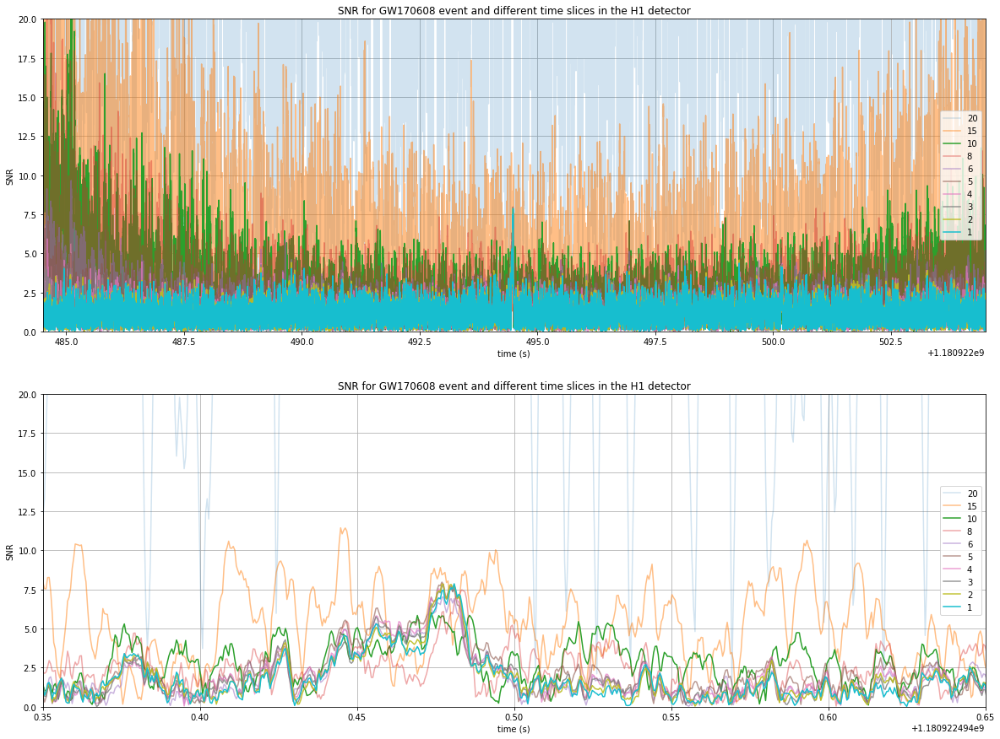

In [141]:
event="GW170608"
mergers=[]
time_slices=[20, 15, 10, 8, 6, 5, 4, 3, 2, 1]
alphas=[0.2, 0.5, 1, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1, 1]
merger=Merger(event)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
data=merger.strain("H1").highpass_fir(15,512)
data=resample_to_delta_t(data, 1.0/2048).crop(2,2)
f=plt.figure(figsize=[20,15])
ax=f.subplots(nrows=2)
width=[10,0.15]
psds=[]

for i in range(2):
    for j in range(len(time_slices)):
        psd=data.psd(time_slices[j])
        psd=interpolate(psd, data.delta_f)
        psds.append(psd)
        hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
        hp.resize(len(psd))
        snr=matched_filter(hp, data, psd=psd, low_frequency_cutoff=20.)
        ax[i].plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    ax[i].legend(loc="right")
    ax[i].set_title("SNR for %s event and different time slices in the H1 detector" %event)
    ax[i].grid()
    ax[i].set_xlim(merger.time-width[i], merger.time+width[i])
    ax[i].set_ylim(0,20)
    ax[i].set_xlabel("time (s)")
    ax[i].set_ylabel("SNR") 
    

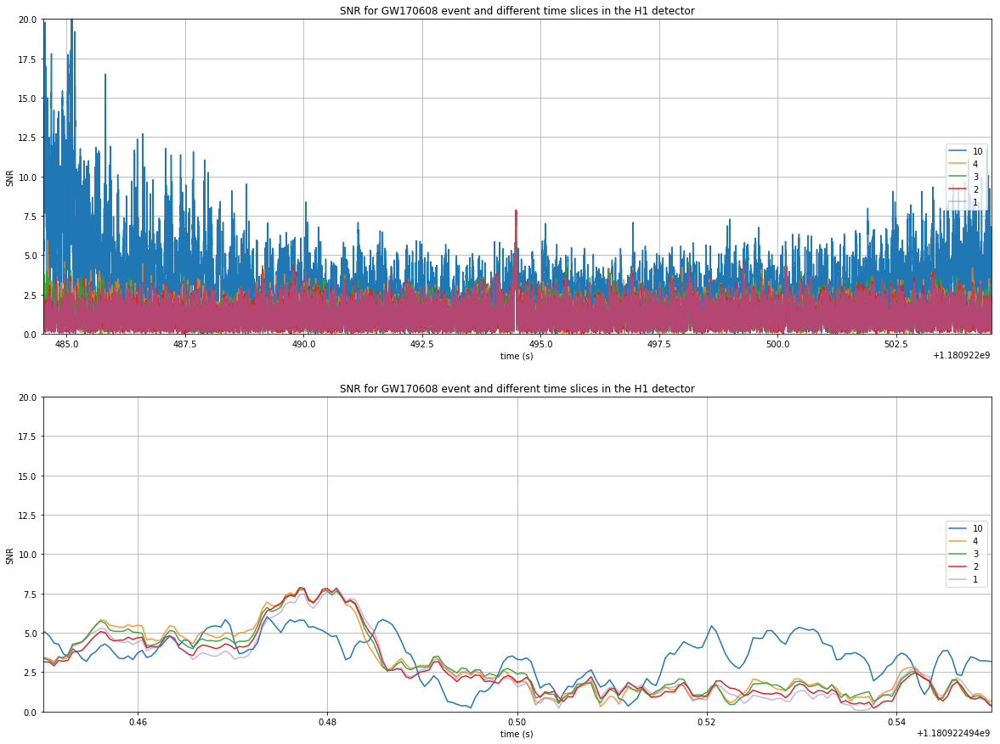

In [143]:
event="GW170608"
mergers=[]
time_slices=[ 10,4, 3, 2, 1]
alphas=[ 1,0.8, 0.9, 1, 0.5]
merger=Merger(event)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
data=merger.strain("H1").highpass_fir(15,512)
data=resample_to_delta_t(data, 1.0/2048).crop(2,2)
f=plt.figure(figsize=[20,15])
ax=f.subplots(nrows=2)
width=[10,0.05]
psds=[]

for i in range(2):
    for j in range(len(time_slices)):
        psd=data.psd(time_slices[j])
        psd=interpolate(psd, data.delta_f)
        psds.append(psd)
        hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
        hp.resize(len(psd))
        snr=matched_filter(hp, data, psd=psd, low_frequency_cutoff=20.)
        ax[i].plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    ax[i].legend(loc="right")
    ax[i].set_title("SNR for %s event and different time slices in the H1 detector" %event)
    ax[i].grid()
    ax[i].set_xlim(merger.time-width[i], merger.time+width[i])
    ax[i].set_ylim(0,20)
    ax[i].set_xlabel("time (s)")
    ax[i].set_ylabel("SNR") 
    

Next event analyzed is GW170817, which is a triple detection of a neutron star merger

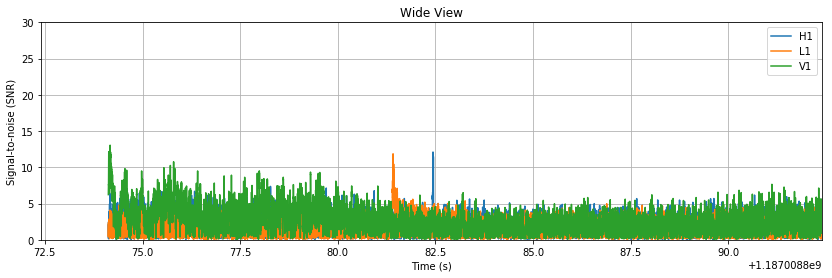

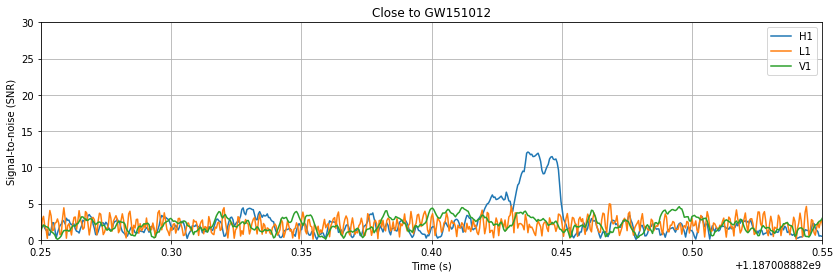

In [148]:
m = Merger("GW170817")

ifos = ['H1', 'L1', 'V1']
data = {}
psd = {}


for ifo in ifos:
    # Read in and precondition the data
    ts = m.strain(ifo).highpass_fir(15, 512)
    data[ifo] = resample_to_delta_t(ts, 1.0/2048).crop(2, 2)

    # Estimate the power spectral density of the data
    # This chooses to use 2s samples in the PSD estimate.
    # One should note that the tradeoff in segment length is that
    # resolving narrow lines becomes more difficult.
    p = data[ifo].psd(20)
    p = interpolate(p, data[ifo].delta_f)
    p = inverse_spectrum_truncation(p, 2 * data[ifo].sample_rate, low_frequency_cutoff=15.0)
    psd[ifo] = p

cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data[ifo].delta_f)
hp.resize(len(psd[ifo]))
# For each observatory use this template to calculate the SNR time series
snr = {}
for ifo in ifos:
    snr[ifo] = matched_filter(hp, data[ifo], psd=psd[ifo], low_frequency_cutoff=20)
    snr[ifo] = snr[ifo].crop(5, 4)
for w, title in [(10, 'Wide View'), (.15, 'Close to GW151012')]:
    plt.figure(figsize=[14, 4])
    for ifo in ifos:
        plt.plot(snr[ifo].sample_times, abs(snr[ifo]), label=ifo)

    plt.legend()
    plt.title(title)
    plt.grid()
    plt.xlim(m.time - w, m.time + w)
    plt.ylim(0, 30)
    plt.xlabel('Time (s)')
    plt.ylabel('Signal-to-noise (SNR)')

The neutron star merger needs first another, more dapated way of analysing it. It needs an adated model and maybe better time slices. Therefore, we will return to it later.

The next event is GW170104 LIGO detectors only

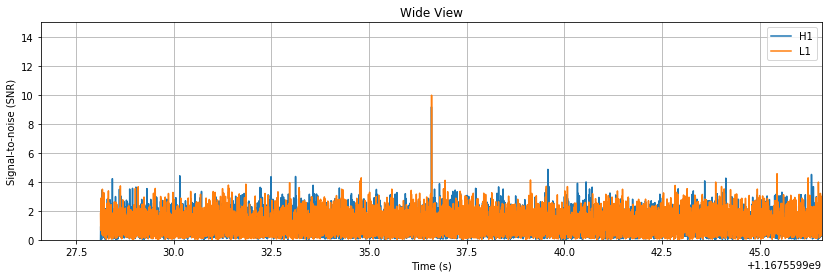

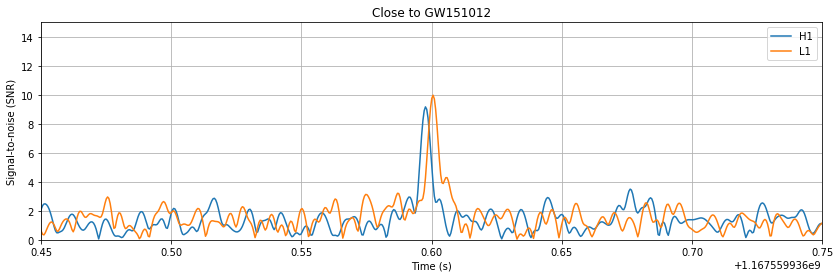

In [149]:
m = Merger("GW170104")

ifos = ['H1', 'L1']
data = {}
psd = {}


for ifo in ifos:
    # Read in and precondition the data
    ts = m.strain(ifo).highpass_fir(15, 512)
    data[ifo] = resample_to_delta_t(ts, 1.0/2048).crop(2, 2)

    # Estimate the power spectral density of the data
    # This chooses to use 2s samples in the PSD estimate.
    # One should note that the tradeoff in segment length is that
    # resolving narrow lines becomes more difficult.
    p = data[ifo].psd(2)
    p = interpolate(p, data[ifo].delta_f)
    p = inverse_spectrum_truncation(p, 2 * data[ifo].sample_rate, low_frequency_cutoff=15.0)
    psd[ifo] = p

cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data[ifo].delta_f)
hp.resize(len(psd[ifo]))
# For each observatory use this template to calculate the SNR time series
snr = {}
for ifo in ifos:
    snr[ifo] = matched_filter(hp, data[ifo], psd=psd[ifo], low_frequency_cutoff=20)
    snr[ifo] = snr[ifo].crop(5, 4)
for w, title in [(10, 'Wide View'), (.15, 'Close to GW151012')]:
    plt.figure(figsize=[14, 4])
    for ifo in ifos:
        plt.plot(snr[ifo].sample_times, abs(snr[ifo]), label=ifo)

    plt.legend()
    plt.title(title)
    plt.grid()
    plt.xlim(m.time - w, m.time + w)
    plt.ylim(0, 15)
    plt.xlabel('Time (s)')
    plt.ylabel('Signal-to-noise (SNR)')

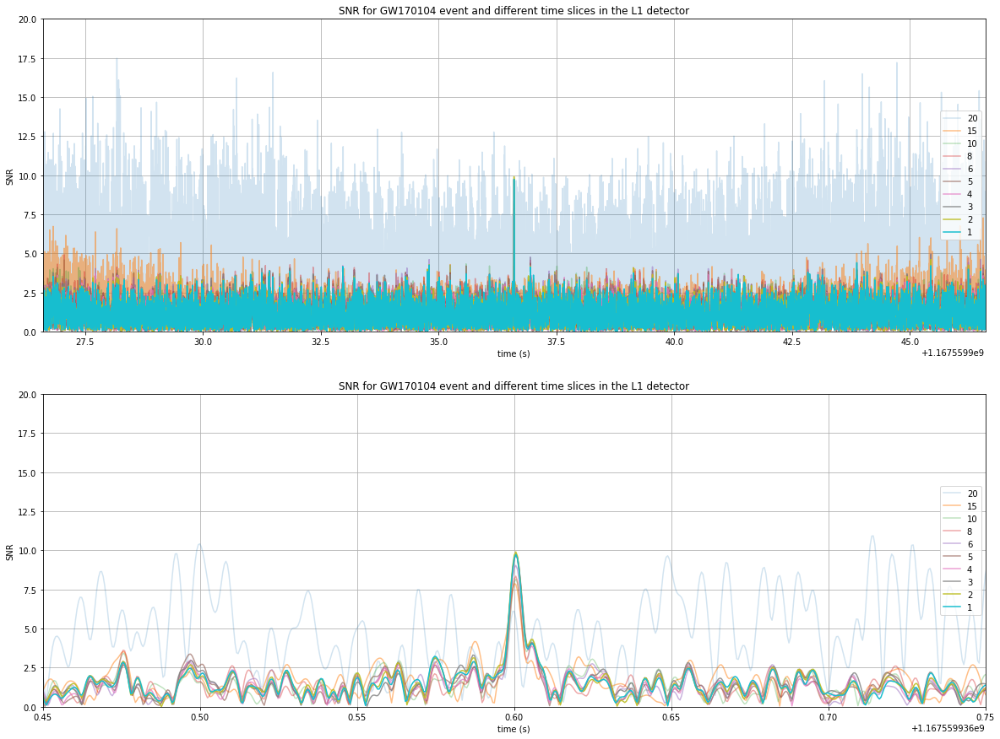

In [150]:
event="GW170104"
mergers=[]
time_slices=[20, 15, 10, 8, 6, 5, 4, 3, 2, 1]
alphas=[0.2, 0.5, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1, 1]
merger=Merger(event)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
data=merger.strain("L1").highpass_fir(15,512)
data=resample_to_delta_t(data, 1.0/2048).crop(2,2)
f=plt.figure(figsize=[20,15])
ax=f.subplots(nrows=2)
width=[10,0.15]
psds=[]

for i in range(2):
    for j in range(len(time_slices)):
        psd=data.psd(time_slices[j])
        psd=interpolate(psd, data.delta_f)
        psds.append(psd)
        hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
        hp.resize(len(psd))
        snr=matched_filter(hp, data, psd=psd, low_frequency_cutoff=20.)
        ax[i].plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    ax[i].legend(loc="right")
    ax[i].set_title("SNR for %s event and different time slices in the L1 detector" %event)
    ax[i].grid()
    ax[i].set_xlim(merger.time-width[i], merger.time+width[i])
    ax[i].set_ylim(0,20)
    ax[i].set_xlabel("time (s)")
    ax[i].set_ylabel("SNR") 
    

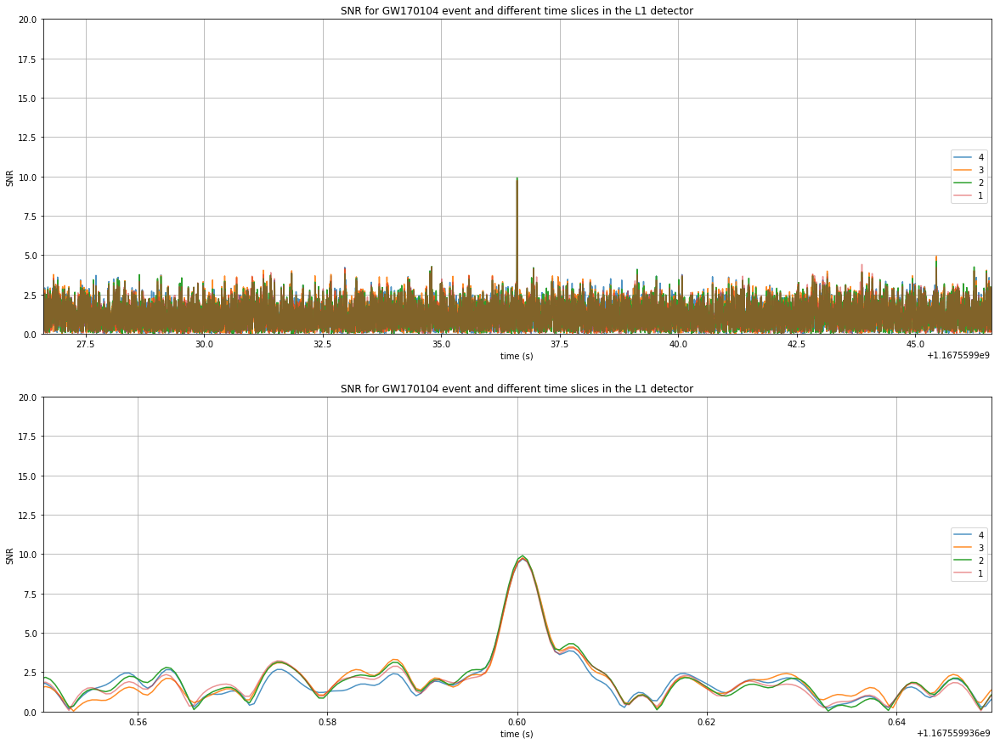

In [151]:
event="GW170104"
mergers=[]
time_slices=[ 4, 3, 2, 1]
alphas=[ 0.8, 0.9, 1, 0.5]
merger=Merger(event)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
data=merger.strain("L1").highpass_fir(15,512)
data=resample_to_delta_t(data, 1.0/2048).crop(2,2)
f=plt.figure(figsize=[20,15])
ax=f.subplots(nrows=2)
width=[10,0.05]
psds=[]

for i in range(2):
    for j in range(len(time_slices)):
        psd=data.psd(time_slices[j])
        psd=interpolate(psd, data.delta_f)
        psds.append(psd)
        hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
        hp.resize(len(psd))
        snr=matched_filter(hp, data, psd=psd, low_frequency_cutoff=20.)
        ax[i].plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    ax[i].legend(loc="right")
    ax[i].set_title("SNR for %s event and different time slices in the L1 detector" %event)
    ax[i].grid()
    ax[i].set_xlim(merger.time-width[i], merger.time+width[i])
    ax[i].set_ylim(0,20)
    ax[i].set_xlabel("time (s)")
    ax[i].set_ylabel("SNR") 
    

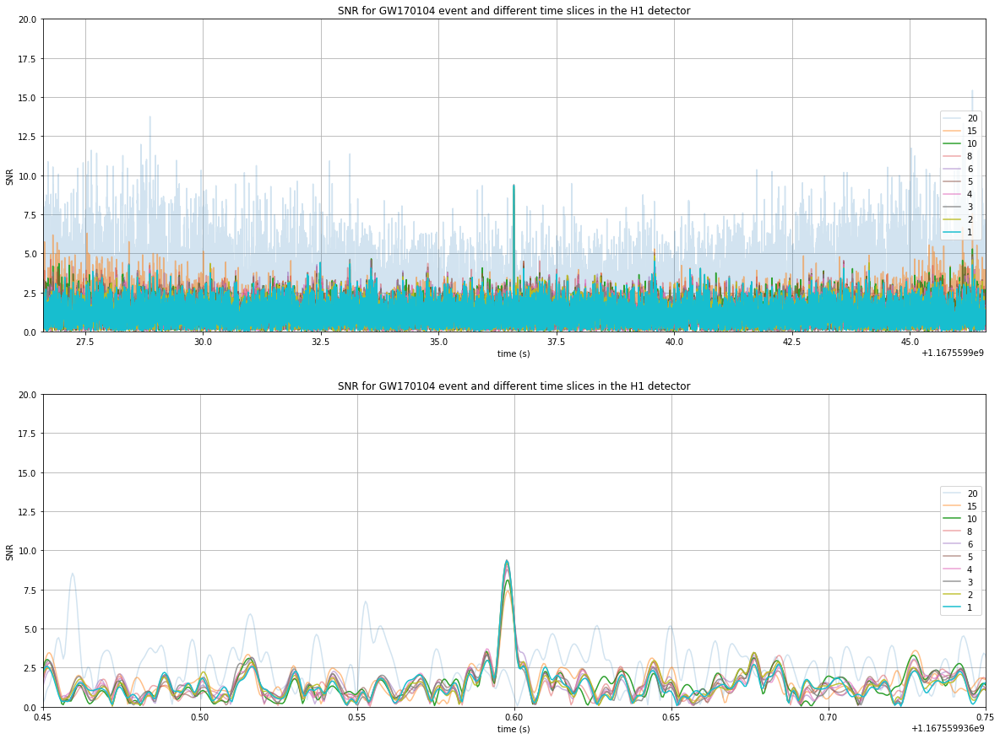

In [152]:
event="GW170104"
mergers=[]
time_slices=[20, 15, 10, 8, 6, 5, 4, 3, 2, 1]
alphas=[0.2, 0.5, 1, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1, 1]
merger=Merger(event)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
data=merger.strain("H1").highpass_fir(15,512)
data=resample_to_delta_t(data, 1.0/2048).crop(2,2)
f=plt.figure(figsize=[20,15])
ax=f.subplots(nrows=2)
width=[10,0.15]
psds=[]

for i in range(2):
    for j in range(len(time_slices)):
        psd=data.psd(time_slices[j])
        psd=interpolate(psd, data.delta_f)
        psds.append(psd)
        hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
        hp.resize(len(psd))
        snr=matched_filter(hp, data, psd=psd, low_frequency_cutoff=20.)
        ax[i].plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    ax[i].legend(loc="right")
    ax[i].set_title("SNR for %s event and different time slices in the H1 detector" %event)
    ax[i].grid()
    ax[i].set_xlim(merger.time-width[i], merger.time+width[i])
    ax[i].set_ylim(0,20)
    ax[i].set_xlabel("time (s)")
    ax[i].set_ylabel("SNR") 
    

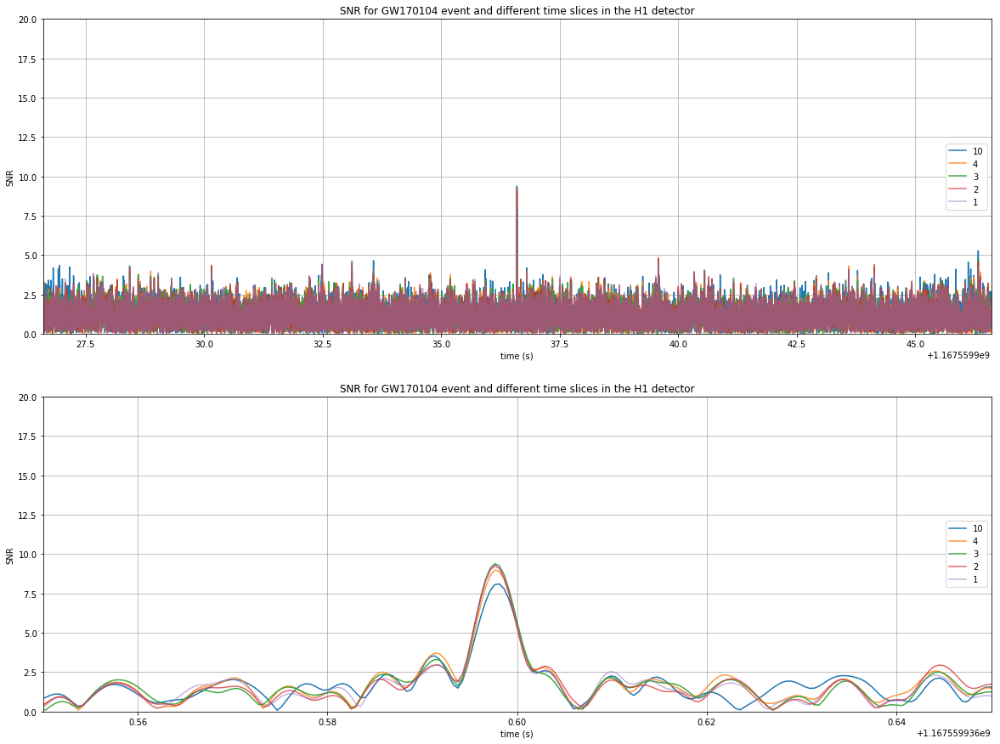

In [154]:
event="GW170104"
mergers=[]
time_slices=[ 10,4, 3, 2, 1]
alphas=[ 1,0.8, 0.9, 0.7, 0.5]
merger=Merger(event)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
data=merger.strain("H1").highpass_fir(15,512)
data=resample_to_delta_t(data, 1.0/2048).crop(2,2)
f=plt.figure(figsize=[20,15])
ax=f.subplots(nrows=2)
width=[10,0.05]
psds=[]

for i in range(2):
    for j in range(len(time_slices)):
        psd=data.psd(time_slices[j])
        psd=interpolate(psd, data.delta_f)
        psds.append(psd)
        hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
        hp.resize(len(psd))
        snr=matched_filter(hp, data, psd=psd, low_frequency_cutoff=20.)
        ax[i].plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    ax[i].legend(loc="right")
    ax[i].set_title("SNR for %s event and different time slices in the H1 detector" %event)
    ax[i].grid()
    ax[i].set_xlim(merger.time-width[i], merger.time+width[i])
    ax[i].set_ylim(0,20)
    ax[i].set_xlabel("time (s)")
    ax[i].set_ylabel("SNR") 
    

The next event that is tested is GW170809 it is a LIGO detection, two black holes

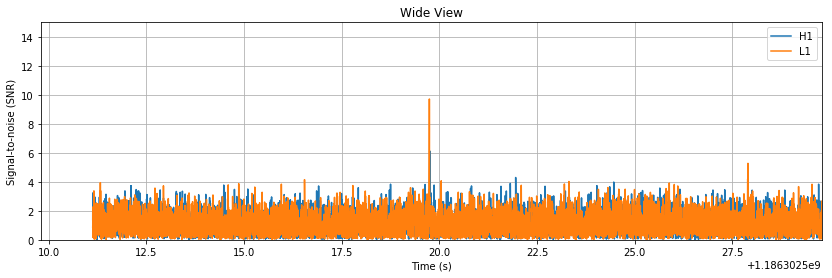

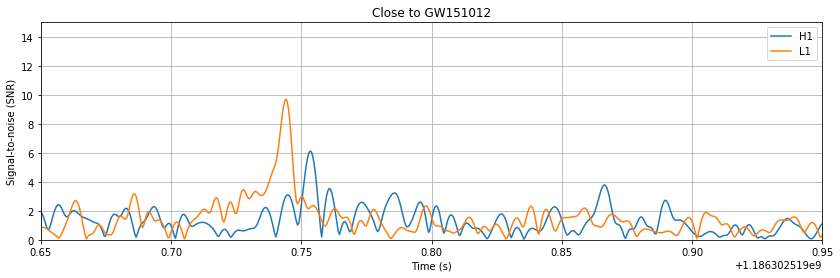

In [155]:
m = Merger("GW170809")

ifos = ['H1', 'L1']
data = {}
psd = {}


for ifo in ifos:
    # Read in and precondition the data
    ts = m.strain(ifo).highpass_fir(15, 512)
    data[ifo] = resample_to_delta_t(ts, 1.0/2048).crop(2, 2)

    # Estimate the power spectral density of the data
    # This chooses to use 2s samples in the PSD estimate.
    # One should note that the tradeoff in segment length is that
    # resolving narrow lines becomes more difficult.
    p = data[ifo].psd(2)
    p = interpolate(p, data[ifo].delta_f)
    p = inverse_spectrum_truncation(p, 2 * data[ifo].sample_rate, low_frequency_cutoff=15.0)
    psd[ifo] = p

cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data[ifo].delta_f)
hp.resize(len(psd[ifo]))
# For each observatory use this template to calculate the SNR time series
snr = {}
for ifo in ifos:
    snr[ifo] = matched_filter(hp, data[ifo], psd=psd[ifo], low_frequency_cutoff=20)
    snr[ifo] = snr[ifo].crop(5, 4)
for w, title in [(10, 'Wide View'), (.15, 'Close to GW151012')]:
    plt.figure(figsize=[14, 4])
    for ifo in ifos:
        plt.plot(snr[ifo].sample_times, abs(snr[ifo]), label=ifo)

    plt.legend()
    plt.title(title)
    plt.grid()
    plt.xlim(m.time - w, m.time + w)
    plt.ylim(0, 15)
    plt.xlabel('Time (s)')
    plt.ylabel('Signal-to-noise (SNR)')

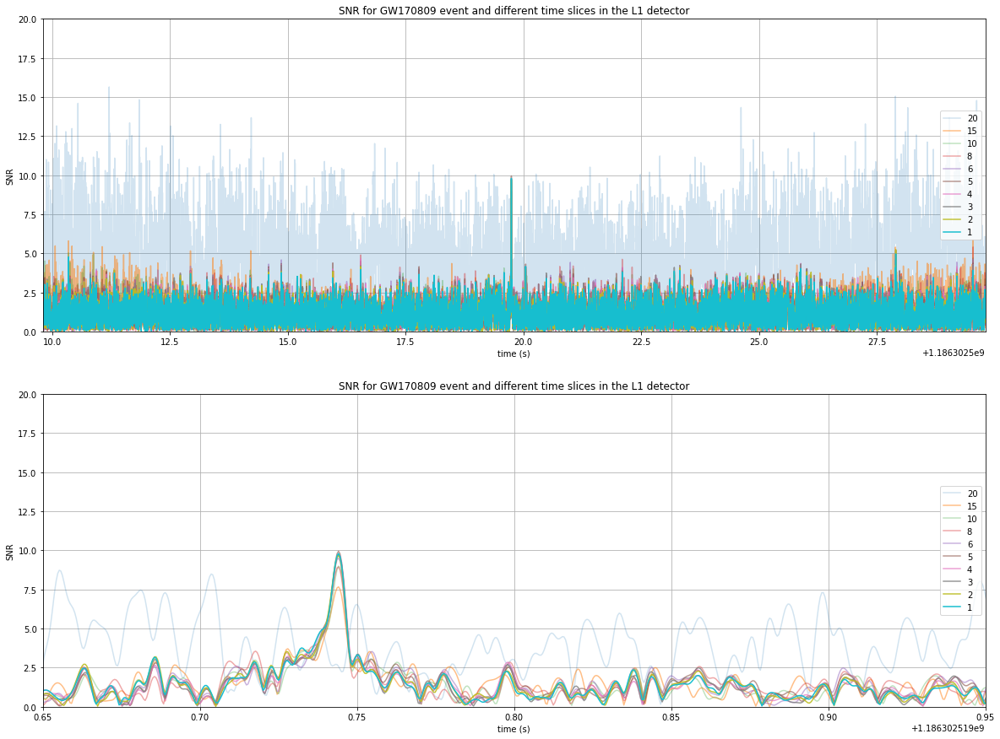

In [156]:
event="GW170809"
mergers=[]
time_slices=[20, 15, 10, 8, 6, 5, 4, 3, 2, 1]
alphas=[0.2, 0.5, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1, 1]
merger=Merger(event)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
data=merger.strain("L1").highpass_fir(15,512)
data=resample_to_delta_t(data, 1.0/2048).crop(2,2)
f=plt.figure(figsize=[20,15])
ax=f.subplots(nrows=2)
width=[10,0.15]
psds=[]

for i in range(2):
    for j in range(len(time_slices)):
        psd=data.psd(time_slices[j])
        psd=interpolate(psd, data.delta_f)
        psds.append(psd)
        hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
        hp.resize(len(psd))
        snr=matched_filter(hp, data, psd=psd, low_frequency_cutoff=20.)
        ax[i].plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    ax[i].legend(loc="right")
    ax[i].set_title("SNR for %s event and different time slices in the L1 detector" %event)
    ax[i].grid()
    ax[i].set_xlim(merger.time-width[i], merger.time+width[i])
    ax[i].set_ylim(0,20)
    ax[i].set_xlabel("time (s)")
    ax[i].set_ylabel("SNR") 
    

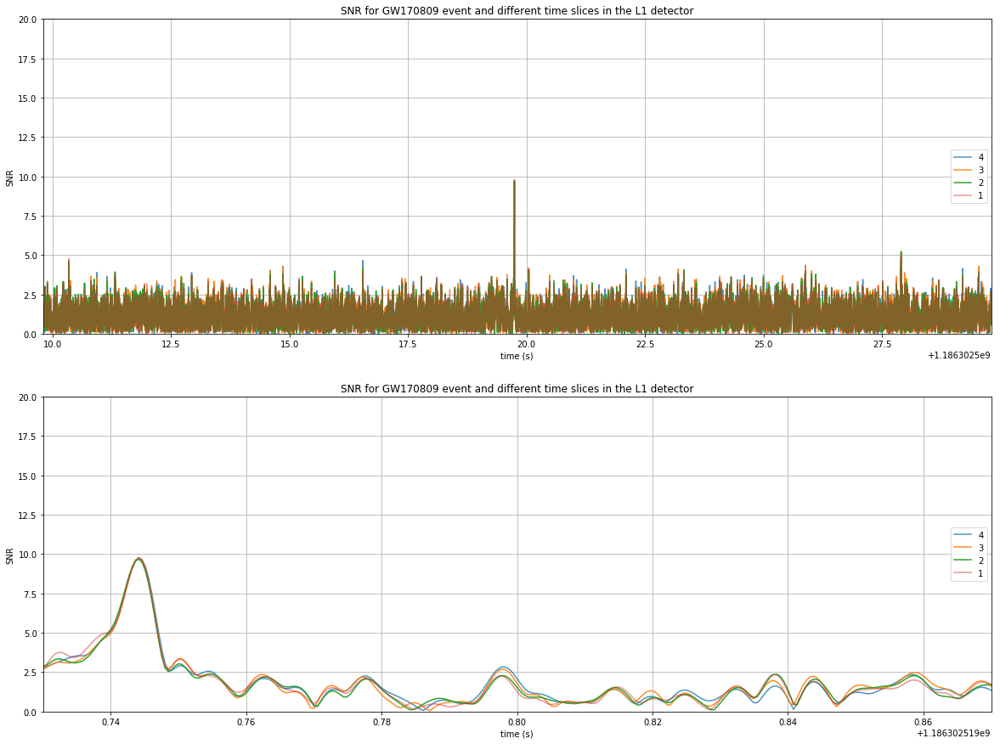

In [160]:
event="GW170809"
mergers=[]
time_slices=[ 4, 3, 2, 1]
alphas=[ 0.8, 0.9, 1, 0.5]
merger=Merger(event)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
data=merger.strain("L1").highpass_fir(15,512)
data=resample_to_delta_t(data, 1.0/2048).crop(2,2)
f=plt.figure(figsize=[20,15])
ax=f.subplots(nrows=2)
width=[10,0.07]
psds=[]

for i in range(2):
    for j in range(len(time_slices)):
        psd=data.psd(time_slices[j])
        psd=interpolate(psd, data.delta_f)
        psds.append(psd)
        hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
        hp.resize(len(psd))
        snr=matched_filter(hp, data, psd=psd, low_frequency_cutoff=20.)
        ax[i].plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    ax[i].legend(loc="right")
    ax[i].set_title("SNR for %s event and different time slices in the L1 detector" %event)
    ax[i].grid()
    ax[i].set_xlim(merger.time-width[i], merger.time+width[i])
    ax[i].set_ylim(0,20)
    ax[i].set_xlabel("time (s)")
    ax[i].set_ylabel("SNR") 
    

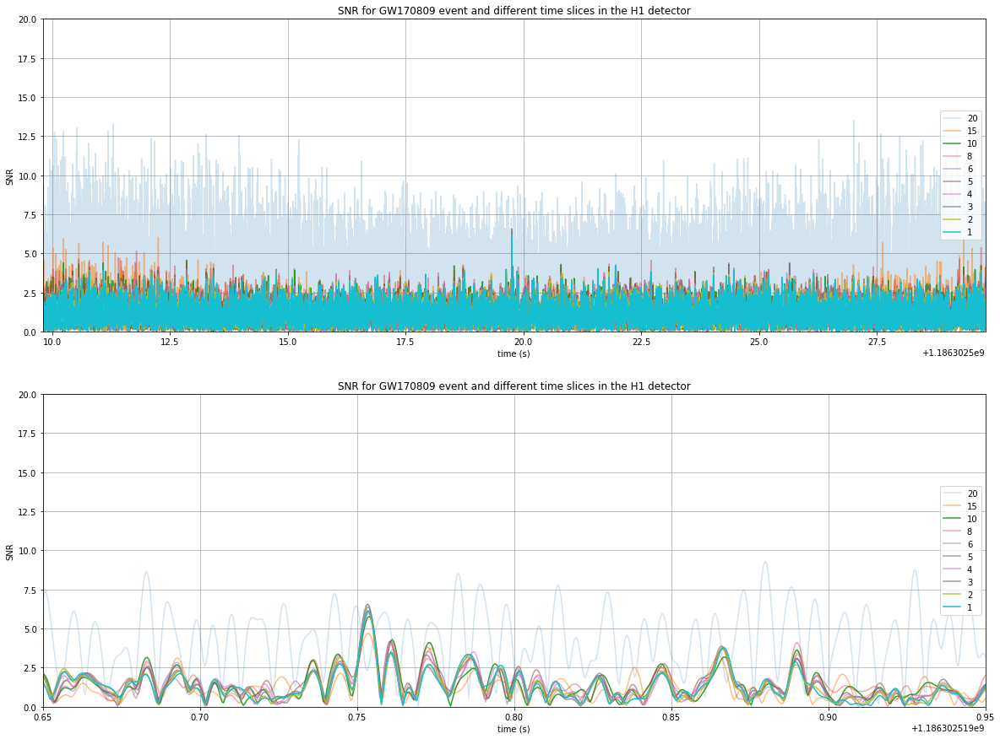

In [161]:
event="GW170809"
mergers=[]
time_slices=[20, 15, 10, 8, 6, 5, 4, 3, 2, 1]
alphas=[0.2, 0.5, 1, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1, 1]
merger=Merger(event)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
data=merger.strain("H1").highpass_fir(15,512)
data=resample_to_delta_t(data, 1.0/2048).crop(2,2)
f=plt.figure(figsize=[20,15])
ax=f.subplots(nrows=2)
width=[10,0.15]
psds=[]

for i in range(2):
    for j in range(len(time_slices)):
        psd=data.psd(time_slices[j])
        psd=interpolate(psd, data.delta_f)
        psds.append(psd)
        hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
        hp.resize(len(psd))
        snr=matched_filter(hp, data, psd=psd, low_frequency_cutoff=20.)
        ax[i].plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    ax[i].legend(loc="right")
    ax[i].set_title("SNR for %s event and different time slices in the H1 detector" %event)
    ax[i].grid()
    ax[i].set_xlim(merger.time-width[i], merger.time+width[i])
    ax[i].set_ylim(0,20)
    ax[i].set_xlabel("time (s)")
    ax[i].set_ylabel("SNR") 
    

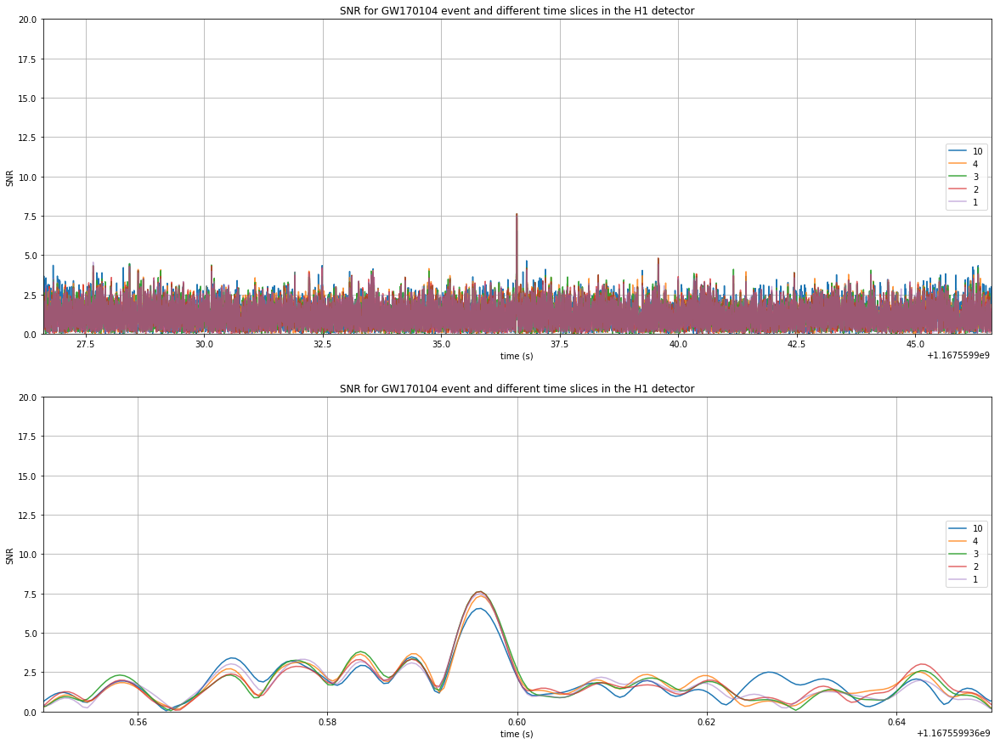

In [162]:
event="GW170104"
mergers=[]
time_slices=[ 10,4, 3, 2, 1]
alphas=[ 1,0.8, 0.9, 0.7, 0.5]
merger=Merger(event)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
data=merger.strain("H1").highpass_fir(15,512)
data=resample_to_delta_t(data, 1.0/2048).crop(2,2)
f=plt.figure(figsize=[20,15])
ax=f.subplots(nrows=2)
width=[10,0.05]
psds=[]

for i in range(2):
    for j in range(len(time_slices)):
        psd=data.psd(time_slices[j])
        psd=interpolate(psd, data.delta_f)
        psds.append(psd)
        hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
        hp.resize(len(psd))
        snr=matched_filter(hp, data, psd=psd, low_frequency_cutoff=20.)
        ax[i].plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    ax[i].legend(loc="right")
    ax[i].set_title("SNR for %s event and different time slices in the H1 detector" %event)
    ax[i].grid()
    ax[i].set_xlim(merger.time-width[i], merger.time+width[i])
    ax[i].set_ylim(0,20)
    ax[i].set_xlabel("time (s)")
    ax[i].set_ylabel("SNR") 
    

The next event that is analyzed is GW170819. It is a triple detection of black holes mergers

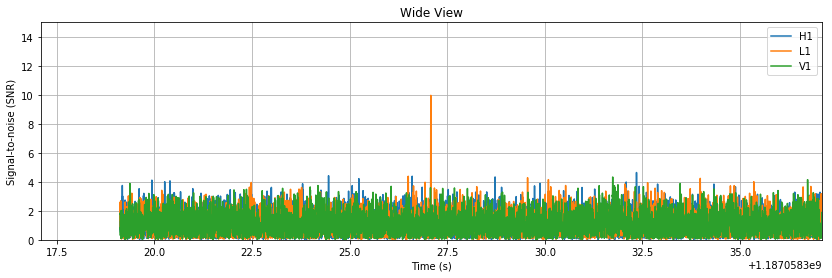

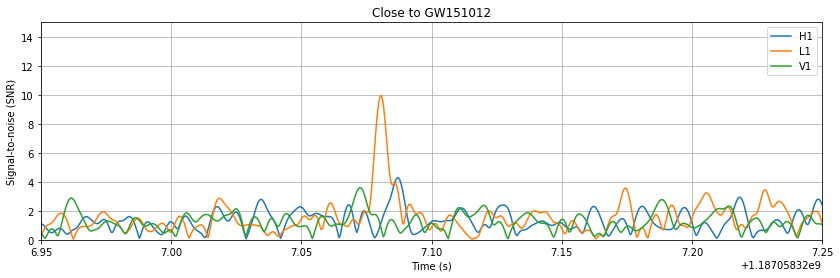

In [163]:
m = Merger("GW170818")

ifos = ['H1', 'L1', 'V1']
data = {}
psd = {}


for ifo in ifos:
    # Read in and precondition the data
    ts = m.strain(ifo).highpass_fir(15, 512)
    data[ifo] = resample_to_delta_t(ts, 1.0/2048).crop(2, 2)

    # Estimate the power spectral density of the data
    # This chooses to use 2s samples in the PSD estimate.
    # One should note that the tradeoff in segment length is that
    # resolving narrow lines becomes more difficult.
    p = data[ifo].psd(2)
    p = interpolate(p, data[ifo].delta_f)
    p = inverse_spectrum_truncation(p, 2 * data[ifo].sample_rate, low_frequency_cutoff=15.0)
    psd[ifo] = p

cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data[ifo].delta_f)
hp.resize(len(psd[ifo]))
# For each observatory use this template to calculate the SNR time series
snr = {}
for ifo in ifos:
    snr[ifo] = matched_filter(hp, data[ifo], psd=psd[ifo], low_frequency_cutoff=20)
    snr[ifo] = snr[ifo].crop(5, 4)
for w, title in [(10, 'Wide View'), (.15, 'Close to GW151012')]:
    plt.figure(figsize=[14, 4])
    for ifo in ifos:
        plt.plot(snr[ifo].sample_times, abs(snr[ifo]), label=ifo)

    plt.legend()
    plt.title(title)
    plt.grid()
    plt.xlim(m.time - w, m.time + w)
    plt.ylim(0, 15)
    plt.xlabel('Time (s)')
    plt.ylabel('Signal-to-noise (SNR)')

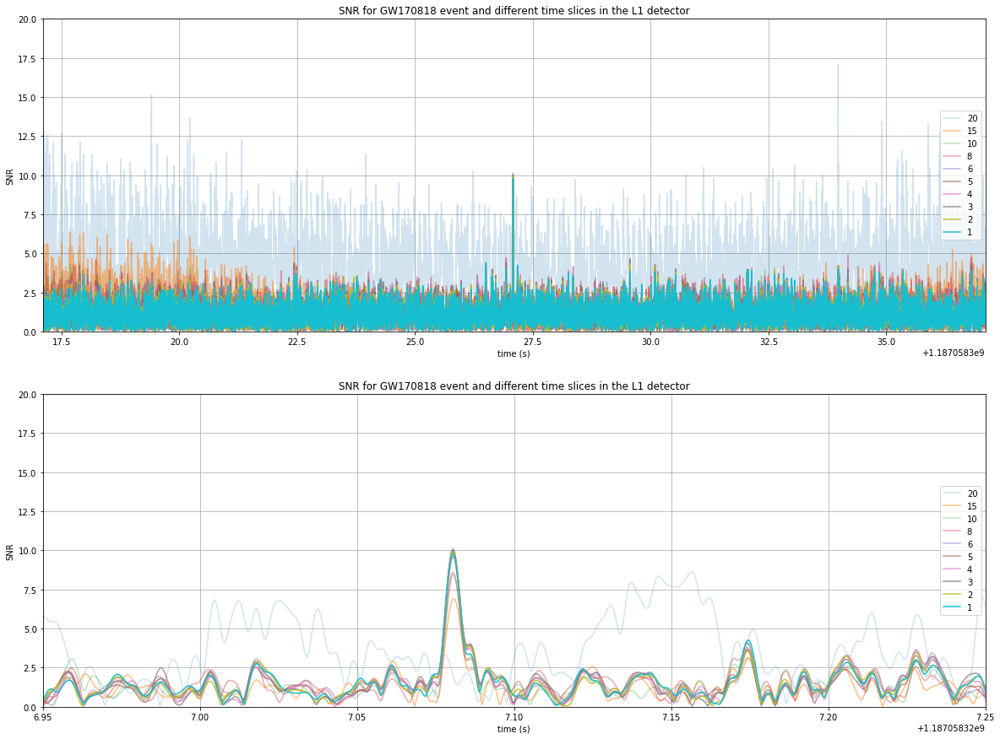

In [164]:
event="GW170818"
mergers=[]
time_slices=[20, 15, 10, 8, 6, 5, 4, 3, 2, 1]
alphas=[0.2, 0.5, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1, 1]
merger=Merger(event)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
data=merger.strain("L1").highpass_fir(15,512)
data=resample_to_delta_t(data, 1.0/2048).crop(2,2)
f=plt.figure(figsize=[20,15])
ax=f.subplots(nrows=2)
width=[10,0.15]
psds=[]

for i in range(2):
    for j in range(len(time_slices)):
        psd=data.psd(time_slices[j])
        psd=interpolate(psd, data.delta_f)
        psds.append(psd)
        hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
        hp.resize(len(psd))
        snr=matched_filter(hp, data, psd=psd, low_frequency_cutoff=20.)
        ax[i].plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    ax[i].legend(loc="right")
    ax[i].set_title("SNR for %s event and different time slices in the L1 detector" %event)
    ax[i].grid()
    ax[i].set_xlim(merger.time-width[i], merger.time+width[i])
    ax[i].set_ylim(0,20)
    ax[i].set_xlabel("time (s)")
    ax[i].set_ylabel("SNR") 
    

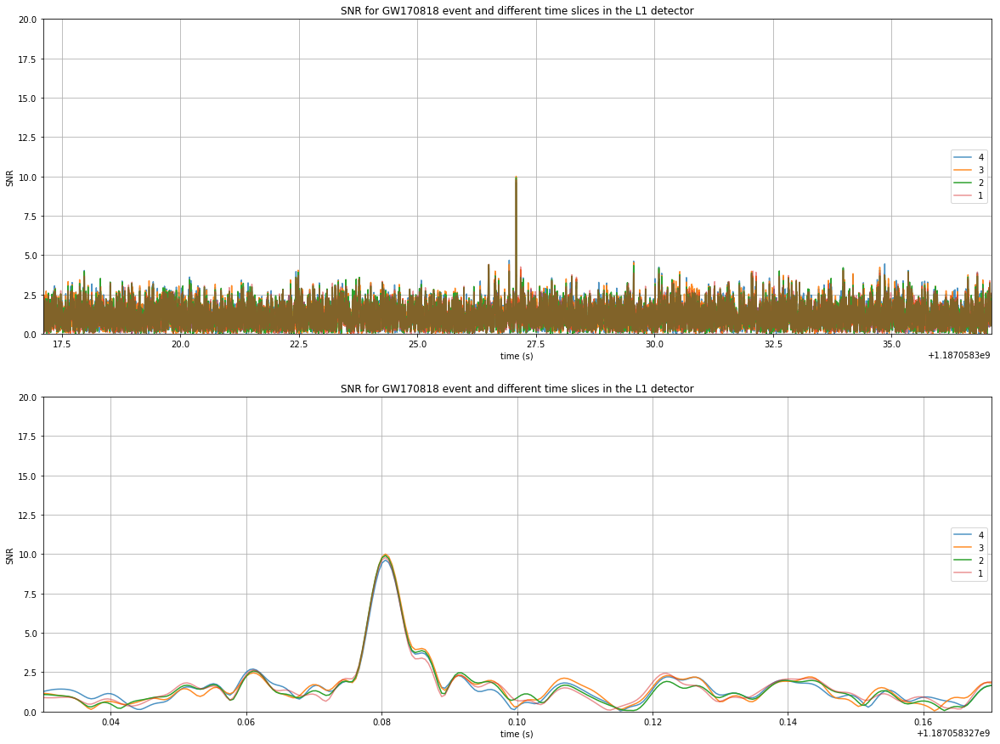

In [165]:
event="GW170818"
mergers=[]
time_slices=[ 4, 3, 2, 1]
alphas=[ 0.8, 0.9, 1, 0.5]
merger=Merger(event)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
data=merger.strain("L1").highpass_fir(15,512)
data=resample_to_delta_t(data, 1.0/2048).crop(2,2)
f=plt.figure(figsize=[20,15])
ax=f.subplots(nrows=2)
width=[10,0.07]
psds=[]

for i in range(2):
    for j in range(len(time_slices)):
        psd=data.psd(time_slices[j])
        psd=interpolate(psd, data.delta_f)
        psds.append(psd)
        hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
        hp.resize(len(psd))
        snr=matched_filter(hp, data, psd=psd, low_frequency_cutoff=20.)
        ax[i].plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    ax[i].legend(loc="right")
    ax[i].set_title("SNR for %s event and different time slices in the L1 detector" %event)
    ax[i].grid()
    ax[i].set_xlim(merger.time-width[i], merger.time+width[i])
    ax[i].set_ylim(0,20)
    ax[i].set_xlabel("time (s)")
    ax[i].set_ylabel("SNR") 
    

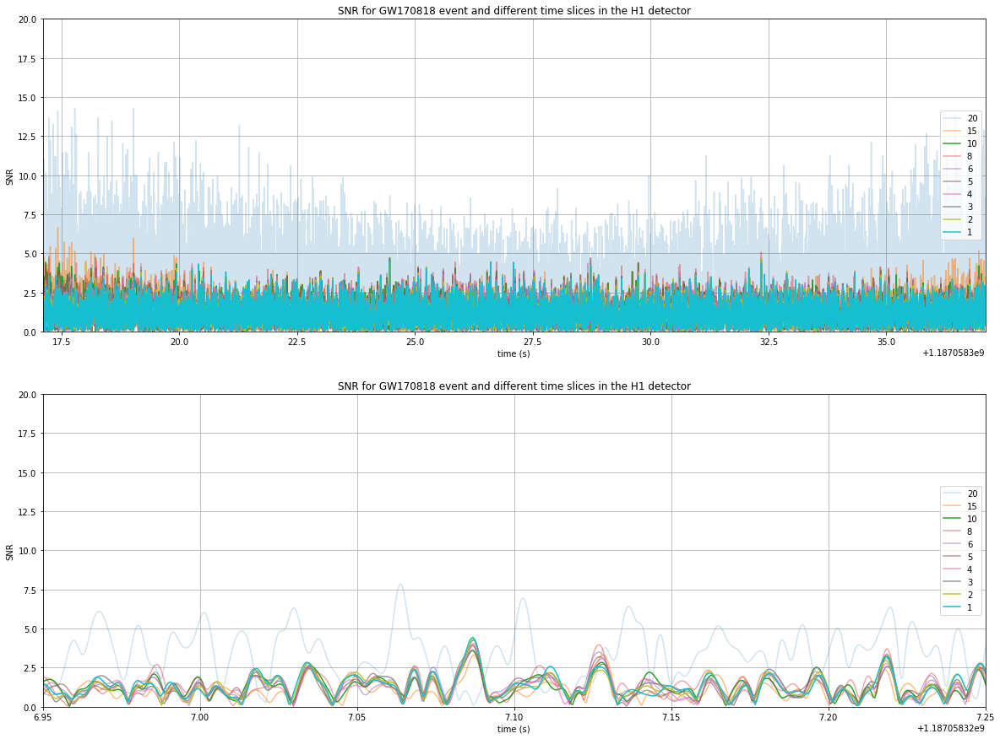

In [166]:
event="GW170818"
mergers=[]
time_slices=[20, 15, 10, 8, 6, 5, 4, 3, 2, 1]
alphas=[0.2, 0.5, 1, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1, 1]
merger=Merger(event)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
data=merger.strain("H1").highpass_fir(15,512)
data=resample_to_delta_t(data, 1.0/2048).crop(2,2)
f=plt.figure(figsize=[20,15])
ax=f.subplots(nrows=2)
width=[10,0.15]
psds=[]

for i in range(2):
    for j in range(len(time_slices)):
        psd=data.psd(time_slices[j])
        psd=interpolate(psd, data.delta_f)
        psds.append(psd)
        hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
        hp.resize(len(psd))
        snr=matched_filter(hp, data, psd=psd, low_frequency_cutoff=20.)
        ax[i].plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    ax[i].legend(loc="right")
    ax[i].set_title("SNR for %s event and different time slices in the H1 detector" %event)
    ax[i].grid()
    ax[i].set_xlim(merger.time-width[i], merger.time+width[i])
    ax[i].set_ylim(0,20)
    ax[i].set_xlabel("time (s)")
    ax[i].set_ylabel("SNR") 
    

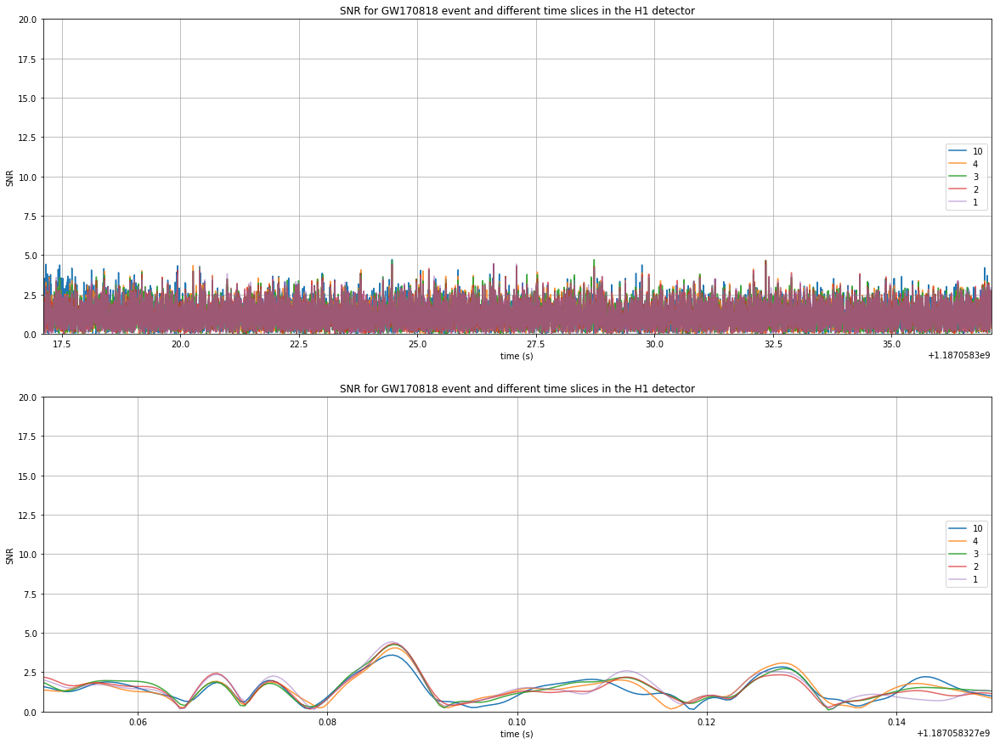

In [169]:
event="GW170818"
mergers=[]
time_slices=[ 10,4, 3, 2, 1]
alphas=[ 1,0.8, 0.9, 0.7, 0.5]
merger=Merger(event)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
data=merger.strain("H1").highpass_fir(15,512)
data=resample_to_delta_t(data, 1.0/2048).crop(2,2)
f=plt.figure(figsize=[20,15])
ax=f.subplots(nrows=2)
width=[10,0.05]
psds=[]

for i in range(2):
    for j in range(len(time_slices)):
        psd=data.psd(time_slices[j])
        psd=interpolate(psd, data.delta_f)
        psds.append(psd)
        hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
        hp.resize(len(psd))
        snr=matched_filter(hp, data, psd=psd, low_frequency_cutoff=20.)
        ax[i].plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    ax[i].legend(loc="right")
    ax[i].set_title("SNR for %s event and different time slices in the H1 detector" %event)
    ax[i].grid()
    ax[i].set_xlim(merger.time-width[i], merger.time+width[i])
    ax[i].set_ylim(0,20)
    ax[i].set_xlabel("time (s)")
    ax[i].set_ylabel("SNR") 
    

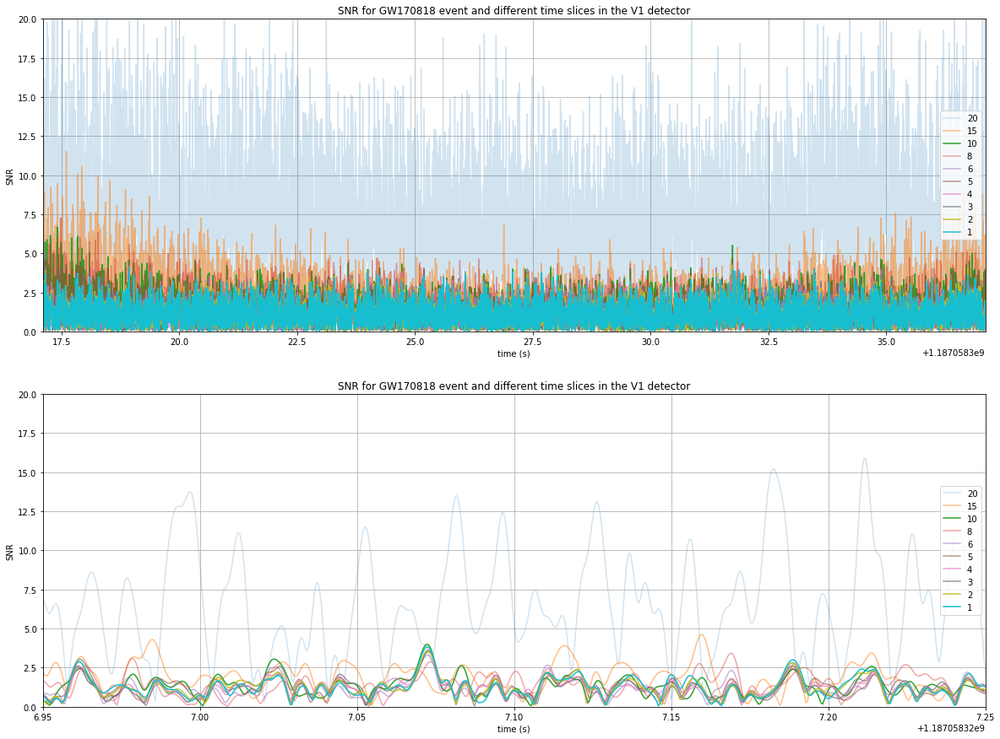

In [168]:
event="GW170818"
mergers=[]
time_slices=[20, 15, 10, 8, 6, 5, 4, 3, 2, 1]
alphas=[0.2, 0.5, 1, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1, 1]
merger=Merger(event)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
data=merger.strain("V1").highpass_fir(15,512)
data=resample_to_delta_t(data, 1.0/2048).crop(2,2)
f=plt.figure(figsize=[20,15])
ax=f.subplots(nrows=2)
width=[10,0.15]
psds=[]

for i in range(2):
    for j in range(len(time_slices)):
        psd=data.psd(time_slices[j])
        psd=interpolate(psd, data.delta_f)
        psds.append(psd)
        hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
        hp.resize(len(psd))
        snr=matched_filter(hp, data, psd=psd, low_frequency_cutoff=20.)
        ax[i].plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    ax[i].legend(loc="right")
    ax[i].set_title("SNR for %s event and different time slices in the V1 detector" %event)
    ax[i].grid()
    ax[i].set_xlim(merger.time-width[i], merger.time+width[i])
    ax[i].set_ylim(0,20)
    ax[i].set_xlabel("time (s)")
    ax[i].set_ylabel("SNR") 
    

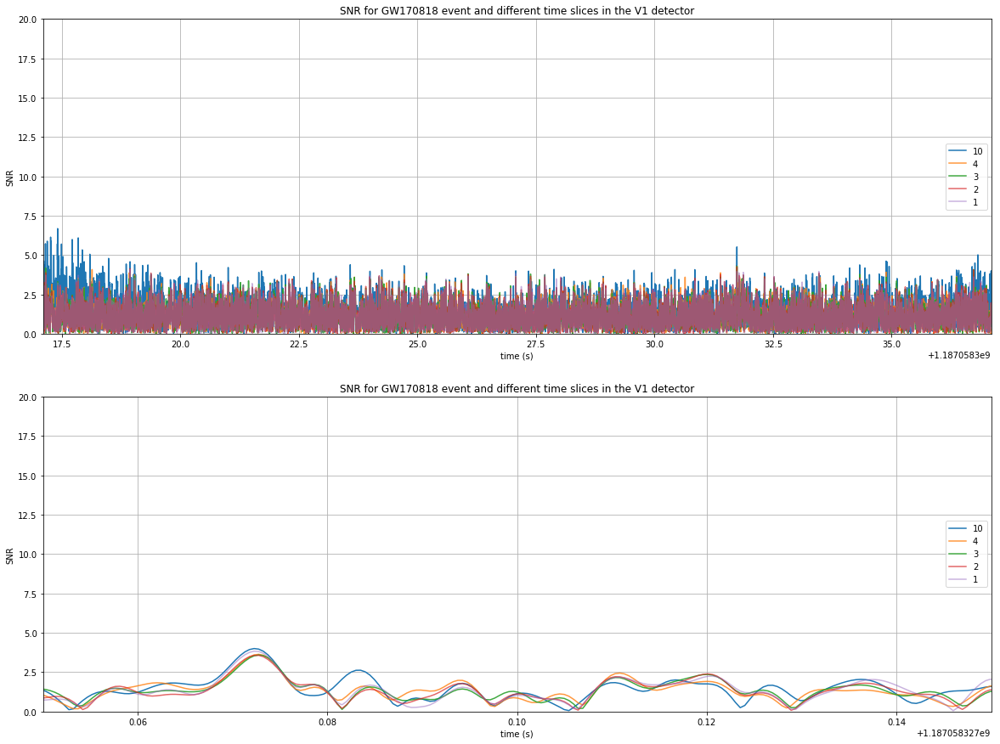

In [170]:
event="GW170818"
mergers=[]
time_slices=[ 10,4, 3, 2, 1]
alphas=[ 1,0.8, 0.9, 0.7, 0.5]
merger=Merger(event)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
data=merger.strain("V1").highpass_fir(15,512)
data=resample_to_delta_t(data, 1.0/2048).crop(2,2)
f=plt.figure(figsize=[20,15])
ax=f.subplots(nrows=2)
width=[10,0.05]
psds=[]

for i in range(2):
    for j in range(len(time_slices)):
        psd=data.psd(time_slices[j])
        psd=interpolate(psd, data.delta_f)
        psds.append(psd)
        hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
        hp.resize(len(psd))
        snr=matched_filter(hp, data, psd=psd, low_frequency_cutoff=20.)
        ax[i].plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    ax[i].legend(loc="right")
    ax[i].set_title("SNR for %s event and different time slices in the V1 detector" %event)
    ax[i].grid()
    ax[i].set_xlim(merger.time-width[i], merger.time+width[i])
    ax[i].set_ylim(0,20)
    ax[i].set_xlabel("time (s)")
    ax[i].set_ylabel("SNR") 
    

Event GW170823, LIGO detection, black holes

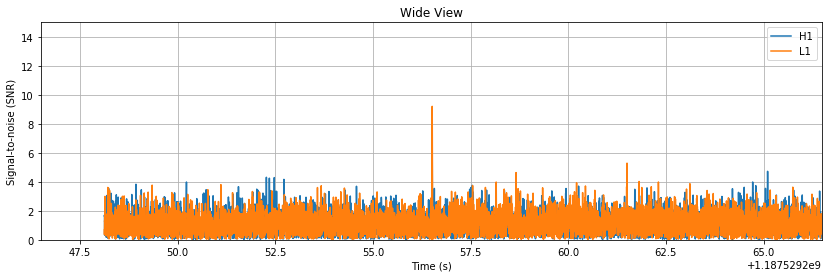

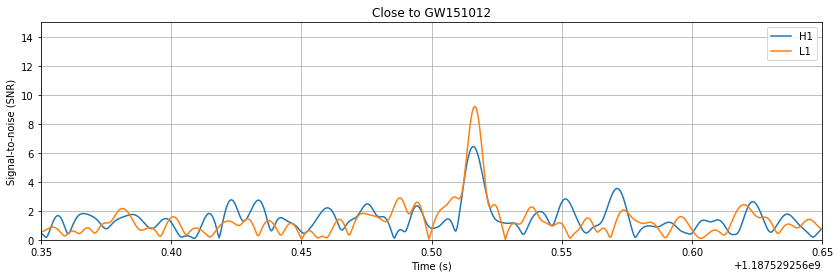

In [171]:
m = Merger("GW170823")

ifos = ['H1', 'L1']
data = {}
psd = {}


for ifo in ifos:
    # Read in and precondition the data
    ts = m.strain(ifo).highpass_fir(15, 512)
    data[ifo] = resample_to_delta_t(ts, 1.0/2048).crop(2, 2)

    # Estimate the power spectral density of the data
    # This chooses to use 2s samples in the PSD estimate.
    # One should note that the tradeoff in segment length is that
    # resolving narrow lines becomes more difficult.
    p = data[ifo].psd(2)
    p = interpolate(p, data[ifo].delta_f)
    p = inverse_spectrum_truncation(p, 2 * data[ifo].sample_rate, low_frequency_cutoff=15.0)
    psd[ifo] = p

cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data[ifo].delta_f)
hp.resize(len(psd[ifo]))
# For each observatory use this template to calculate the SNR time series
snr = {}
for ifo in ifos:
    snr[ifo] = matched_filter(hp, data[ifo], psd=psd[ifo], low_frequency_cutoff=20)
    snr[ifo] = snr[ifo].crop(5, 4)
for w, title in [(10, 'Wide View'), (.15, 'Close to GW151012')]:
    plt.figure(figsize=[14, 4])
    for ifo in ifos:
        plt.plot(snr[ifo].sample_times, abs(snr[ifo]), label=ifo)

    plt.legend()
    plt.title(title)
    plt.grid()
    plt.xlim(m.time - w, m.time + w)
    plt.ylim(0, 15)
    plt.xlabel('Time (s)')
    plt.ylabel('Signal-to-noise (SNR)')

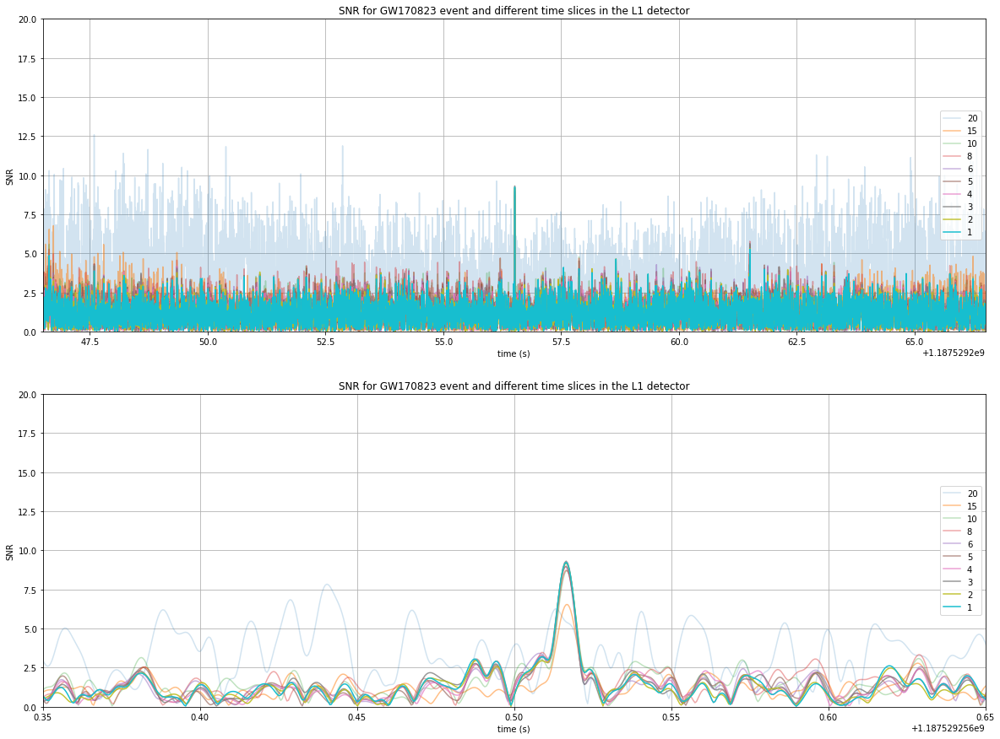

In [172]:
event="GW170823"
mergers=[]
time_slices=[20, 15, 10, 8, 6, 5, 4, 3, 2, 1]
alphas=[0.2, 0.5, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1, 1]
merger=Merger(event)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
data=merger.strain("L1").highpass_fir(15,512)
data=resample_to_delta_t(data, 1.0/2048).crop(2,2)
f=plt.figure(figsize=[20,15])
ax=f.subplots(nrows=2)
width=[10,0.15]
psds=[]

for i in range(2):
    for j in range(len(time_slices)):
        psd=data.psd(time_slices[j])
        psd=interpolate(psd, data.delta_f)
        psds.append(psd)
        hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
        hp.resize(len(psd))
        snr=matched_filter(hp, data, psd=psd, low_frequency_cutoff=20.)
        ax[i].plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    ax[i].legend(loc="right")
    ax[i].set_title("SNR for %s event and different time slices in the L1 detector" %event)
    ax[i].grid()
    ax[i].set_xlim(merger.time-width[i], merger.time+width[i])
    ax[i].set_ylim(0,20)
    ax[i].set_xlabel("time (s)")
    ax[i].set_ylabel("SNR") 
    

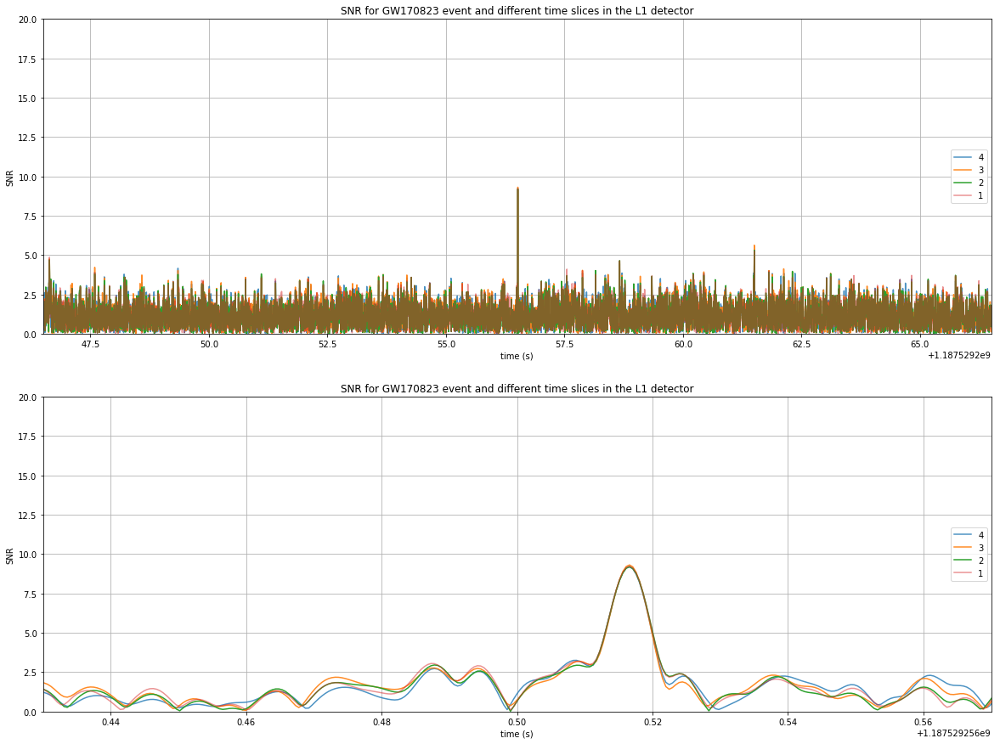

In [173]:
event="GW170823"
mergers=[]
time_slices=[ 4, 3, 2, 1]
alphas=[ 0.8, 0.9, 1, 0.5]
merger=Merger(event)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
data=merger.strain("L1").highpass_fir(15,512)
data=resample_to_delta_t(data, 1.0/2048).crop(2,2)
f=plt.figure(figsize=[20,15])
ax=f.subplots(nrows=2)
width=[10,0.07]
psds=[]

for i in range(2):
    for j in range(len(time_slices)):
        psd=data.psd(time_slices[j])
        psd=interpolate(psd, data.delta_f)
        psds.append(psd)
        hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
        hp.resize(len(psd))
        snr=matched_filter(hp, data, psd=psd, low_frequency_cutoff=20.)
        ax[i].plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    ax[i].legend(loc="right")
    ax[i].set_title("SNR for %s event and different time slices in the L1 detector" %event)
    ax[i].grid()
    ax[i].set_xlim(merger.time-width[i], merger.time+width[i])
    ax[i].set_ylim(0,20)
    ax[i].set_xlabel("time (s)")
    ax[i].set_ylabel("SNR") 
    

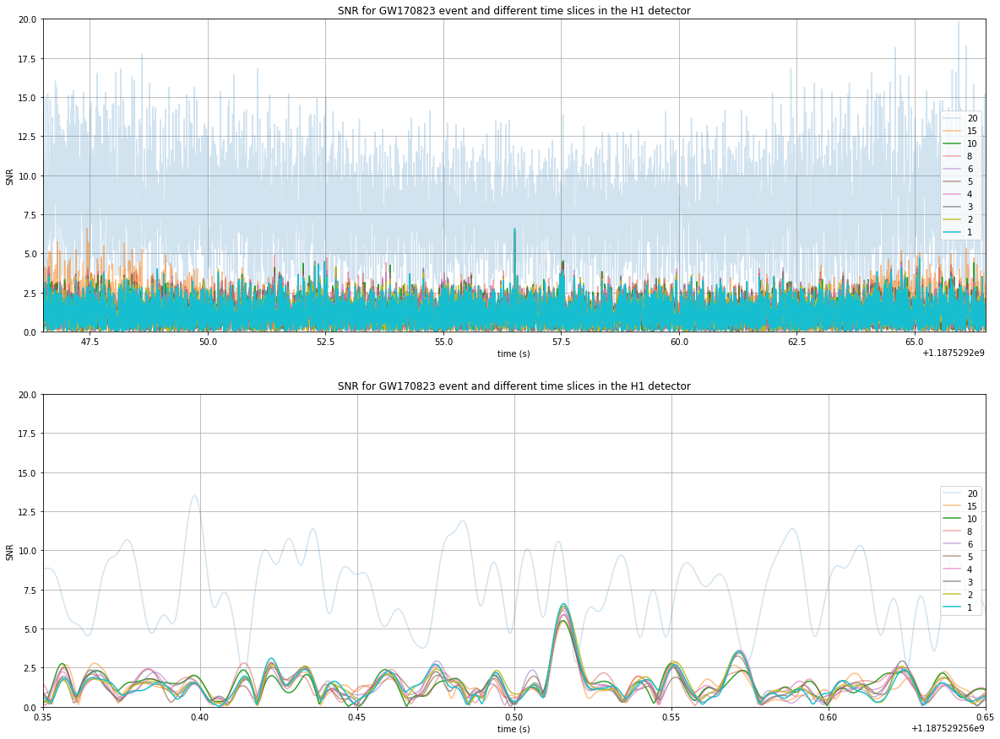

In [174]:
event="GW170823"
mergers=[]
time_slices=[20, 15, 10, 8, 6, 5, 4, 3, 2, 1]
alphas=[0.2, 0.5, 1, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1, 1]
merger=Merger(event)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
data=merger.strain("H1").highpass_fir(15,512)
data=resample_to_delta_t(data, 1.0/2048).crop(2,2)
f=plt.figure(figsize=[20,15])
ax=f.subplots(nrows=2)
width=[10,0.15]
psds=[]

for i in range(2):
    for j in range(len(time_slices)):
        psd=data.psd(time_slices[j])
        psd=interpolate(psd, data.delta_f)
        psds.append(psd)
        hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
        hp.resize(len(psd))
        snr=matched_filter(hp, data, psd=psd, low_frequency_cutoff=20.)
        ax[i].plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    ax[i].legend(loc="right")
    ax[i].set_title("SNR for %s event and different time slices in the H1 detector" %event)
    ax[i].grid()
    ax[i].set_xlim(merger.time-width[i], merger.time+width[i])
    ax[i].set_ylim(0,20)
    ax[i].set_xlabel("time (s)")
    ax[i].set_ylabel("SNR") 
    

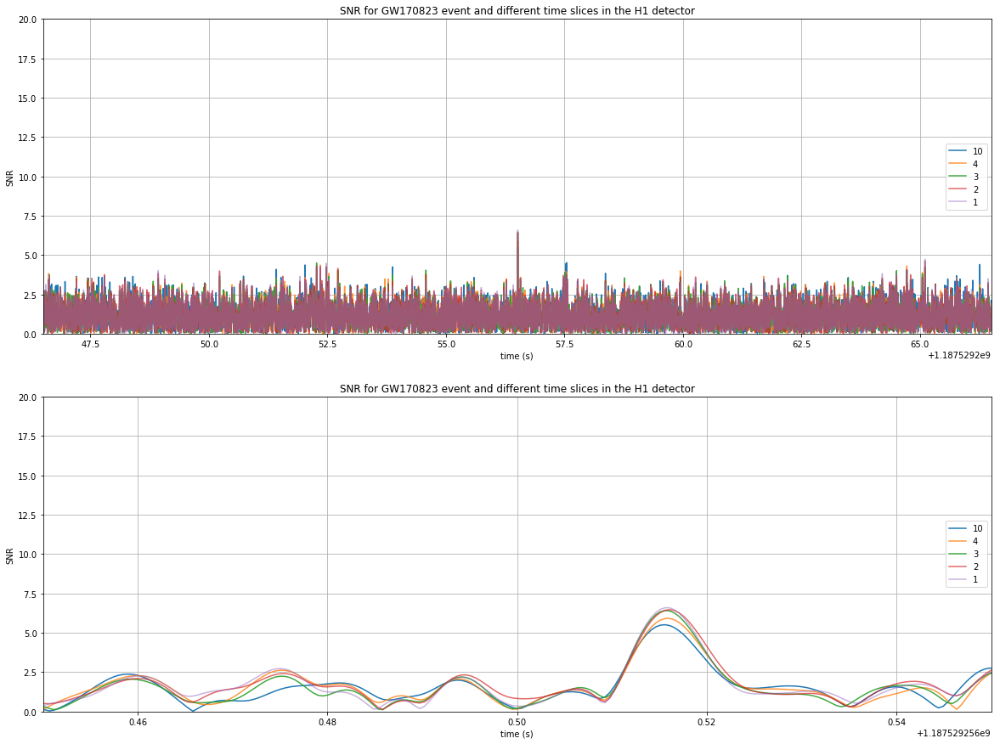

In [175]:
event="GW170823"
mergers=[]
time_slices=[ 10,4, 3, 2, 1]
alphas=[ 1,0.8, 0.9, 0.7, 0.5]
merger=Merger(event)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
data=merger.strain("H1").highpass_fir(15,512)
data=resample_to_delta_t(data, 1.0/2048).crop(2,2)
f=plt.figure(figsize=[20,15])
ax=f.subplots(nrows=2)
width=[10,0.05]
psds=[]

for i in range(2):
    for j in range(len(time_slices)):
        psd=data.psd(time_slices[j])
        psd=interpolate(psd, data.delta_f)
        psds.append(psd)
        hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
        hp.resize(len(psd))
        snr=matched_filter(hp, data, psd=psd, low_frequency_cutoff=20.)
        ax[i].plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    ax[i].legend(loc="right")
    ax[i].set_title("SNR for %s event and different time slices in the H1 detector" %event)
    ax[i].grid()
    ax[i].set_xlim(merger.time-width[i], merger.time+width[i])
    ax[i].set_ylim(0,20)
    ax[i].set_xlabel("time (s)")
    ax[i].set_ylabel("SNR") 
    

Event GW170729, LIGO detection, 2 black holes

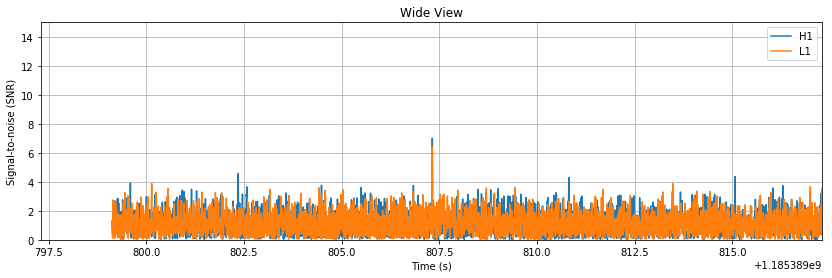

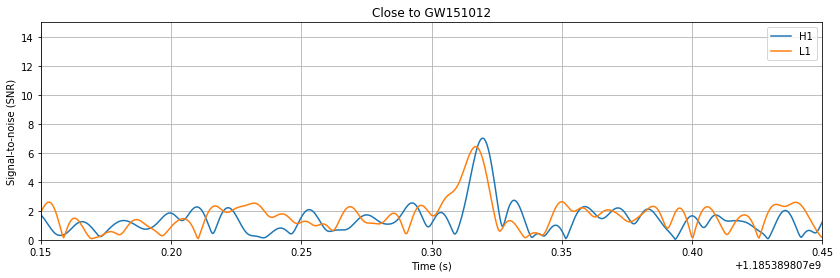

In [176]:
m = Merger("GW170729")

ifos = ['H1', 'L1']
data = {}
psd = {}


for ifo in ifos:
    # Read in and precondition the data
    ts = m.strain(ifo).highpass_fir(15, 512)
    data[ifo] = resample_to_delta_t(ts, 1.0/2048).crop(2, 2)

    # Estimate the power spectral density of the data
    # This chooses to use 2s samples in the PSD estimate.
    # One should note that the tradeoff in segment length is that
    # resolving narrow lines becomes more difficult.
    p = data[ifo].psd(2)
    p = interpolate(p, data[ifo].delta_f)
    p = inverse_spectrum_truncation(p, 2 * data[ifo].sample_rate, low_frequency_cutoff=15.0)
    psd[ifo] = p

cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data[ifo].delta_f)
hp.resize(len(psd[ifo]))
# For each observatory use this template to calculate the SNR time series
snr = {}
for ifo in ifos:
    snr[ifo] = matched_filter(hp, data[ifo], psd=psd[ifo], low_frequency_cutoff=20)
    snr[ifo] = snr[ifo].crop(5, 4)
for w, title in [(10, 'Wide View'), (.15, 'Close to GW151012')]:
    plt.figure(figsize=[14, 4])
    for ifo in ifos:
        plt.plot(snr[ifo].sample_times, abs(snr[ifo]), label=ifo)

    plt.legend()
    plt.title(title)
    plt.grid()
    plt.xlim(m.time - w, m.time + w)
    plt.ylim(0, 15)
    plt.xlabel('Time (s)')
    plt.ylabel('Signal-to-noise (SNR)')

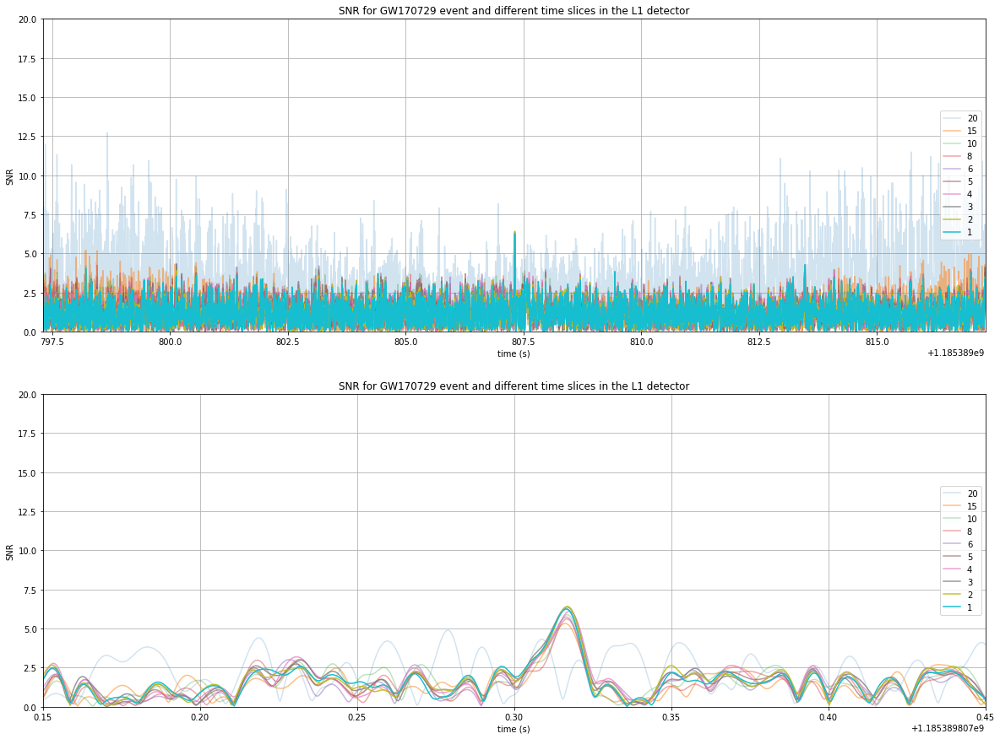

In [177]:
event="GW170729"
mergers=[]
time_slices=[20, 15, 10, 8, 6, 5, 4, 3, 2, 1]
alphas=[0.2, 0.5, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1, 1]
merger=Merger(event)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
data=merger.strain("L1").highpass_fir(15,512)
data=resample_to_delta_t(data, 1.0/2048).crop(2,2)
f=plt.figure(figsize=[20,15])
ax=f.subplots(nrows=2)
width=[10,0.15]
psds=[]

for i in range(2):
    for j in range(len(time_slices)):
        psd=data.psd(time_slices[j])
        psd=interpolate(psd, data.delta_f)
        psds.append(psd)
        hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
        hp.resize(len(psd))
        snr=matched_filter(hp, data, psd=psd, low_frequency_cutoff=20.)
        ax[i].plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    ax[i].legend(loc="right")
    ax[i].set_title("SNR for %s event and different time slices in the L1 detector" %event)
    ax[i].grid()
    ax[i].set_xlim(merger.time-width[i], merger.time+width[i])
    ax[i].set_ylim(0,20)
    ax[i].set_xlabel("time (s)")
    ax[i].set_ylabel("SNR") 
    

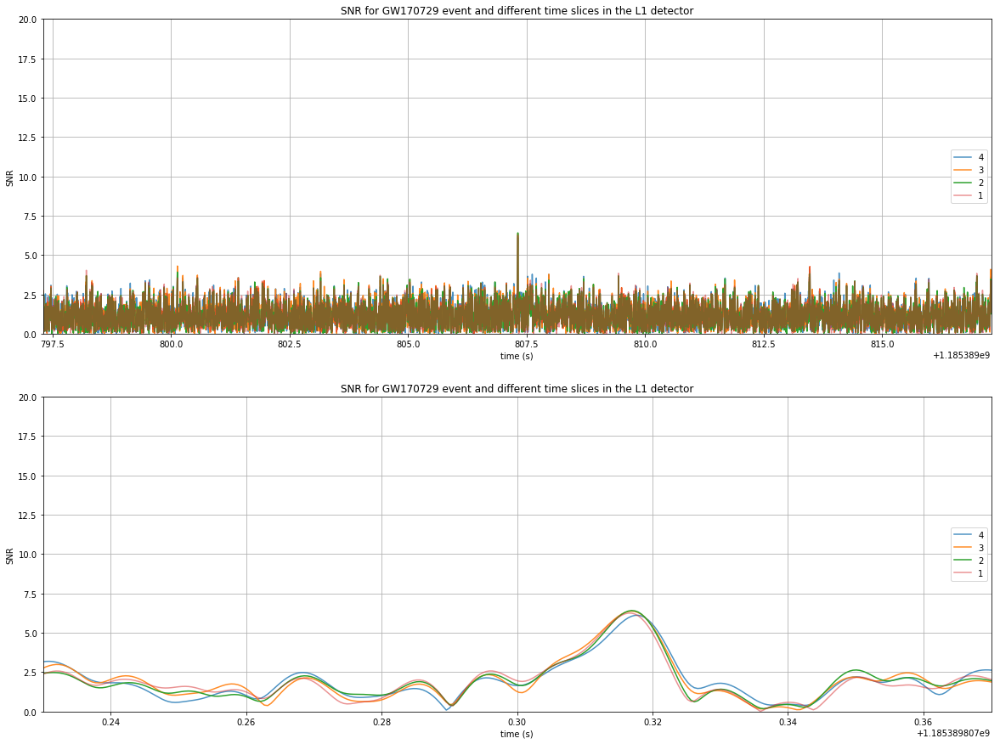

In [178]:
event="GW170729"
mergers=[]
time_slices=[ 4, 3, 2, 1]
alphas=[ 0.8, 0.9, 1, 0.5]
merger=Merger(event)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
data=merger.strain("L1").highpass_fir(15,512)
data=resample_to_delta_t(data, 1.0/2048).crop(2,2)
f=plt.figure(figsize=[20,15])
ax=f.subplots(nrows=2)
width=[10,0.07]
psds=[]

for i in range(2):
    for j in range(len(time_slices)):
        psd=data.psd(time_slices[j])
        psd=interpolate(psd, data.delta_f)
        psds.append(psd)
        hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
        hp.resize(len(psd))
        snr=matched_filter(hp, data, psd=psd, low_frequency_cutoff=20.)
        ax[i].plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    ax[i].legend(loc="right")
    ax[i].set_title("SNR for %s event and different time slices in the L1 detector" %event)
    ax[i].grid()
    ax[i].set_xlim(merger.time-width[i], merger.time+width[i])
    ax[i].set_ylim(0,20)
    ax[i].set_xlabel("time (s)")
    ax[i].set_ylabel("SNR") 
    

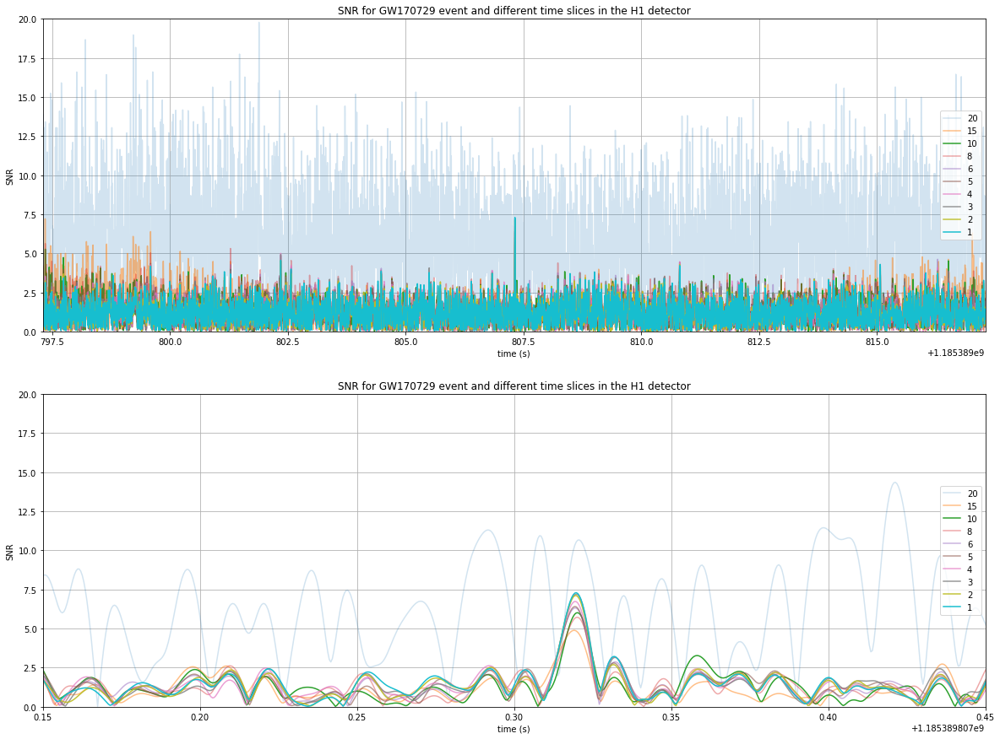

In [179]:
event="GW170729"
mergers=[]
time_slices=[20, 15, 10, 8, 6, 5, 4, 3, 2, 1]
alphas=[0.2, 0.5, 1, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1, 1]
merger=Merger(event)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
data=merger.strain("H1").highpass_fir(15,512)
data=resample_to_delta_t(data, 1.0/2048).crop(2,2)
f=plt.figure(figsize=[20,15])
ax=f.subplots(nrows=2)
width=[10,0.15]
psds=[]

for i in range(2):
    for j in range(len(time_slices)):
        psd=data.psd(time_slices[j])
        psd=interpolate(psd, data.delta_f)
        psds.append(psd)
        hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
        hp.resize(len(psd))
        snr=matched_filter(hp, data, psd=psd, low_frequency_cutoff=20.)
        ax[i].plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    ax[i].legend(loc="right")
    ax[i].set_title("SNR for %s event and different time slices in the H1 detector" %event)
    ax[i].grid()
    ax[i].set_xlim(merger.time-width[i], merger.time+width[i])
    ax[i].set_ylim(0,20)
    ax[i].set_xlabel("time (s)")
    ax[i].set_ylabel("SNR") 
    

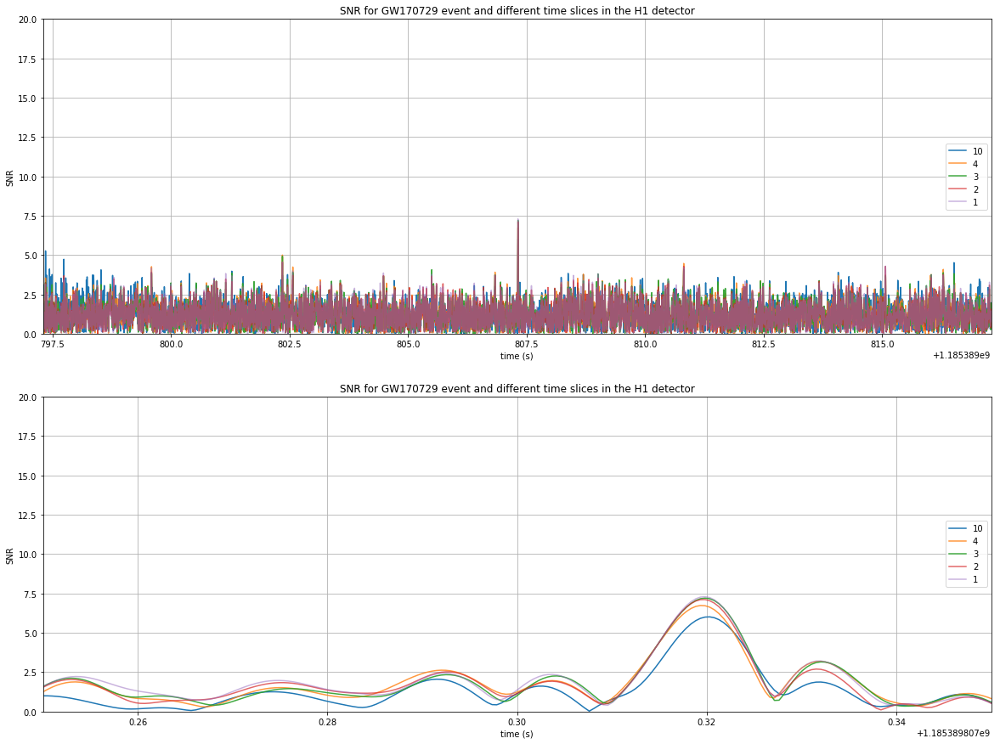

In [180]:
event="GW170729"
mergers=[]
time_slices=[ 10,4, 3, 2, 1]
alphas=[ 1,0.8, 0.9, 0.7, 0.5]
merger=Merger(event)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
data=merger.strain("H1").highpass_fir(15,512)
data=resample_to_delta_t(data, 1.0/2048).crop(2,2)
f=plt.figure(figsize=[20,15])
ax=f.subplots(nrows=2)
width=[10,0.05]
psds=[]

for i in range(2):
    for j in range(len(time_slices)):
        psd=data.psd(time_slices[j])
        psd=interpolate(psd, data.delta_f)
        psds.append(psd)
        hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
        hp.resize(len(psd))
        snr=matched_filter(hp, data, psd=psd, low_frequency_cutoff=20.)
        ax[i].plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    ax[i].legend(loc="right")
    ax[i].set_title("SNR for %s event and different time slices in the H1 detector" %event)
    ax[i].grid()
    ax[i].set_xlim(merger.time-width[i], merger.time+width[i])
    ax[i].set_ylim(0,20)
    ax[i].set_xlabel("time (s)")
    ax[i].set_ylabel("SNR") 
    

Now we try to make the analysis of the triple detection of the BNS work. In order to see if the signal is present, we perform the complete analysis of the detection, in order to see better what happens.

In [11]:
from pycbc.catalog import Merger
import matplotlib.pyplot as plt
m= Merger("GW170817")
ts_han=m.strain('H1')
ts_liv=m.strain('L1')
ts_vir=m.strain('V1')

print("Duration: {}s Start: {} End: {}".format(ts_han.duration, 
                                              int(ts_han.start_time),
                                              int(ts_han.end_time)))

Duration: 32.0s Start: 1187008867 End: 1187008899


In [12]:
data={}
for i in ['H1', 'L1','V1']:
    data[i]=m.strain(i)


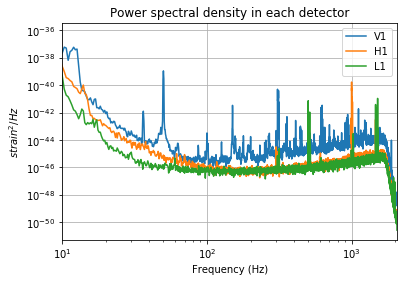

In [13]:
for i in data:
    psd=data[i].psd(3)
    plt.loglog(psd.sample_frequencies, psd, label=i)
plt.xlabel("Frequency (Hz)")
plt.ylabel("$strain^2/Hz$")
plt.xlim(10,2048)
plt.legend(loc="best")
plt.title("Power spectral density in each detector")
plt.grid()

In [14]:
whitened={}
for i in data:
    whitened[i]=data[i].whiten(4,4)

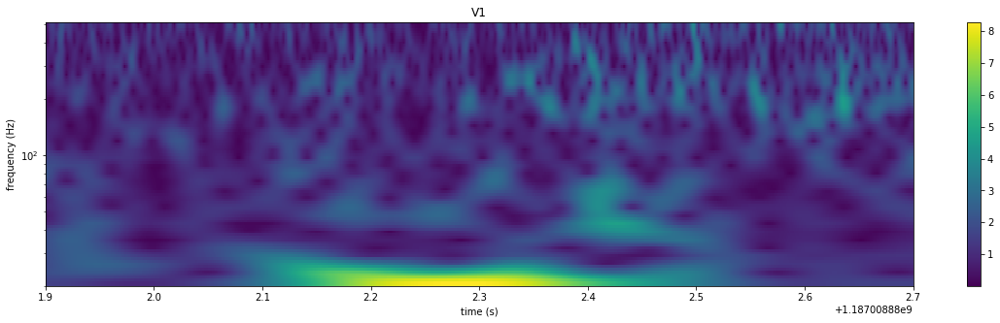

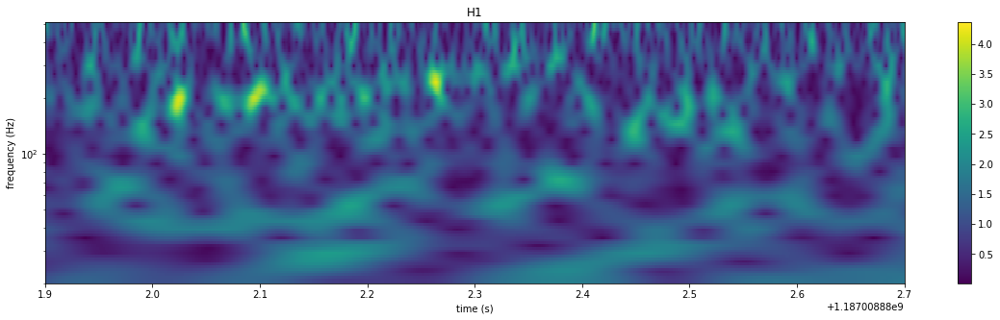

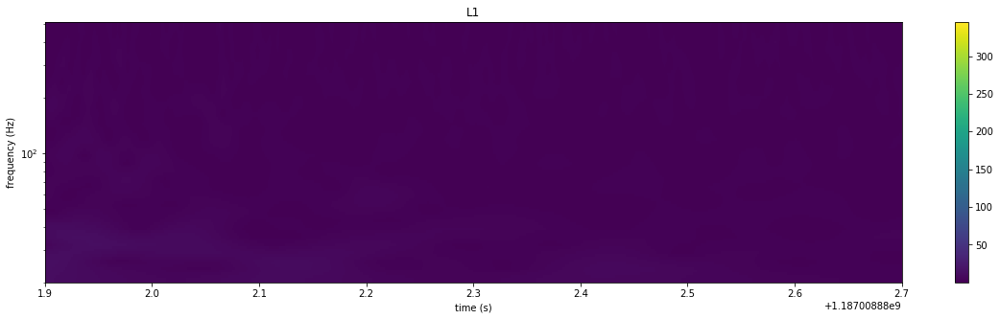

In [15]:
for i in whitened:
    zoom=whitened[i].time_slice(m.time-5, m.time+5)
    times, freqs, power = zoom.qtransform(0.001, logfsteps=100 , qrange=(10,10), frange=(20,512))
    plt.figure(figsize=(20,5))
    plt.pcolormesh(times, freqs, power**0.5)
    plt.xlim(m.time-0.5, m.time+0.3)
    plt.title(i)
    plt.yscale('log')
    plt.xlabel("time (s)")
    plt.ylabel("frequency (Hz)")
    plt.colorbar()

# Test of taking the sqrt of the PSD
In the papers published by LIGO-Virgo, the PSD is often showed with SQRT of th PSD represented above. So, we take the SQRT as well in order to be able to compare with their figures

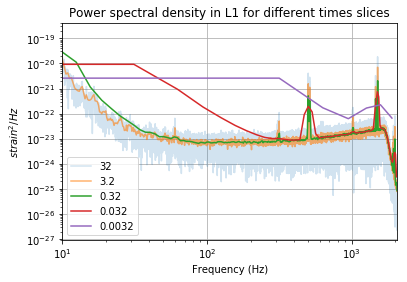

In [6]:
from pycbc.catalog import Merger
import math
import matplotlib.pyplot as plt

m=Merger("GW170814")

data={}
detectors=['L1', 'H1', 'V1']

for det in detectors:
    data[det]=m.strain(det)
    
times=[32,3.2,0.32,0.032, 0.0032]
alpha=[0.2,0.6,1,2,5]

for i in range(len(times)):
    psd=data["L1"].psd(times[i])
    sqrt_psd=[]
    for j in range(len(psd)):
        sqrt_psd.append(math.sqrt(psd[j]))
    plt.loglog(psd.sample_frequencies, sqrt_psd, alpha=alpha[i],label=times[i])
    
plt.xlabel("Frequency (Hz)")
plt.ylabel("$strain^2/Hz$")
plt.xlim(10,2048)
plt.legend(loc="best")
plt.title("Power spectral density in L1 for different times slices")
plt.grid()

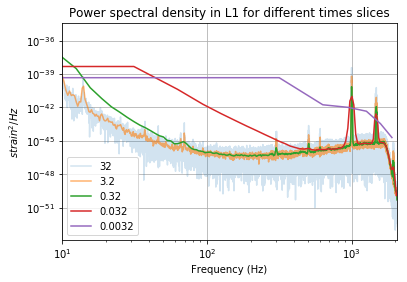

In [7]:
from pycbc.catalog import Merger
import math
import matplotlib.pyplot as plt

m=Merger("GW170814")

data={}
detectors=['L1', 'H1', 'V1']

for det in detectors:
    data[det]=m.strain(det)
    
times=[32,3.2,0.32,0.032, 0.0032]
alpha=[0.2,0.6,1,2,5]

for i in range(len(times)):
    psd=data["H1"].psd(times[i])
    plt.loglog(psd.sample_frequencies, psd, alpha=alpha[i],label=times[i])
    
plt.xlabel("Frequency (Hz)")
plt.ylabel("$strain^2/Hz$")
plt.xlim(10,2048)
plt.legend(loc="best")
plt.title("Power spectral density in L1 for different times slices")
plt.grid()

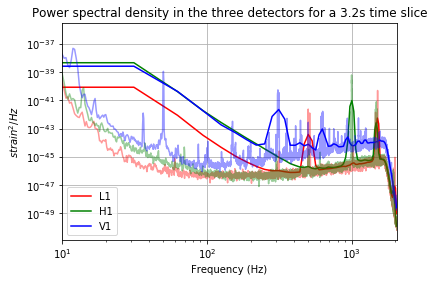

In [14]:

colors=["red", "green", "blue"]
i=0
for detec in detectors:
    psd=data[detec].psd(0.032)
    plt.loglog(psd.sample_frequencies, psd, color=colors[i], alpha=1,label=detec)
    i+=1
i=0
for detec in detectors:
    psd=data[detec].psd(3.2)
    plt.loglog(psd.sample_frequencies, psd, color=colors[i], alpha=0.4)
    i+=1
    
plt.xlabel("Frequency (Hz)")
plt.ylabel("$strain^2/Hz$")
plt.xlim(10,2048)
plt.legend(loc="best")
plt.title("Power spectral density in the three detectors for a 3.2s time slice")
plt.grid()

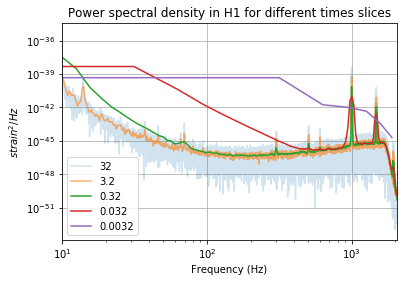

In [10]:
from pycbc.catalog import Merger
import math
import matplotlib.pyplot as plt

m=Merger("GW170814")

data={}
detectors=['L1', 'H1', 'V1']

for det in detectors:
    data[det]=m.strain(det)
    
times=[32,3.2,0.32,0.032, 0.0032]
alpha=[0.2,0.6,1,2,5]

for i in range(len(times)):
    psd=data["H1"].psd(times[i])
    plt.loglog(psd.sample_frequencies, psd, alpha=alpha[i],label=times[i])
    
plt.xlabel("Frequency (Hz)")
plt.ylabel("$strain^2/Hz$")
plt.xlim(10,2048)
plt.legend(loc="best")
plt.title("Power spectral density in H1 for different times slices")
plt.grid()

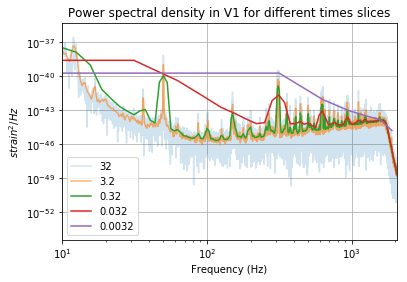

In [12]:
from pycbc.catalog import Merger
import math
import matplotlib.pyplot as plt

m=Merger("GW170814")

data={}
detectors=['L1', 'H1', 'V1']

for det in detectors:
    data[det]=m.strain(det)
    
times=[32,3.2,0.32,0.032, 0.0032]
alpha=[0.2,0.6,1,2,5]

for i in range(len(times)):
    psd=data["V1"].psd(times[i])
    plt.loglog(psd.sample_frequencies, psd, alpha=alpha[i],label=times[i])
    
plt.xlabel("Frequency (Hz)")
plt.ylabel("$strain^2/Hz$")
plt.xlim(10,2048)
plt.legend(loc="best")
plt.title("Power spectral density in V1 for different times slices")
plt.grid()

# Test of reweighing the value of the SNR found for 15 and 20s time slices
The peaks found in the SNR does not show up for the 20 second time slice and is less well present for a 20 second time slice. SO, we can reweigh them in order to see if the peak eventually shows up or if it stays hidden

Text(0,0.5,'SNR')

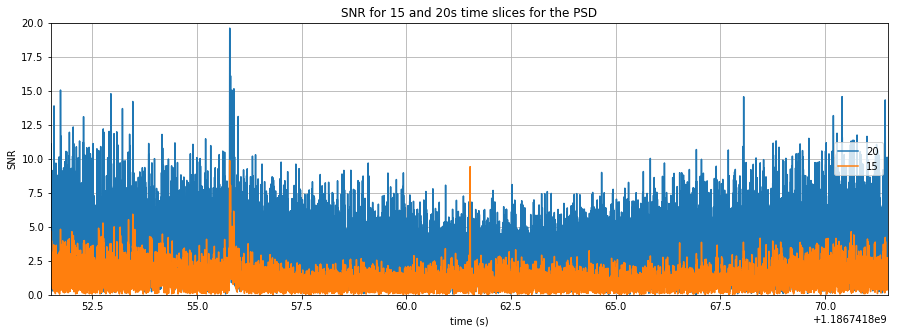

In [16]:
from pycbc.filter import resample_to_delta_t, highpass
from pycbc.catalog import Merger
from pycbc.psd import interpolate, inverse_spectrum_truncation
from pycbc.waveform import get_td_waveform, get_fd_waveform
from pycbc.filter import matched_filter

m=Merger("GW170814")

#simple SNR for given times
time_slices=[ 20, 15]
alphas=[1, 1]
psd=[]
ts=m.strain("L1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2,2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR for 15 and 20s time slices for the PSD")
plt.grid()
plt.xlim(m.time-10, m.time+10)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0.5,1,'Normalized chi square statistic')

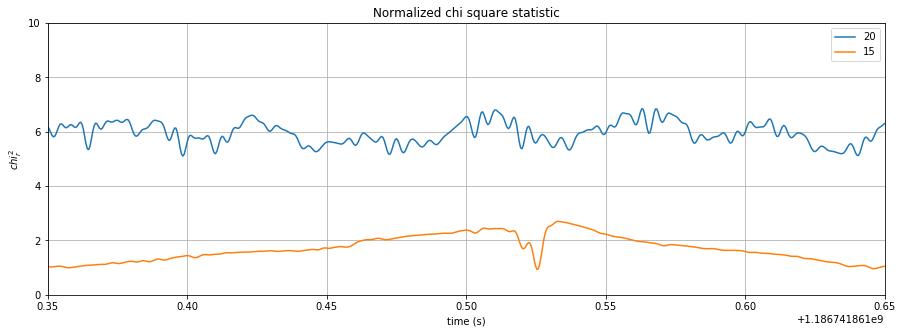

In [24]:
#chi square statistic
from pycbc.vetoes import power_chisq
chis=[]
for i in range(len(time_slices)):
    p=26
    chi=power_chisq(hp,data, p, psd[i], low_frequency_cutoff=20.0)
    chi=chi.crop(5,4)
    dof=p*2-2
    chi/=dof #normalization of the statistic
    chis.append(chi)


plt.figure(figsize=(15,5))
for i in range(len(time_slices)):
    plt.plot(chis[i].sample_times, chis[i], label=time_slices[i])
plt.legend(loc="best")
plt.grid()
plt.xlim(m.time-0.15, m.time+0.15)
plt.ylim(0,10)
plt.ylabel('$chi^2_r$')
plt.xlabel('time (s)')
plt.title("Normalized chi square statistic")

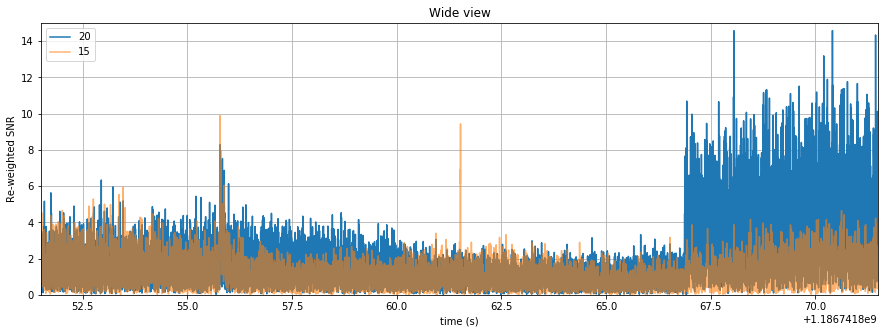

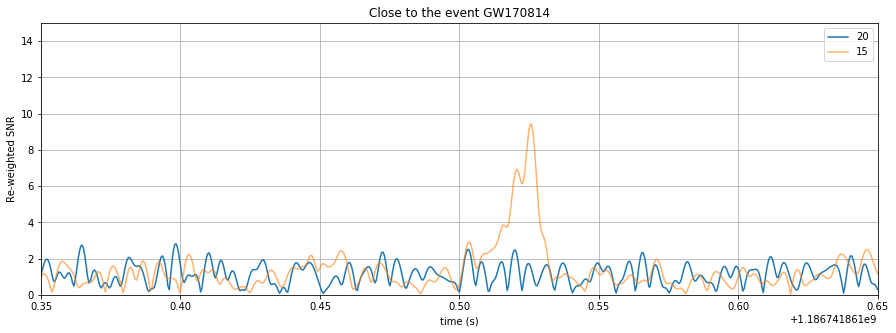

In [30]:
#reweighing based on the chi square test
from pycbc.events.ranking import newsnr
#newsnr correponds to the rho hat defined above and can thus be foud directly here with a build in function
nsnr = [newsnr(abs(snrs[i]), chis[i]) for i in range(len(time_slices))]
alphas=[1,0.6]
#we represnt the new SNR time series
for w, title in [(10, "Wide view"), (0.15, "Close to the event GW170814")]:
    plt.figure(figsize=(15,5))
    for i in range(len(time_slices)):
        plt.plot(snrs[i].sample_times,  nsnr[i], label=time_slices[i], alpha=alphas[i])
    plt.legend(loc="best")
    plt.title(title)
    plt.grid()
    plt.xlim(m.time-w, m.time+w)
    plt.ylim(0,15)
    plt.xlabel("time (s)")
    plt.ylabel("Re-weighted SNR")

Text(0,0.5,'SNR')

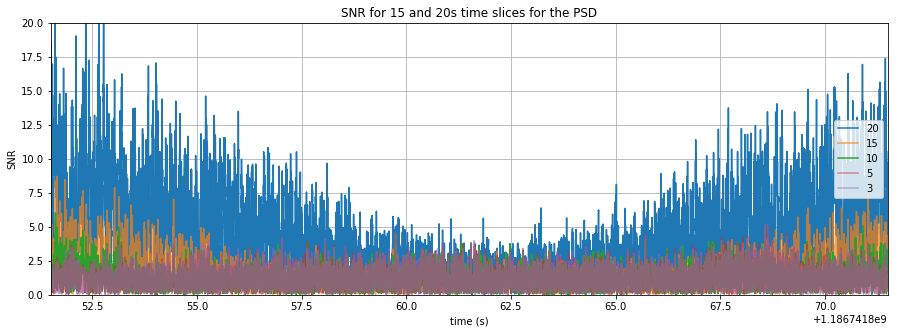

In [3]:
%matplotlib inline
import matplotlib.pyplot as plt
from pycbc.filter import resample_to_delta_t, highpass
from pycbc.catalog import Merger
from pycbc.psd import interpolate, inverse_spectrum_truncation
from pycbc.waveform import get_td_waveform, get_fd_waveform
from pycbc.filter import matched_filter

m=Merger("GW170814")

#simple SNR for given times
time_slices=[ 20, 15, 10, 5, 3]
alphas=[1, 0.7, 1, 0.5,0.5]
psd=[]
ts=m.strain("V1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2,2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR for 15 and 20s time slices for the PSD")
plt.grid()
plt.xlim(m.time-10, m.time+10)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0,0.5,'SNR')

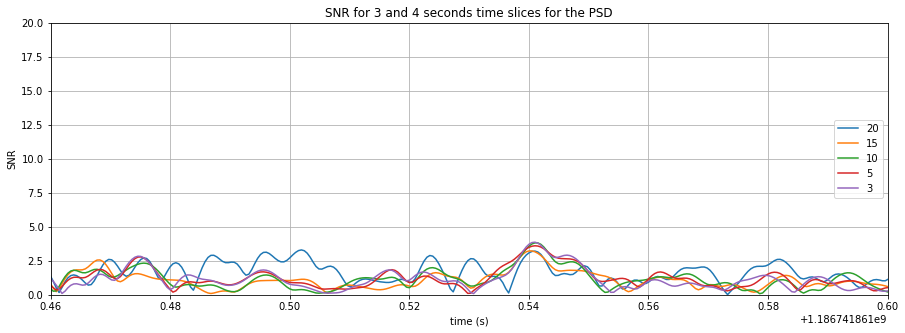

In [5]:
#zoom
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR for 3 and 4 seconds time slices for the PSD")
plt.grid()
plt.xlim(m.time-0.04, m.time+0.1)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0,0.5,'SNR')

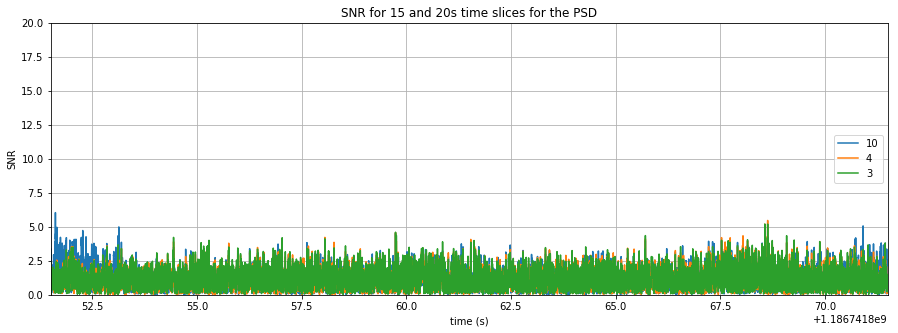

In [10]:
%matplotlib inline
import matplotlib.pyplot as plt
from pycbc.filter import resample_to_delta_t, highpass
from pycbc.catalog import Merger
from pycbc.psd import interpolate, inverse_spectrum_truncation
from pycbc.waveform import get_td_waveform, get_fd_waveform
from pycbc.filter import matched_filter

m=Merger("GW170814")

#simple SNR for given times
time_slices=[ 10, 4, 3]
alphas=[1, 1, 1]
psd=[]
ts=m.strain("V1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2,2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR for 15 and 20s time slices for the PSD")
plt.grid()
plt.xlim(m.time-10, m.time+10)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0,0.5,'SNR')

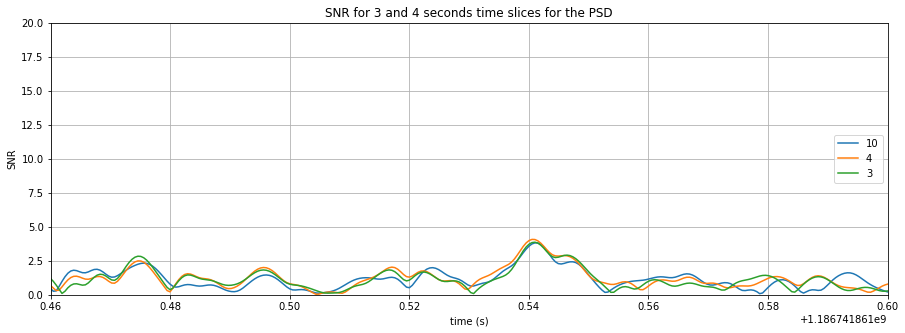

In [11]:
#zoom
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), alpha=alphas[j],label=time_slices[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR for 3 and 4 seconds time slices for the PSD")
plt.grid()
plt.xlim(m.time-0.04, m.time+0.1)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0,0.5,'SNR')

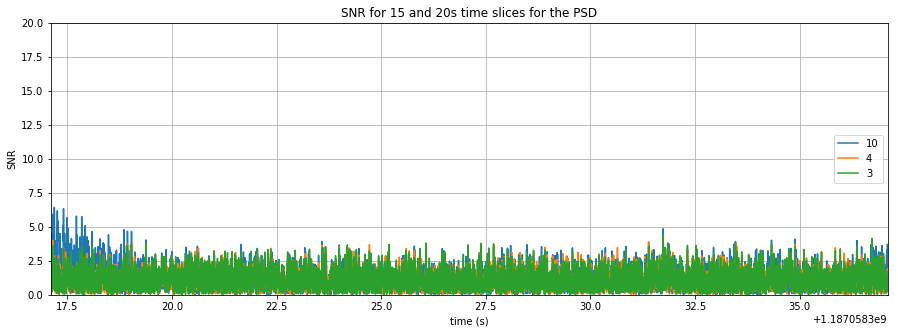

In [14]:
m=Merger("GW170818")

#simple SNR for given times
time_slices=[ 10, 4, 3]
alphas=[1, 1, 1]
psd=[]
ts=m.strain("V1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2,2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)
cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR for 15 and 20s time slices for the PSD")
plt.grid()
plt.xlim(m.time-10, m.time+10)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0,0.5,'SNR')

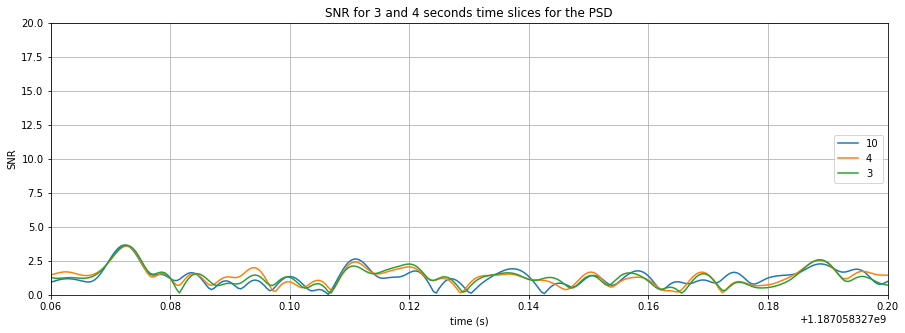

In [15]:
#zoom
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), alpha=alphas[j],label=time_slices[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR for 3 and 4 seconds time slices for the PSD")
plt.grid()
plt.xlim(m.time-0.04, m.time+0.1)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

We found a signal at 1186741855.7763672s with a SNR of 18.0440472 for the 20 time slice
We found a signal at 1186741855.7788086s with a SNR of 9.8346014 for the 15 time slice
We found a signal at 1186741861.5244141s with a SNR of 11.4435385 for the 10 time slice
We found a signal at 1186741861.5244141s with a SNR of 12.6455890 for the 5 time slice
We found a signal at 1186741861.5244141s with a SNR of 13.1807208 for the 3 time slice
We found a signal at 1186741861.5244141s with a SNR of 12.7753805 for the 1 time slice
56832


Text(0,0.5,'SNR')

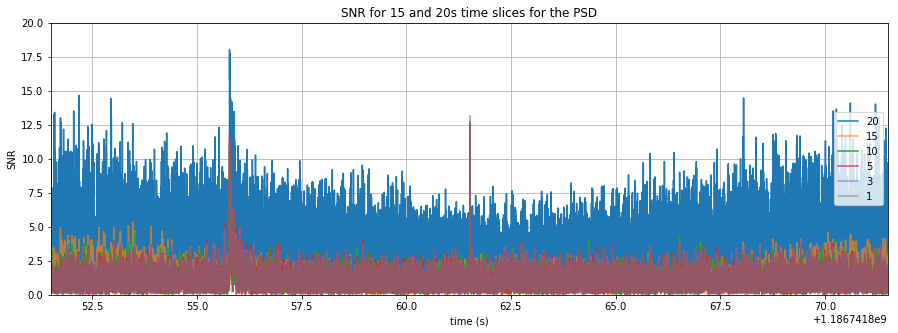

In [33]:
%matplotlib inline
import matplotlib.pyplot as plt
from pycbc.filter import resample_to_delta_t, highpass
from pycbc.catalog import Merger
from pycbc.psd import interpolate, inverse_spectrum_truncation
from pycbc.waveform import get_td_waveform, get_fd_waveform
from pycbc.filter import matched_filter

m=Merger("GW170814")

#simple SNR for given times
time_slices=[20, 15, 10, 5 , 3,1]
alphas=[1, 0.7, 1, 0.8, 0.6 , 0.5]
psd=[]
peaks=[0 for i in range(len(time_slices))]
snrp=[0 for i in range(len(time_slices))]
times=[0 for i in range(len(time_slices))]
ts=m.strain("L1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2,2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)
snrs=[]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, hf = get_fd_waveform(approximant="IMRPhenomD",
                         mass1=30.5, mass2=25.3, spin1z=-0.56879753, spin2z=0.13079314, distance=540, inclination=0.6,
                         f_lower=20.0, delta_f=data.delta_f, f_final=739.0645)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
    peaks[j]=abs(snr).numpy().argmax()
    snrp[j]=snr[peaks[j]]
    times[j]=snr.sample_times[peaks[j]]
    print("We found a signal at %.7fs with a SNR of %.7f for the %i time slice" %(times[j], abs(snrp[j]), time_slices[j]))
print(len(snr))
plt.legend(loc="right")
plt.title("SNR for 15 and 20s time slices for the PSD")
plt.grid()
plt.xlim(m.time-10, m.time+10)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

We found a signal at 1186741848.1445312s with a SNR of 88.5779296 for the 20 time slice
We found a signal at 1186741848.1445312s with a SNR of 70.2807352 for the 15 time slice
We found a signal at 1186741848.1445312s with a SNR of 62.0487366 for the 10 time slice
We found a signal at 1186741848.1450195s with a SNR of 57.1116273 for the 5 time slice
We found a signal at 1186741848.1450195s with a SNR of 54.2580852 for the 3 time slice
We found a signal at 1186741848.1450195s with a SNR of 51.2620509 for the 1 time slice


Text(0,0.5,'SNR')

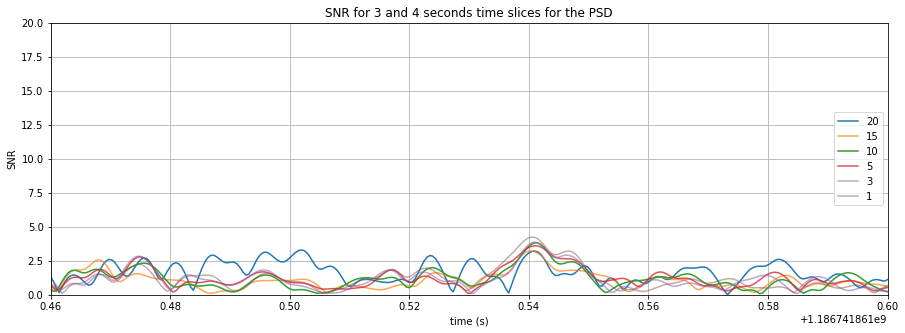

In [25]:
#zoom
plt.figure(figsize=[15,5])
peaks=[0 for i in range(len(time_slices))]
snrp=[0 for i in range(len(time_slices))]
times=[0 for i in range(len(time_slices))]
for j in range(len(time_slices)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=data.delta_f)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), alpha=alphas[j],label=time_slices[j])
    snrs.append(snr)
    snrs.append(snr)
    peaks[j]=abs(snr).numpy().argmax()
    snrp[j]=snr[peaks[j]]
    times[j]=snr.sample_times[peaks[j]]
    print("We found a signal at %.7fs with a SNR of %.7f for the %i time slice" %(times[j], abs(snrp[j]), time_slices[j]))
plt.legend(loc="right")
plt.title("SNR for 3 and 4 seconds time slices for the PSD")
plt.grid()
plt.xlim(m.time-0.04, m.time+0.1)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

We found a signal at 1186741848.1391602s with a SNR of 89.8476937 for the 20 time slice
We found a signal at 1186741848.1430664s with a SNR of 70.9870183 for the 15 time slice
We found a signal at 1186741848.1430664s with a SNR of 63.0313746 for the 10 time slice
We found a signal at 1186741848.1430664s with a SNR of 57.9643255 for the 5 time slice
We found a signal at 1186741848.1435547s with a SNR of 55.0185422 for the 3 time slice
We found a signal at 1186741848.1435547s with a SNR of 51.4111909 for the 1 time slice


Text(0,0.5,'SNR')

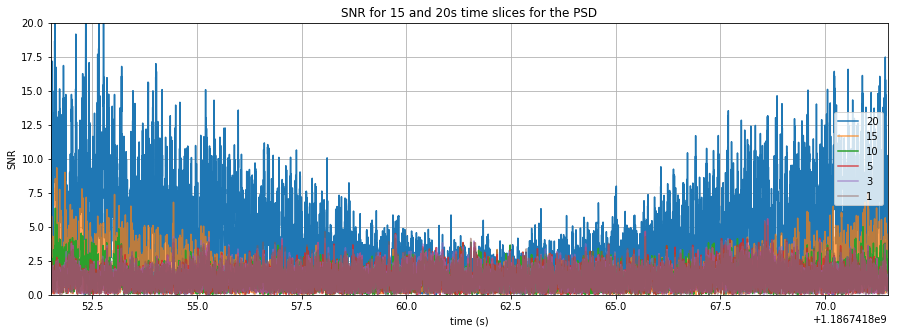

In [24]:
%matplotlib inline
import matplotlib.pyplot as plt
from pycbc.filter import resample_to_delta_t, highpass
from pycbc.catalog import Merger
from pycbc.psd import interpolate, inverse_spectrum_truncation
from pycbc.waveform import get_td_waveform, get_fd_waveform
from pycbc.filter import matched_filter

m=Merger("GW170814")

#simple SNR for given times
time_slices=[20, 15, 10, 5 , 3,1]
alphas=[1, 0.7, 1, 0.8, 0.6 , 0.5]
psd=[]
peaks=[0 for i in range(len(time_slices))]
snrp=[0 for i in range(len(time_slices))]
times=[0 for i in range(len(time_slices))]
ts=m.strain("V1").highpass_fir(15,512)
data=resample_to_delta_t(ts, 1.0/2048).crop(2,2)
for i in range(len(time_slices)):
    p=data.psd(time_slices[i])
    p=interpolate(p, data.delta_f)
    p=inverse_spectrum_truncation(p, time_slices[i]*data.sample_rate, low_frequency_cutoff=15.0 )
    psd.append(p)
snrs=[]
plt.figure(figsize=[15,5])
for j in range(len(time_slices)):
    hp, hf = get_fd_waveform(approximant="IMRPhenomD",
                         mass1=30.5, mass2=25.3, spin1z=-0.56879753, spin2z=0.13079314, distance=540, inclination=0.6,
                         f_lower=20.0, delta_f=data.delta_f, f_final=739.0645)
    hp.resize(len(psd[j]))
    snr=matched_filter(hp, data, psd=psd[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=time_slices[j], alpha=alphas[j])
    snrs.append(snr)
    peaks[j]=abs(snr).numpy().argmax()
    snrp[j]=snr[peaks[j]]
    times[j]=snr.sample_times[peaks[j]]
    print("We found a signal at %.7fs with a SNR of %.7f for the %i time slice" %(times[j], abs(snrp[j]), time_slices[j]))
plt.legend(loc="right")
plt.title("SNR for 15 and 20s time slices for the PSD")
plt.grid()
plt.xlim(m.time-10, m.time+10)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

# Influence of the window used on the PSD
IN Welch's method, the hann window is used by default. However, other more fancy window can be used. These can potentially give better results than in the case of the normal hann window. Therefore, here, we test what happens when the window used is changed. In order to do so, the time slice is fixed and we keep no specification for the overlap in time

In [35]:
m=Merger("GW170814")

#data download for all the detector
data={}
detectors=['L1', 'H1', 'V1']

for detec in detectors:
    data[detec]=m.strain(detec)

In [64]:
#obtain the different windows in different cases
import scipy
d=data["L1"] #for the moement, we work only for one detector
boxcar_win=scipy.signal.get_window("boxcar", 4096) #first normal hann window
print(len(d))

131072


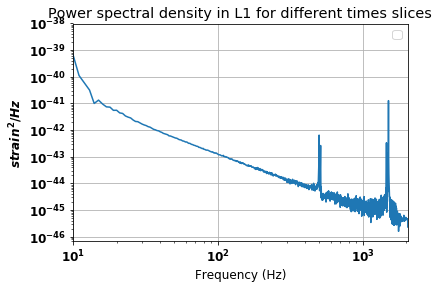

In [106]:
import matplotlib
import matplotlib.pyplot as plt
font = {'family' : 'normal',
        'weight' : 'bold',
        'size'   : 12}

matplotlib.rc('font', **font)


from pycbc.psd.estimate import welch
psd=welch(d, seg_len=4096, seg_stride=2048, window=boxcar_win, num_segments=8)
plt.loglog(psd.sample_frequencies, psd)
plt.xlabel("Frequency (Hz)")
plt.ylabel("$strain^2/Hz$")
plt.xlim(10,2048)
plt.legend(loc="best")
plt.title("Power spectral density in L1 for different times slices")
plt.grid()

In [109]:
#compare the PSD obtained for Welch method and different window types
possible_windows=["boxcar", "blackman", "hamming", "hann", "flattop", "bohman", "nuttall"]
windows=[0 for i in range(len(possible_windows))]
for i in range(len(possible_windows)):
    windows[i]=scipy.signal.get_window(possible_windows[i], 4096)

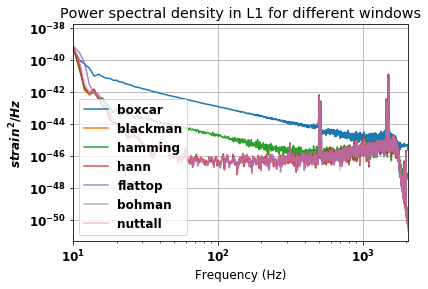

In [110]:
psds=[0 for i in range(len(possible_windows))]
alphas=[1,1,1,0.8,0.8,0.5,0.5]
for j in range(len(possible_windows)):
    psds[j]=welch(d, seg_len=4096, seg_stride=2048, window=windows[j], num_segments=8)
    plt.loglog(psds[j].sample_frequencies, psds[j],alpha=alphas[j], label=possible_windows[j])
plt.xlabel("Frequency (Hz)")
plt.ylabel("$strain^2/Hz$")
plt.xlim(10,2048)
plt.legend(loc="best")
plt.title("Power spectral density in L1 for different windows")
plt.grid()

In [111]:
import matplotlib
import matplotlib.pyplot as plt
font = {'family' : 'normal',
        'weight' : 'bold',
        'size'   : 12}

matplotlib.rc('font', **font)


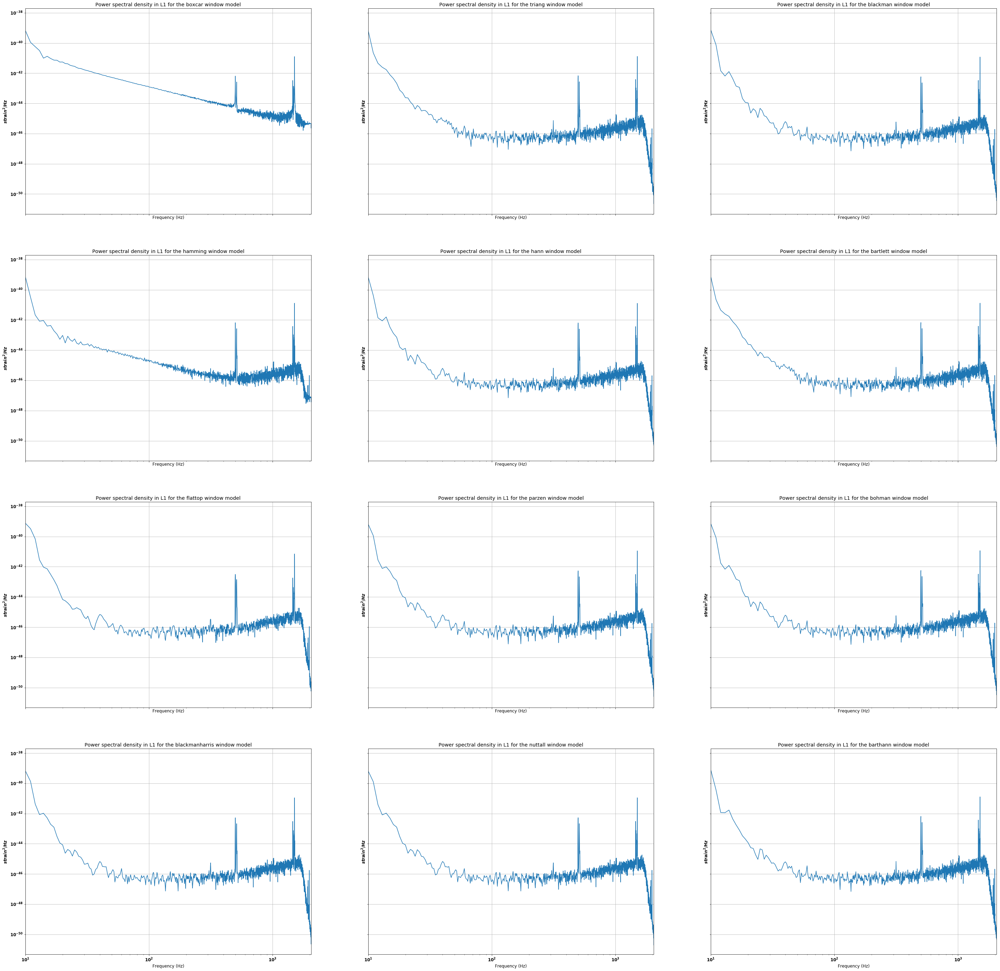

In [115]:
#download of different windows
possible_windows=["boxcar", "triang", "blackman", "hamming", "hann", "bartlett", "flattop", "parzen",
                  "bohman", "blackmanharris", "nuttall", "barthann"]
windows=[0 for i in range(len(possible_windows))]
for i in range(len(possible_windows)):
    windows[i]=scipy.signal.get_window(possible_windows[i], 4096)
#computation of the psds for these different windows   
psds=[0 for i in range(len(possible_windows))]
for j in range(len(possible_windows)):
    psds[j]=welch(d, seg_len=4096, seg_stride=2048, window=windows[j], num_segments=8)
#figure
f=plt.figure(figsize=[50,50])
ax=f.subplots(nrows=4, ncols=3, sharex= True, sharey=True)
k=0
for i in range(4):
    for j in range(3):
        ax[i][j].loglog(psds[k].sample_frequencies, psds[k], label=possible_windows[k])
        ax[i][j].set_xlabel("Frequency (Hz)")
        ax[i][j].set_ylabel("$strain^2/Hz$")
        ax[i][j].set_xlim(10,2048)
        ax[i][j].set_title("Power spectral density in L1 for the %s window model" %possible_windows[k])
        ax[i][j].grid()
        k+=1

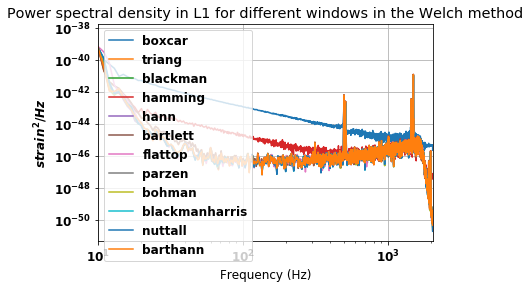

In [116]:
possible_windows=["boxcar", "triang", "blackman", "hamming", "hann", "bartlett", "flattop", "parzen",
                  "bohman", "blackmanharris", "nuttall", "barthann"]
windows=[0 for i in range(len(possible_windows))]
for i in range(len(possible_windows)):
    windows[i]=scipy.signal.get_window(possible_windows[i], 4096)
#computation of the psds for these different windows   
psds=[0 for i in range(len(possible_windows))]
for j in range(len(possible_windows)):
    psds[j]=welch(d, seg_len=4096, seg_stride=2048, window=windows[j], num_segments=8)
    plt.loglog(psds[j].sample_frequencies, psds[j], label=possible_windows[j])
plt.xlabel("Frequency (Hz)")
plt.ylabel("$strain^2/Hz$")
plt.xlim(10,2048)
plt.legend(loc="best")
plt.title("Power spectral density in L1 for different windows in the Welch method")
plt.grid()

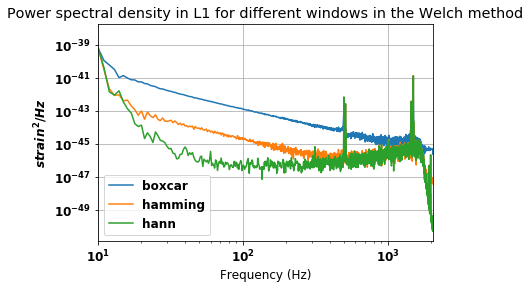

In [117]:
possible_windows=["boxcar", "hamming", "hann"]
windows=[0 for i in range(len(possible_windows))]
for i in range(len(possible_windows)):
    windows[i]=scipy.signal.get_window(possible_windows[i], 4096)
#computation of the psds for these different windows   
psds=[0 for i in range(len(possible_windows))]
for j in range(len(possible_windows)):
    psds[j]=welch(d, seg_len=4096, seg_stride=2048, window=windows[j], num_segments=8)
    plt.loglog(psds[j].sample_frequencies, psds[j], label=possible_windows[j])
plt.xlabel("Frequency (Hz)")
plt.ylabel("$strain^2/Hz$")
plt.xlim(10,2048)
plt.legend(loc="best")
plt.title("Power spectral density in L1 for different windows in the Welch method")
plt.grid()

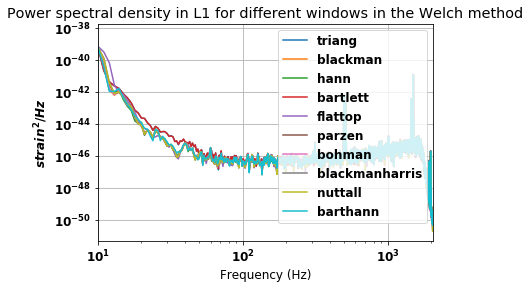

In [118]:
possible_windows=["triang", "blackman", "hann", "bartlett", "flattop", "parzen",
                  "bohman", "blackmanharris", "nuttall", "barthann"]
windows=[0 for i in range(len(possible_windows))]
for i in range(len(possible_windows)):
    windows[i]=scipy.signal.get_window(possible_windows[i], 4096)
#computation of the psds for these different windows   
psds=[0 for i in range(len(possible_windows))]
for j in range(len(possible_windows)):
    psds[j]=welch(d, seg_len=4096, seg_stride=2048, window=windows[j], num_segments=8)
    plt.loglog(psds[j].sample_frequencies, psds[j], label=possible_windows[j])
plt.xlabel("Frequency (Hz)")
plt.ylabel("$strain^2/Hz$")
plt.xlim(10,2048)
plt.legend(loc="upper right")
plt.title("Power spectral density in L1 for different windows in the Welch method")
plt.grid()

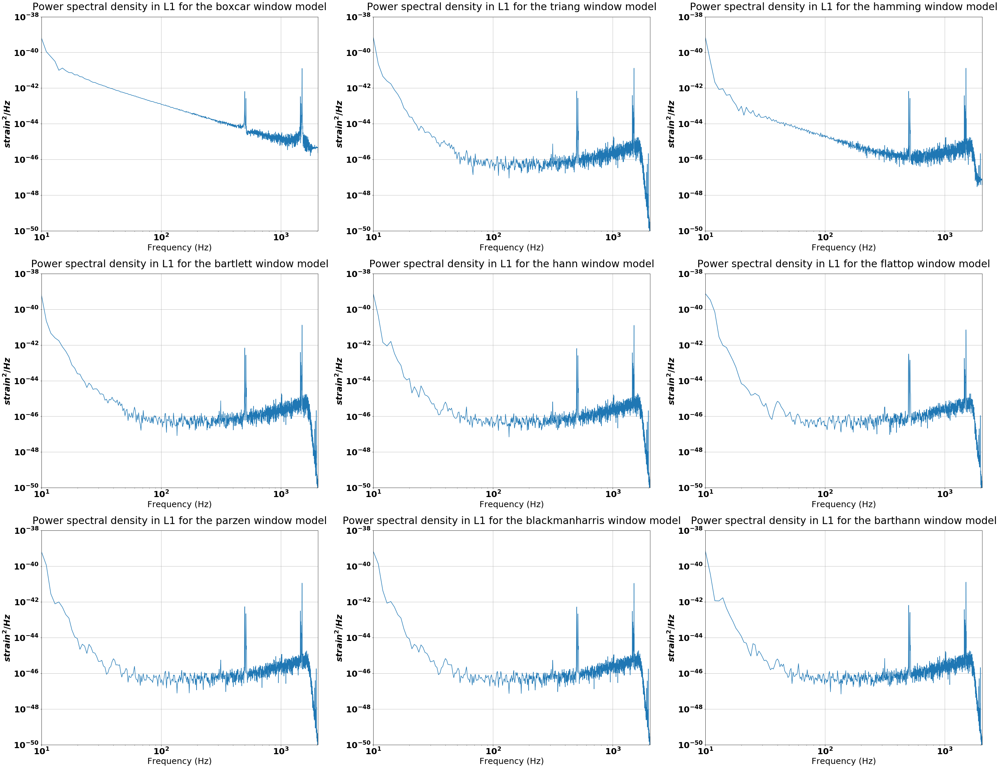

In [131]:
import matplotlib
import matplotlib.pyplot as plt
font = {'family' : 'normal',
        'weight' : 'bold',
        'size'   : 25}

matplotlib.rc('font', **font)

#download of different windows
possible_windows=["boxcar", "triang", "hamming",  "bartlett", "hann", "flattop", "parzen",
                  "blackmanharris", "barthann"]
windows=[0 for i in range(len(possible_windows))]
for i in range(len(possible_windows)):
    windows[i]=scipy.signal.get_window(possible_windows[i], 4096)
#computation of the psds for these different windows   
psds=[0 for i in range(len(possible_windows))]
for j in range(len(possible_windows)):
    psds[j]=welch(d, seg_len=4096, seg_stride=2048, window=windows[j], num_segments=8)
#figure
f=plt.figure(figsize=[50,15])
ax=f.subplots(nrows=3, ncols=3)
f.subplots_adjust(bottom=18, top=20, wspace= 0.2, hspace=0.2)
k=0
for i in range(3):
    for j in range(3):
        ax[i][j].loglog(psds[k].sample_frequencies, psds[k], label=possible_windows[k])
        ax[i][j].set_xlabel("Frequency (Hz)")
        ax[i][j].set_ylabel("$strain^2/Hz$")
        ax[i][j].set_xlim(10,2048)
        ax[i][j].set_ylim(1e-50,1e-38)
        ax[i][j].set_title("Power spectral density in L1 for the %s window model" %possible_windows[k], pad=20)
        ax[i][j].grid()
        k+=1
#plt.setp([a.get_xticklabels() for a in f.axes[:-1]], visible=True)
plt.show()

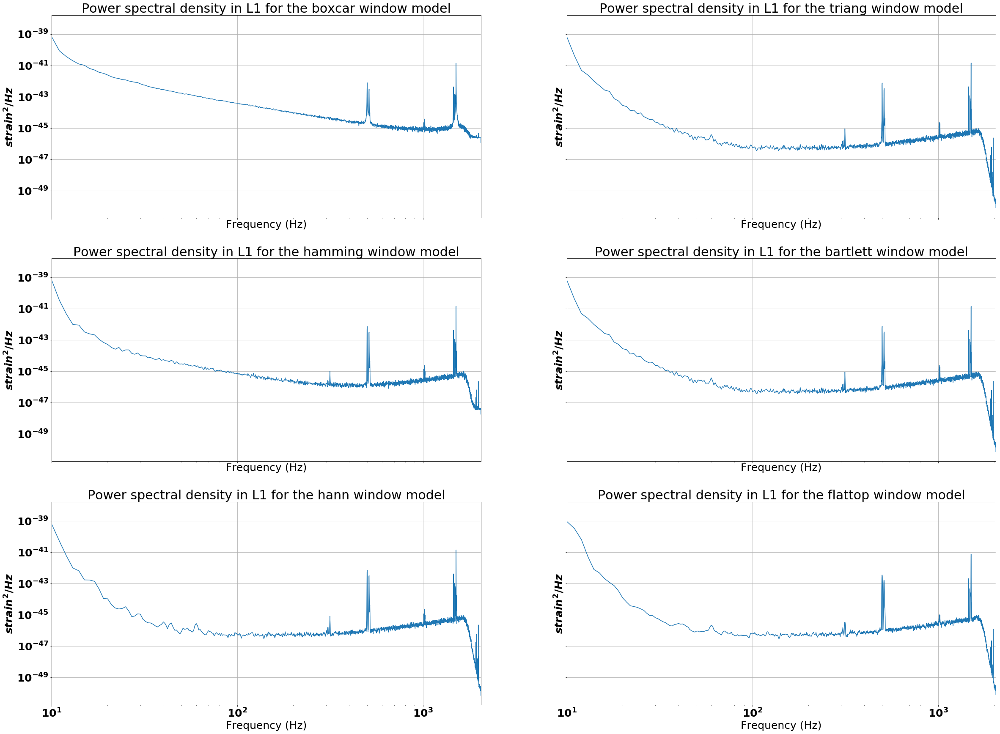

In [103]:
import matplotlib
import matplotlib.pyplot as plt
font = {'family' : 'normal',
        'weight' : 'bold',
        'size'   : 25}

matplotlib.rc('font', **font)

#download of different windows
possible_windows=["boxcar", "triang", "hamming",  "bartlett", "hann", "flattop"]
windows=[0 for i in range(len(possible_windows))]
for i in range(len(possible_windows)):
    windows[i]=scipy.signal.get_window(possible_windows[i], 4096)
#computation of the psds for these different windows   
psds=[0 for i in range(len(possible_windows))]
for j in range(len(possible_windows)):
    psds[j]=welch(d, seg_len=4096, seg_stride=2048, window=windows[j])
#figure
f=plt.figure(figsize=[40,30])
ax=f.subplots(nrows=3, ncols=2, sharex= True, sharey=True)
#f.subplots_adjust(bottom=18, top=20, wspace= 0.4, hspace=0.4)
k=0
for i in range(3):
    for j in range(2):
        ax[i][j].loglog(psds[k].sample_frequencies, psds[k], label=possible_windows[k])
        ax[i][j].set_xlabel("Frequency (Hz)")
        ax[i][j].set_ylabel("$strain^2/Hz$")
        ax[i][j].set_xlim(10,2048)
        ax[i][j].set_title("Power spectral density in L1 for the %s window model" %possible_windows[k])
        ax[i][j].grid()
        k+=1

now, based on the different windows that are calculated, we look at the influence it can have for the SNR that is found. All is compared to the Hann model which is the one that has been used in the previous cases and gives known values

In [149]:

import matplotlib
import matplotlib.pyplot as plt
font = {'family' : 'normal',
        'weight' : 'bold',
        'size'   : 12}

matplotlib.rc('font', **font)

We found a signal at 1186741855.7797852s with a SNR of 12.8888393 for the boxcar window function
We found a signal at 1186741855.7792969s with a SNR of 13.2445372 for the triang window function
We found a signal at 1186741855.7792969s with a SNR of 13.7612653 for the blackman window function
We found a signal at 1186741855.7792969s with a SNR of 13.4954802 for the hamming window function
We found a signal at 1186741855.7792969s with a SNR of 13.7663508 for the hann window function
We found a signal at 1186741855.7792969s with a SNR of 13.2461082 for the bartlett window function
We found a signal at 1186741861.5253906s with a SNR of 13.4241599 for the flattop window function
We found a signal at 1186741855.7788086s with a SNR of 13.4826875 for the parzen window function
We found a signal at 1186741855.7792969s with a SNR of 13.7049580 for the bohman window function
We found a signal at 1186741855.7788086s with a SNR of 13.4154311 for the blackmanharris window function
We found a signal 

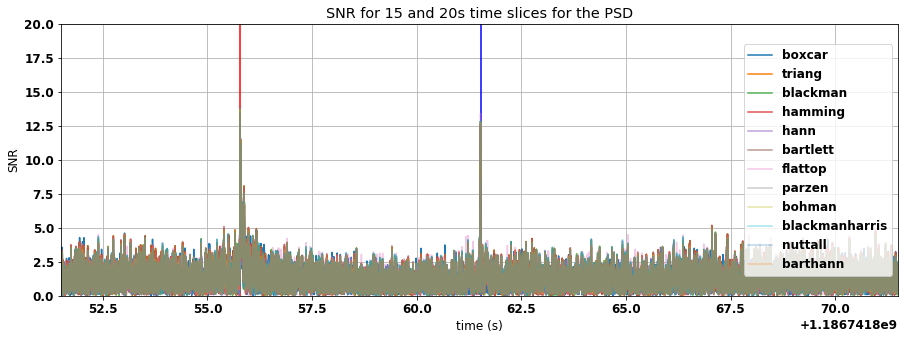

In [153]:
from pycbc.psd import interpolate, inverse_spectrum_truncation
ts=m.strain("L1").highpass_fir(15,512)
d=resample_to_delta_t(ts, 1.0/2048).crop(2,2)

possible_windows=["boxcar", "triang", "blackman", "hamming", "hann", "bartlett", "flattop", "parzen",
                  "bohman", "blackmanharris", "nuttall", "barthann"]
windows=[0 for i in range(len(possible_windows))]
for i in range(len(possible_windows)):
    windows[i]=scipy.signal.get_window(possible_windows[i], 4096)
#computation of the psds for these different windows   
psds=[0 for i in range(len(possible_windows))]
for j in range(len(possible_windows)):
    p=welch(d, seg_len=4096, seg_stride=2048, window=windows[j], num_segments=8)
    p=interpolate(p, d.delta_f)
    p=inverse_spectrum_truncation(p, 2 * d.sample_rate, low_frequency_cutoff=15.0)
    psds[j]=p

cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
peaks=[0 for i in range(len(possible_windows))]
snrp=[0 for i in range(len(possible_windows))]
times=[0 for i in range(len(possible_windows))]
alphas=[1,1,0.8,0.8,0.6,0.6,0.4,0.4,0.4,0.4,0.3,0.3]
plt.figure(figsize=[15,5])
for j in range(len(possible_windows)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=d.delta_f)
    hp.resize(len(psds[j]))
    snr=matched_filter(hp, d, psd=psds[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=possible_windows[j], alpha=alphas[j])
    snrs.append(snr)
    peaks[j]=abs(snr).numpy().argmax()
    snrp[j]=snr[peaks[j]]
    times[j]=snr.sample_times[peaks[j]]
    print("We found a signal at %.7fs with a SNR of %.7f for the %s window function" 
          %(times[j], abs(snrp[j]), possible_windows[j]))
plt.legend(loc="right")
plt.title("SNR for 15 and 20s time slices for the PSD")
plt.grid()
plt.xlim(m.time-10, m.time+10)
plt.ylim(0,20)
plt.xlabel("time (s)")
plt.ylabel("SNR") 
plt.vlines(1186741855.7797852, 0, 20, colors='red')
plt.vlines(1186741861.5253906, 0, 20, colors='blue')

When doing the computation without cleaning of the data, only thz flattop model gives directly the highest peaks as being the one corresponding to the event and not another, with a SNR of 13.4. Maybe it is able to discriminate better the glitches from the rest. This could be tested in order to se what happens. It can be done by looking at the reaction ofthe filter in different situations, where glitches are intriduced in the neighborhood of a gravitational wave signal (which can be simulated). However, we can still zoom on the peaks around the time of the event in order to see their high relationshipt. After that, it is possible to look at the data once it has been cleande by the chi square test in order to see which filter works the best

We found a signal at 1186741855.7797852s with a SNR of 12.8888393 for the boxcar window function
We found a signal at 1186741855.7792969s with a SNR of 13.2445372 for the triang window function
We found a signal at 1186741855.7792969s with a SNR of 13.7612653 for the blackman window function
We found a signal at 1186741855.7792969s with a SNR of 13.4954802 for the hamming window function
We found a signal at 1186741855.7792969s with a SNR of 13.7663508 for the hann window function
We found a signal at 1186741855.7792969s with a SNR of 13.2461082 for the bartlett window function
We found a signal at 1186741861.5253906s with a SNR of 13.4241599 for the flattop window function
We found a signal at 1186741855.7788086s with a SNR of 13.4826875 for the parzen window function
We found a signal at 1186741855.7792969s with a SNR of 13.7049580 for the bohman window function
We found a signal at 1186741855.7788086s with a SNR of 13.4154311 for the blackmanharris window function
We found a signal 

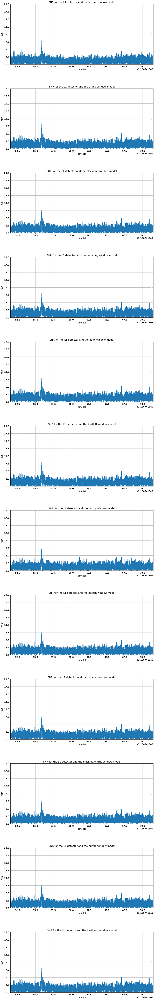

In [160]:
#representation for the different models independently
from pycbc.psd import interpolate, inverse_spectrum_truncation
ts=m.strain("L1").highpass_fir(15,512)
d=resample_to_delta_t(ts, 1.0/2048).crop(2,2)

possible_windows=["boxcar", "triang", "blackman", "hamming", "hann", "bartlett", "flattop", "parzen",
                  "bohman", "blackmanharris", "nuttall", "barthann"]
windows=[0 for i in range(len(possible_windows))]
for i in range(len(possible_windows)):
    windows[i]=scipy.signal.get_window(possible_windows[i], 4096)
#computation of the psds for these different windows   
psds=[0 for i in range(len(possible_windows))]
for j in range(len(possible_windows)):
    p=welch(d, seg_len=4096, seg_stride=2048, window=windows[j], num_segments=8)
    p=interpolate(p, d.delta_f)
    p=inverse_spectrum_truncation(p, 2 * d.sample_rate, low_frequency_cutoff=15.0)
    psds[j]=p

cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
peaks=[0 for i in range(len(possible_windows))]
snrp=[0 for i in range(len(possible_windows))]
times=[0 for i in range(len(possible_windows))]
alphas=[1,1,0.8,0.8,0.6,0.6,0.4,0.4,0.4,0.4,0.3,0.3]
f=plt.figure(figsize=[15,40])
ax=f.subplots(nrows=len(possible_windows))
f.subplots_adjust(bottom=18, top=20, wspace= 0.4, hspace=0.4)
for j in range(len(possible_windows)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=d.delta_f)
    hp.resize(len(psds[j]))
    snr=matched_filter(hp, d, psd=psds[j], low_frequency_cutoff=20.)
    ax[j].plot(snr.sample_times, abs(snr))
    snrs.append(snr)
    peaks[j]=abs(snr).numpy().argmax()
    snrp[j]=snr[peaks[j]]
    times[j]=snr.sample_times[peaks[j]]
    print("We found a signal at %.7fs with a SNR of %.7f for the %s window function" 
          %(times[j], abs(snrp[j]), possible_windows[j]))
    ax[j].legend(loc="right")
    ax[j].set_title("SNR for the L1 detector and the %s window model" %(possible_windows[j]))
    ax[j].grid()
    ax[j].set_xlim(m.time-10, m.time+10)
    ax[j].set_ylim(0,20)
    ax[j].set_xlabel("time (s)")
    ax[j].set_ylabel("SNR") 

Text(0,0.5,'SNR')

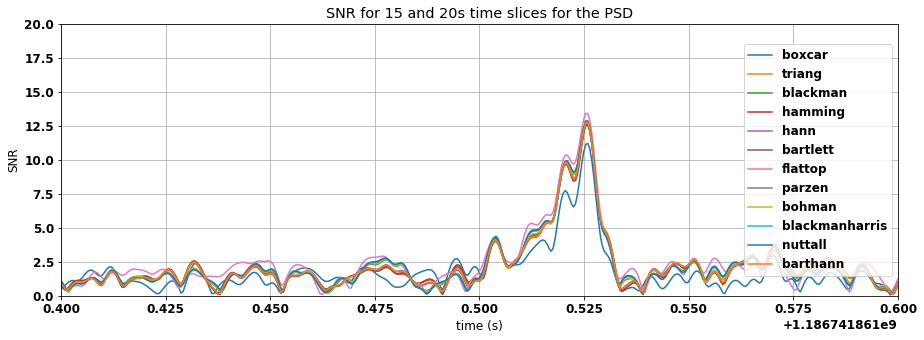

In [162]:
#zoom on the time of the event
ts=m.strain("L1").highpass_fir(15,512)
d=resample_to_delta_t(ts, 1.0/2048).crop(2,2)

possible_windows=["boxcar", "triang", "blackman", "hamming", "hann", "bartlett", "flattop", "parzen",
                  "bohman", "blackmanharris", "nuttall", "barthann"]
windows=[0 for i in range(len(possible_windows))]
for i in range(len(possible_windows)):
    windows[i]=scipy.signal.get_window(possible_windows[i], 4096)
#computation of the psds for these different windows   
psds=[0 for i in range(len(possible_windows))]
for j in range(len(possible_windows)):
    p=welch(d, seg_len=4096, seg_stride=2048, window=windows[j], num_segments=8)
    p=interpolate(p, d.delta_f)
    p=inverse_spectrum_truncation(p, 2 * d.sample_rate, low_frequency_cutoff=15.0)
    psds[j]=p

cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
peaks=[0 for i in range(len(possible_windows))]
snrp=[0 for i in range(len(possible_windows))]
times=[0 for i in range(len(possible_windows))]
plt.figure(figsize=[15,5])
for j in range(len(possible_windows)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=d.delta_f)
    hp.resize(len(psds[j]))
    snr=matched_filter(hp, d, psd=psds[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=possible_windows[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR for 15 and 20s time slices for the PSD")
plt.grid()
plt.xlim(m.time-10, m.time+10)
plt.ylim(0,20)
plt.xlim(m.time-0.1, m.time+0.1)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Text(0,0.5,'SNR')

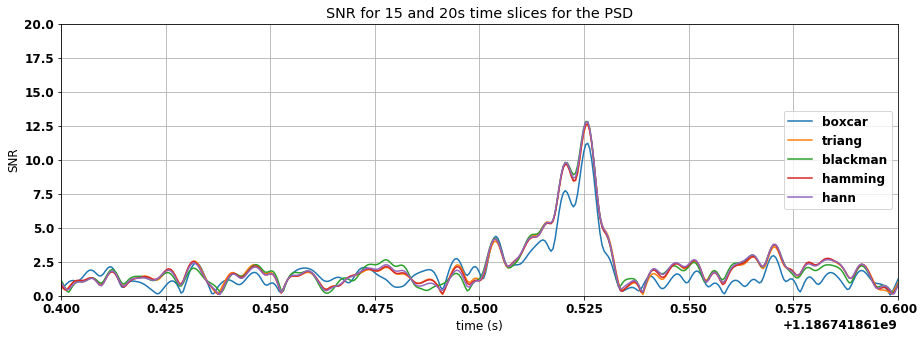

In [164]:
#zoom on the time of the event with only some windows in order to try to find which gives the highest value
ts=m.strain("L1").highpass_fir(15,512)
d=resample_to_delta_t(ts, 1.0/2048).crop(2,2)

possible_windows=["boxcar", "triang", "blackman", "hamming", "hann"]
windows=[0 for i in range(len(possible_windows))]
for i in range(len(possible_windows)):
    windows[i]=scipy.signal.get_window(possible_windows[i], 4096)
#computation of the psds for these different windows   
psds=[0 for i in range(len(possible_windows))]
for j in range(len(possible_windows)):
    p=welch(d, seg_len=4096, seg_stride=2048, window=windows[j], num_segments=8)
    p=interpolate(p, d.delta_f)
    p=inverse_spectrum_truncation(p, 2 * d.sample_rate, low_frequency_cutoff=15.0)
    psds[j]=p

cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
peaks=[0 for i in range(len(possible_windows))]
snrp=[0 for i in range(len(possible_windows))]
times=[0 for i in range(len(possible_windows))]
plt.figure(figsize=[15,5])
for j in range(len(possible_windows)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=d.delta_f)
    hp.resize(len(psds[j]))
    snr=matched_filter(hp, d, psd=psds[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=possible_windows[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR for 15 and 20s time slices for the PSD")
plt.grid()
plt.xlim(m.time-10, m.time+10)
plt.ylim(0,20)
plt.xlim(m.time-0.1, m.time+0.1)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Hann is evidently higher thab the boxcar which is the lowest of all in any case

Text(0,0.5,'SNR')

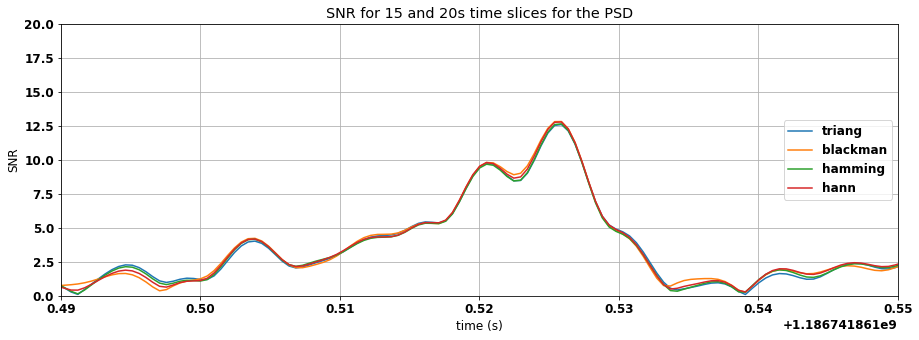

In [166]:
#zoom on the time of the event
ts=m.strain("L1").highpass_fir(15,512)
d=resample_to_delta_t(ts, 1.0/2048).crop(2,2)

possible_windows=["triang", "blackman", "hamming", "hann"]
windows=[0 for i in range(len(possible_windows))]
for i in range(len(possible_windows)):
    windows[i]=scipy.signal.get_window(possible_windows[i], 4096)
#computation of the psds for these different windows   
psds=[0 for i in range(len(possible_windows))]
for j in range(len(possible_windows)):
    p=welch(d, seg_len=4096, seg_stride=2048, window=windows[j], num_segments=8)
    p=interpolate(p, d.delta_f)
    p=inverse_spectrum_truncation(p, 2 * d.sample_rate, low_frequency_cutoff=15.0)
    psds[j]=p

cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
peaks=[0 for i in range(len(possible_windows))]
snrp=[0 for i in range(len(possible_windows))]
times=[0 for i in range(len(possible_windows))]
plt.figure(figsize=[15,5])
for j in range(len(possible_windows)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=d.delta_f)
    hp.resize(len(psds[j]))
    snr=matched_filter(hp, d, psd=psds[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=possible_windows[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR for 15 and 20s time slices for the PSD")
plt.grid()
plt.xlim(m.time-10, m.time+10)
plt.ylim(0,20)
plt.xlim(m.time-0.01, m.time+0.05)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Hamming also is lower. We keep only the three other to see but I think that the result will be approximatively the same

Text(0,0.5,'SNR')

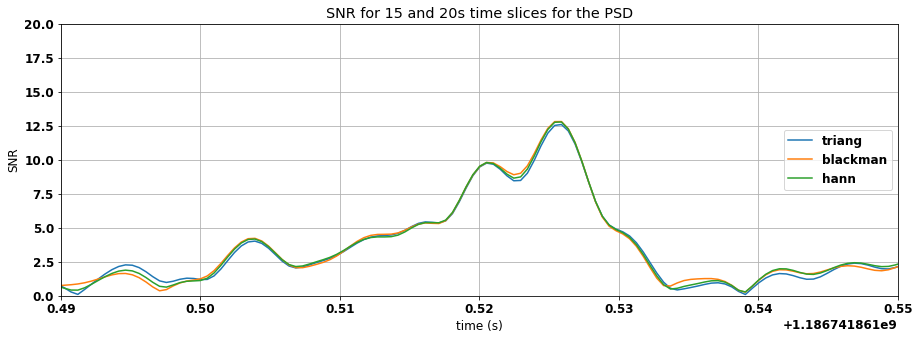

In [167]:
#zoom on the time of the event
ts=m.strain("L1").highpass_fir(15,512)
d=resample_to_delta_t(ts, 1.0/2048).crop(2,2)

possible_windows=["triang", "blackman", "hann"]
windows=[0 for i in range(len(possible_windows))]
for i in range(len(possible_windows)):
    windows[i]=scipy.signal.get_window(possible_windows[i], 4096)
#computation of the psds for these different windows   
psds=[0 for i in range(len(possible_windows))]
for j in range(len(possible_windows)):
    p=welch(d, seg_len=4096, seg_stride=2048, window=windows[j], num_segments=8)
    p=interpolate(p, d.delta_f)
    p=inverse_spectrum_truncation(p, 2 * d.sample_rate, low_frequency_cutoff=15.0)
    psds[j]=p

cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
peaks=[0 for i in range(len(possible_windows))]
snrp=[0 for i in range(len(possible_windows))]
times=[0 for i in range(len(possible_windows))]
plt.figure(figsize=[15,5])
for j in range(len(possible_windows)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=d.delta_f)
    hp.resize(len(psds[j]))
    snr=matched_filter(hp, d, psd=psds[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=possible_windows[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR for 15 and 20s time slices for the PSD")
plt.grid()
plt.xlim(m.time-10, m.time+10)
plt.ylim(0,20)
plt.xlim(m.time-0.01, m.time+0.05)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Hann and blackman give the same SNR, which is a bit higher than the triang case. However, the difference is not that important.

Now we test for the other cases

Text(0,0.5,'SNR')

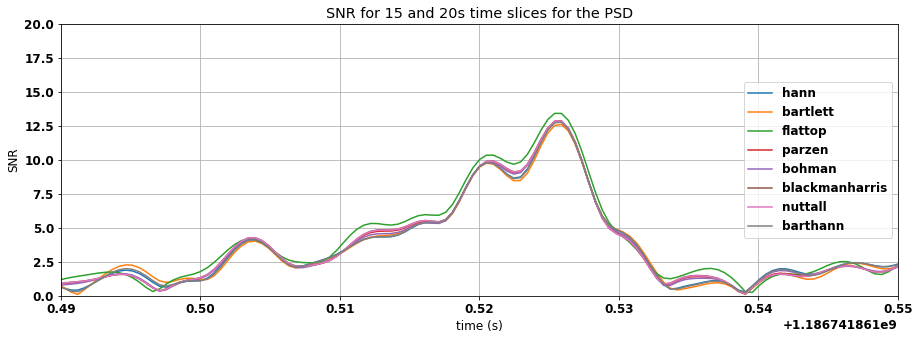

In [168]:
#zoom on the time of the event
ts=m.strain("L1").highpass_fir(15,512)
d=resample_to_delta_t(ts, 1.0/2048).crop(2,2)

possible_windows=["hann", "bartlett", "flattop", "parzen", "bohman", "blackmanharris", "nuttall", "barthann"]
windows=[0 for i in range(len(possible_windows))]
for i in range(len(possible_windows)):
    windows[i]=scipy.signal.get_window(possible_windows[i], 4096)
#computation of the psds for these different windows   
psds=[0 for i in range(len(possible_windows))]
for j in range(len(possible_windows)):
    p=welch(d, seg_len=4096, seg_stride=2048, window=windows[j], num_segments=8)
    p=interpolate(p, d.delta_f)
    p=inverse_spectrum_truncation(p, 2 * d.sample_rate, low_frequency_cutoff=15.0)
    psds[j]=p

cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
peaks=[0 for i in range(len(possible_windows))]
snrp=[0 for i in range(len(possible_windows))]
times=[0 for i in range(len(possible_windows))]
plt.figure(figsize=[15,5])
for j in range(len(possible_windows)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=d.delta_f)
    hp.resize(len(psds[j]))
    snr=matched_filter(hp, d, psd=psds[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=possible_windows[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR for 15 and 20s time slices for the PSD")
plt.grid()
plt.xlim(m.time-10, m.time+10)
plt.ylim(0,20)
plt.xlim(m.time-0.01, m.time+0.05)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

Flattop is clearly higher than all the other. Barlett is a bit below. We zoom on the other to see what happens

Text(0,0.5,'SNR')

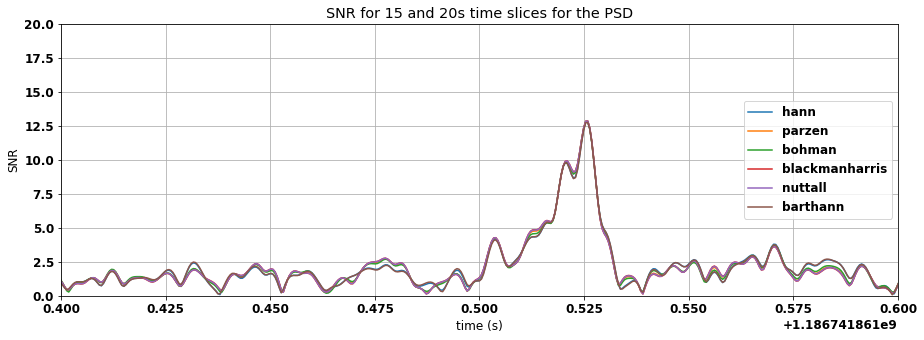

In [175]:
#zoom on the time of the event
ts=m.strain("L1").highpass_fir(15,512)
d=resample_to_delta_t(ts, 1.0/2048).crop(2,2)

possible_windows=["hann", "parzen","bohman", "blackmanharris", "nuttall", "barthann"]
windows=[0 for i in range(len(possible_windows))]
for i in range(len(possible_windows)):
    windows[i]=scipy.signal.get_window(possible_windows[i], 4096)
#computation of the psds for these different windows   
psds=[0 for i in range(len(possible_windows))]
for j in range(len(possible_windows)):
    p=welch(d, seg_len=4096, seg_stride=2048, window=windows[j], num_segments=8)
    p=interpolate(p, d.delta_f)
    p=inverse_spectrum_truncation(p, 2 * d.sample_rate, low_frequency_cutoff=15.0)
    psds[j]=p

cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
peaks=[0 for i in range(len(possible_windows))]
snrp=[0 for i in range(len(possible_windows))]
times=[0 for i in range(len(possible_windows))]
plt.figure(figsize=[15,5])
for j in range(len(possible_windows)):
    hp, _ = get_fd_waveform(approximant="IMRPhenomD", mass1=cmass, mass2=cmass, f_lower=20., delta_f=d.delta_f)
    hp.resize(len(psds[j]))
    snr=matched_filter(hp, d, psd=psds[j], low_frequency_cutoff=20.)
    plt.plot(snr.sample_times, abs(snr), label=possible_windows[j])
    snrs.append(snr)
plt.legend(loc="right")
plt.title("SNR for 15 and 20s time slices for the PSD")
plt.grid()
plt.xlim(m.time-10, m.time+10)
plt.ylim(0,20)
plt.xlim(m.time-0.1, m.time+0.1)
plt.xlabel("time (s)")
plt.ylabel("SNR") 

The diference between hann, parzen, bohman, blackmanharris, nutall and barthann is not significant enough to distinguish them so far. Therefore, they give the same SNR

Now, we do the chi-square test and clean the data in order to see if the peaks can now be found and if the glitch is taken out of the data

Text(0.5,1,'Normalized chi square statistic')

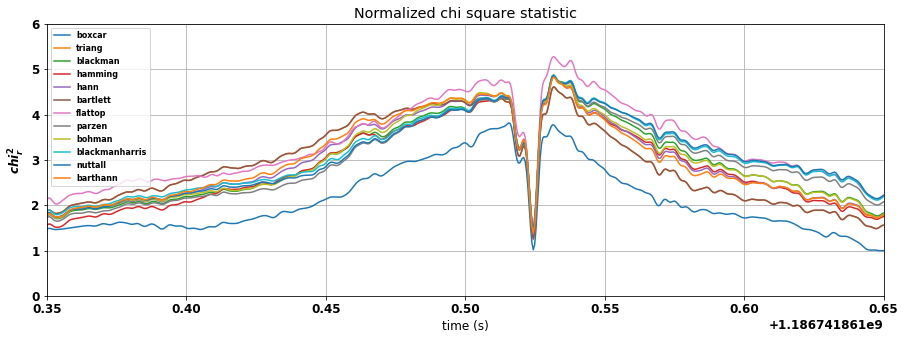

In [208]:
from pycbc.vetoes import power_chisq

ts=m.strain("L1").highpass_fir(15,512)
d=resample_to_delta_t(ts, 1.0/2048).crop(2,2)

possible_windows=["boxcar", "triang", "blackman", "hamming", "hann", "bartlett", "flattop", "parzen",
                  "bohman", "blackmanharris", "nuttall", "barthann"]

windows=[0 for i in range(len(possible_windows))]
         
for i in range(len(possible_windows)):
    windows[i]=scipy.signal.get_window(possible_windows[i], 4096)
#computation of the psds for these different windows   
psds=[0 for i in range(len(possible_windows))]
for j in range(len(possible_windows)):
    p=welch(d, seg_len=4096, seg_stride=2048, window=windows[j], num_segments=8)
    p=interpolate(p, d.delta_f)
    p=inverse_spectrum_truncation(p, 2 * d.sample_rate, low_frequency_cutoff=15.0)
    psds[j]=p

cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
for j in range(len(possible_windows)):
    hp, hf = get_fd_waveform(approximant="IMRPhenomD",
                         mass1=30.5, mass2=25.3, spin1z=-0.56879753, spin2z=0.13079314, distance=540, inclination=0.6,
                         f_lower=20.0, delta_f=d.delta_f, f_final=739.0645)
    hp.resize(len(psds[j]))
    snr=matched_filter(hp, d, psd=psds[j], low_frequency_cutoff=20.)
    snrs.append(snr)

chi=[0 for i in range(len(possible_windows))]
for i in range(len(possible_windows)):
    p=26
    chi[i]=power_chisq(hp,d, p, psds[i], low_frequency_cutoff=20.0)
    chi[i]=chi[i].crop(5,4)
    dof=p*2-2
    chi[i]/=dof #normalization of the statistic

plt.figure(figsize=(15,5))
for i in range(len(possible_windows)):
    plt.plot(chi[i].sample_times, chi[i], label=possible_windows[i])
plt.legend(loc="best", prop={'size': 8})
plt.grid()
plt.xlim(m.time-0.15, m.time+0.15)
plt.ylim(0,6)
plt.ylabel('$chi^2_r$')
plt.xlabel('time (s)')
plt.title("Normalized chi square statistic")

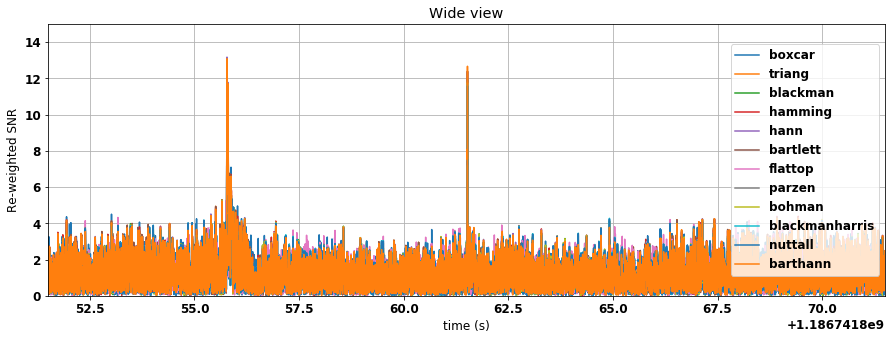

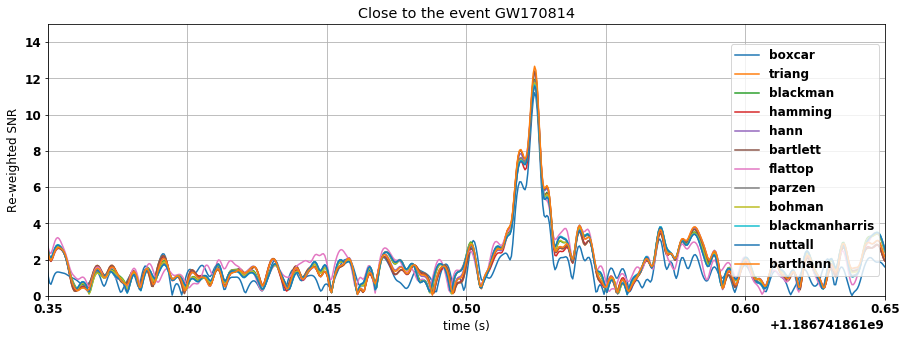

In [210]:
from pycbc.events.ranking import newsnr
#newsnr correponds to the rho hat defined above and can thus be foud directly here with a build in function
nsnr = [newsnr(abs(snrs[i]), chi[i]) for i in range(len(possible_windows))]

#we represnt the new SNR time series
for w, title in [(10, "Wide view"), (0.15, "Close to the event GW170814")]:
    plt.figure(figsize=(15,5))
    for i in range(len(possible_windows)):
        plt.plot(snrs[i].sample_times,  nsnr[i], label=possible_windows[i])
    plt.legend(loc="right")
    plt.title(title)
    plt.grid()
    plt.xlim(m.time-w, m.time+w)
    plt.ylim(0,15)
    plt.xlabel("time (s)")
    plt.ylabel("Re-weighted SNR")

We found a signal at 1186741855.7788086s with a SNR of 12.4553443 for the boxcar window function
We found a signal at 1186741855.7783203s with a SNR of 12.7501174 for the triang window function
We found a signal at 1186741855.7783203s with a SNR of 12.8887090 for the blackman window function
We found a signal at 1186741855.7783203s with a SNR of 12.9835108 for the hamming window function
We found a signal at 1186741855.7783203s with a SNR of 13.1723563 for the hann window function
We found a signal at 1186741855.7783203s with a SNR of 12.7512300 for the bartlett window function
We found a signal at 1186741855.7783203s with a SNR of 11.7528371 for the flattop window function
We found a signal at 1186741855.7783203s with a SNR of 12.5497453 for the parzen window function
We found a signal at 1186741855.7783203s with a SNR of 12.8170529 for the bohman window function
We found a signal at 1186741855.7783203s with a SNR of 12.4616414 for the blackmanharris window function
We found a signal 

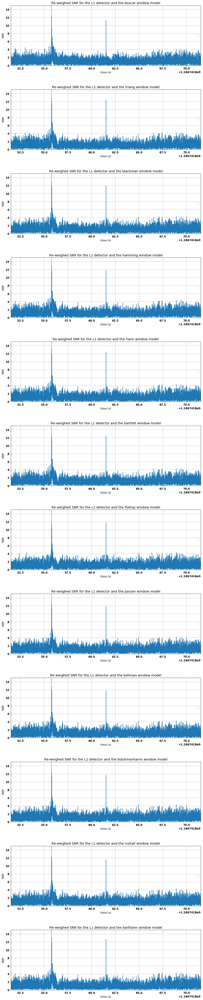

In [218]:
f=plt.figure(figsize=[15,30])
ax=f.subplots(nrows=len(possible_windows))
f.subplots_adjust(bottom=18, top=20, wspace= 0.4, hspace=0.4)
peaks=[0 for i in range(len(possible_windows))]
snrp=[0 for i in range(len(possible_windows))]
times=[0 for i in range(len(possible_windows))]
#x=[1186741855.7788086, 1186741861.5244141]
colors=['red', 'green', 'blue', 'orange', 'purple', 'black', 'brown', 'pink']
for j in range(len(possible_windows)):
    snr=nsnr[j]
    ax[j].plot(snrs[j].sample_times,  snr)
    peaks[j]=abs(snr).argmax()
    snrp[j]=snr[peaks[j]]
    times[j]=snrs[j].sample_times[peaks[j]]
    print("We found a signal at %.7fs with a SNR of %.7f for the %s window function" 
          %(times[j], abs(snrp[j]), possible_windows[j]))
    ax[j].legend(loc="right")
    ax[j].set_title("Re-weighed SNR for the L1 detector and the %s window model" %(possible_windows[j]))
    ax[j].grid()
    ax[j].set_xlim(m.time-10, m.time+10)
    ax[j].set_ylim(0,15)
    ax[j].set_xlabel("time (s)")
    ax[j].set_ylabel("SNR")
    ax[j].axvline(times[j], color='red', alpha=0.7)
    

I have the impression that nothing has changed after the filtering. So, I will try for the Hann model alone and see what happens. If it is possible, I will generalize for the others after

Text(0.5,1,'Normalized chi square statistic')

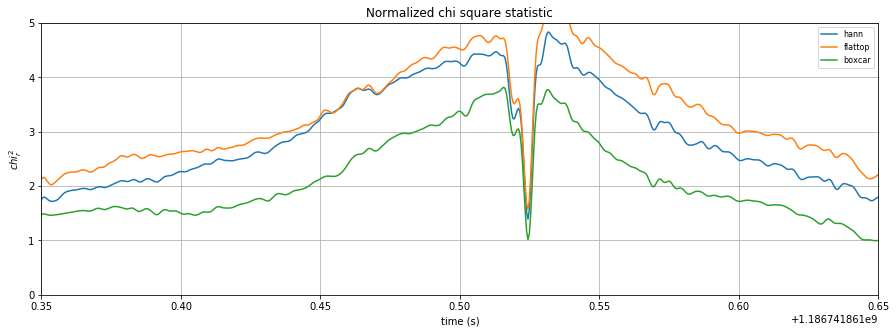

In [8]:
%matplotlib inline
import matplotlib.pyplot as plt
from pycbc.filter import resample_to_delta_t, highpass
from pycbc.catalog import Merger
from pycbc.psd import interpolate, inverse_spectrum_truncation
from pycbc.waveform import get_td_waveform, get_fd_waveform
from pycbc.filter import matched_filter
from pycbc.psd import interpolate, inverse_spectrum_truncation
import scipy
from pycbc.events.ranking import newsnr
from pycbc.vetoes import power_chisq
from pycbc.psd.estimate import welch

m=Merger("GW170814")

ts=m.strain("L1").highpass_fir(15,512)
d=resample_to_delta_t(ts, 1.0/2048).crop(2,2)

possible_windows=["hann", "flattop", "boxcar" ]

windows=[0 for i in range(len(possible_windows))]
         
for i in range(len(possible_windows)):
    windows[i]=scipy.signal.get_window(possible_windows[i], 4096)
#computation of the psds for these different windows   
psds=[0 for i in range(len(possible_windows))]
for j in range(len(possible_windows)):
    p=welch(d, seg_len=4096, seg_stride=2048, window=windows[j], num_segments=8)
    p=interpolate(p, d.delta_f)
    p=inverse_spectrum_truncation(p, 2 * d.sample_rate, low_frequency_cutoff=15.0)
    psds[j]=p

cmass = (m.median1d("mass1") + m.median1d("mass2")) / 2.0  # This is in the source frame
cmass *= (1 + m.median1d("redshift")) # apply redshift to get to the detector frame
snrs=[]
for j in range(len(possible_windows)):
    hp, hf = get_fd_waveform(approximant="IMRPhenomD",
                         mass1=30.5, mass2=25.3, spin1z=-0.56879753, spin2z=0.13079314, distance=540, inclination=0.6,
                         f_lower=20.0, delta_f=d.delta_f, f_final=739.0645)
    hp.resize(len(psds[j]))
    snr=matched_filter(hp, d, psd=psds[j], low_frequency_cutoff=20.)
    snrs.append(snr)

chi=[0 for i in range(len(possible_windows))]
for i in range(len(possible_windows)):
    p=26
    chi[i]=power_chisq(hp,d, p, psds[i], low_frequency_cutoff=20.0)
    chi[i]=chi[i].crop(5,4)
    dof=p*2-2
    chi[i]/=dof #normalization of the statistic

plt.figure(figsize=(15,5))
for i in range(len(possible_windows)):
    plt.plot(chi[i].sample_times, chi[i], label=possible_windows[i])
plt.legend(loc="best", prop={'size': 8})
plt.grid()
plt.xlim(m.time-0.15, m.time+0.15)
plt.ylim(0,5)
plt.ylabel('$chi^2_r$')
plt.xlabel('time (s)')
plt.title("Normalized chi square statistic")

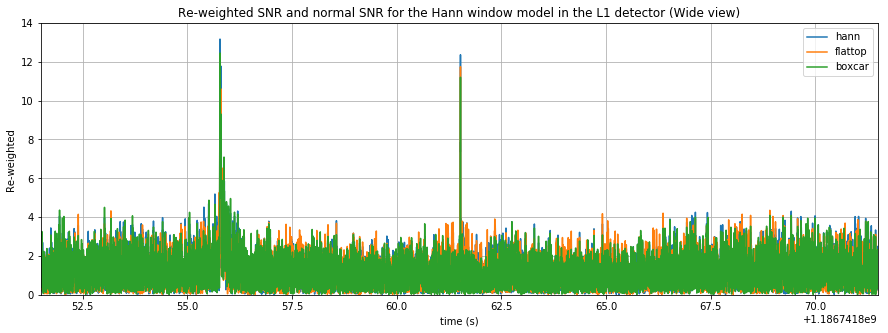

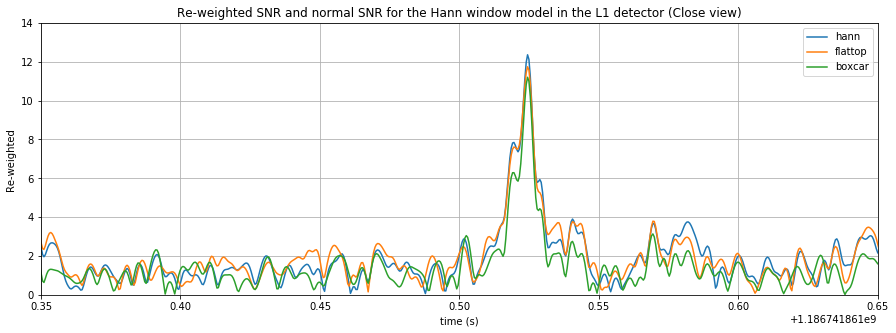

In [10]:
nsnr = [newsnr(abs(snrs[i]), chi[i]) for i in range(len(possible_windows))]
alphas=[1,1,1]
#we represnt the new SNR time series
for w, title in [(10, "Re-weighted SNR and normal SNR for the Hann window model in the L1 detector (Wide view)"),
                 (0.15, "Re-weighted SNR and normal SNR for the Hann window model in the L1 detector (Close view)")]:
    plt.figure(figsize=(15,5))
    for i in range(len(possible_windows)):
        plt.plot(snrs[i].sample_times,  nsnr[i], label=possible_windows[i], alpha=alphas[i])
    plt.legend(loc="best")
    plt.title(title)
    plt.grid()
    plt.xlim(m.time-w, m.time+w)
    plt.ylim(0,14)
    plt.xlabel("time (s)")
    plt.ylabel("Re-weighted ")

[1, 5, 10, 15, 20, 25]


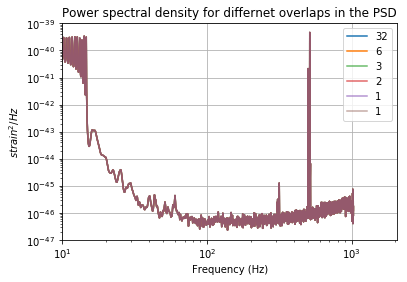

In [35]:
%matplotlib inline
import matplotlib.pyplot as plt
from pycbc.filter import resample_to_delta_t, highpass
from pycbc.catalog import Merger
from pycbc.psd import interpolate, inverse_spectrum_truncation
from pycbc.waveform import get_td_waveform, get_fd_waveform
from pycbc.filter import matched_filter
from pycbc.psd import interpolate, inverse_spectrum_truncation
import scipy
from pycbc.events.ranking import newsnr
from pycbc.vetoes import power_chisq
from pycbc.psd.estimate import welch

num_segments=[1,5,10,15,20,25]
print(num_segments)
m=Merger("GW170814")

ts=m.strain("L1").highpass_fir(15,512)
d=resample_to_delta_t(ts, 1.0/2048).crop(2,2)
alphas=[1,1,0.7,0.7,0.7,0.5,0.5,0.4,0.4]
psds=[0 for i in range(len(num_segments))]
for j in range(len(num_segments)):
    p=welch(d, seg_len=4096, seg_stride=2048, num_segments=num_segments[i])
    p=interpolate(p, d.delta_f)
    p=inverse_spectrum_truncation(p, 2 * d.sample_rate, low_frequency_cutoff=15.0)
    psds[j]=p
    

for i in range(len(num_segments)):
    plt.loglog(psds[i].sample_frequencies, psds[i], alpha=alphas[i], label=int(32/num_segments[i]))
plt.xlabel("Frequency (Hz)")
plt.ylabel("$strain^2/Hz$")
plt.xlim(10,2048)
plt.legend(loc="best")
plt.title("Power spectral density for differnet overlaps in the PSD")
plt.grid()


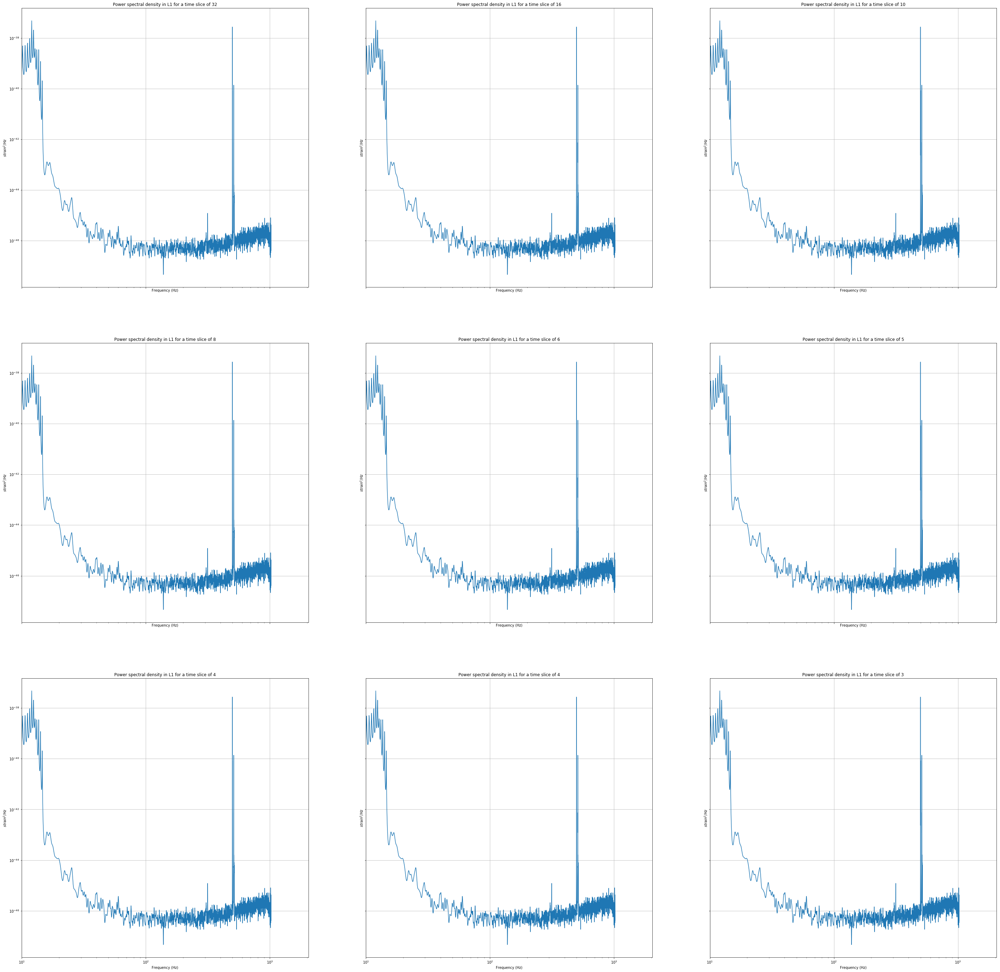

In [24]:
num_segments=[i+1 for i in range(9)]
m=Merger("GW170814")

ts=m.strain("L1").highpass_fir(15,512)
d=resample_to_delta_t(ts, 1.0/2048).crop(2,2)
alphas=[1,1,0.7,0.7,0.7,0.5,0.5,0.4,0.4]
psds=[0 for i in range(len(num_segments))]
for j in range(len(num_segments)):
    p=welch(d, seg_len=4096, seg_stride=2048, num_segments=num_segments[i])
    p=interpolate(p, d.delta_f)
    p=inverse_spectrum_truncation(p, 2 * d.sample_rate, low_frequency_cutoff=15.0)
    psds[j]=p

f=plt.figure(figsize=[50,50])
ax=f.subplots(nrows=3, ncols=3, sharex= True, sharey=True)
k=0
for i in range(3):
    for j in range(3):
        ax[i][j].loglog(psds[k].sample_frequencies, psds[k], label=int(32/num_segments[k]))
        ax[i][j].set_xlabel("Frequency (Hz)")
        ax[i][j].set_ylabel("$strain^2/Hz$")
        ax[i][j].set_xlim(10,2048)
        ax[i][j].set_title("Power spectral density in L1 for a time slice of %i" %int(32/num_segments[k]))
        ax[i][j].grid()
        k+=1


There seems to be no difference whe we change the number of slices used. So, no comment is made about it in the thesis. However, a deeper analysis could lead to a difference.